# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [15]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [16]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [17]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [18]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

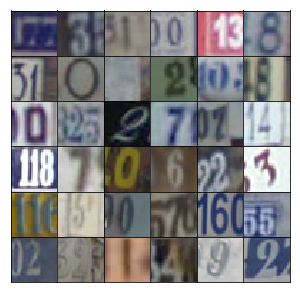

In [19]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [20]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [21]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [22]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [23]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [24]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [25]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [26]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [27]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [28]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [29]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [30]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2539... Generator Loss: 0.7039
Epoch 1/25... Discriminator Loss: 0.8218... Generator Loss: 0.8184
Epoch 1/25... Discriminator Loss: 0.1196... Generator Loss: 3.5289
Epoch 1/25... Discriminator Loss: 0.1701... Generator Loss: 2.8472
Epoch 1/25... Discriminator Loss: 0.2461... Generator Loss: 2.2003
Epoch 1/25... Discriminator Loss: 0.1742... Generator Loss: 2.7410
Epoch 1/25... Discriminator Loss: 0.1222... Generator Loss: 3.2442
Epoch 1/25... Discriminator Loss: 0.1163... Generator Loss: 3.3655
Epoch 1/25... Discriminator Loss: 0.3125... Generator Loss: 2.9012
Epoch 1/25... Discriminator Loss: 0.9923... Generator Loss: 2.2091


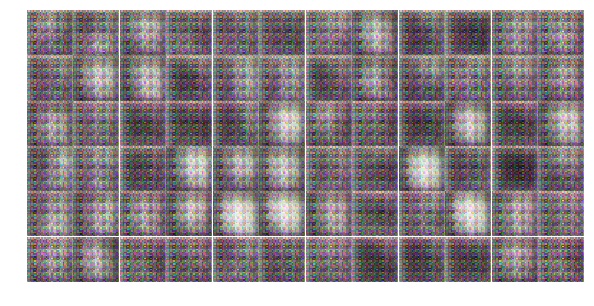

Epoch 1/25... Discriminator Loss: 0.7643... Generator Loss: 1.7098
Epoch 1/25... Discriminator Loss: 0.7040... Generator Loss: 2.0748
Epoch 1/25... Discriminator Loss: 0.5795... Generator Loss: 1.0838
Epoch 1/25... Discriminator Loss: 0.3690... Generator Loss: 2.2820
Epoch 1/25... Discriminator Loss: 0.6155... Generator Loss: 1.3513
Epoch 1/25... Discriminator Loss: 0.8618... Generator Loss: 0.9919
Epoch 1/25... Discriminator Loss: 0.3524... Generator Loss: 1.7632
Epoch 1/25... Discriminator Loss: 0.2773... Generator Loss: 3.1777
Epoch 1/25... Discriminator Loss: 0.3967... Generator Loss: 1.7355
Epoch 1/25... Discriminator Loss: 0.4619... Generator Loss: 1.4523


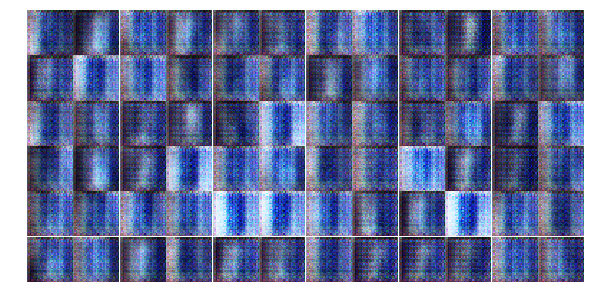

Epoch 1/25... Discriminator Loss: 0.1708... Generator Loss: 3.0576
Epoch 1/25... Discriminator Loss: 1.9128... Generator Loss: 0.2617
Epoch 1/25... Discriminator Loss: 0.3878... Generator Loss: 1.8574
Epoch 1/25... Discriminator Loss: 1.7425... Generator Loss: 0.5218
Epoch 1/25... Discriminator Loss: 0.1154... Generator Loss: 3.2788
Epoch 1/25... Discriminator Loss: 0.2649... Generator Loss: 5.3027
Epoch 1/25... Discriminator Loss: 0.5253... Generator Loss: 2.1812
Epoch 1/25... Discriminator Loss: 0.5779... Generator Loss: 2.1322
Epoch 1/25... Discriminator Loss: 0.3253... Generator Loss: 2.0143
Epoch 1/25... Discriminator Loss: 0.5416... Generator Loss: 1.6493


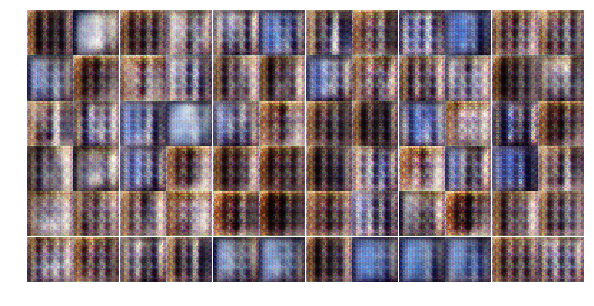

Epoch 1/25... Discriminator Loss: 1.0609... Generator Loss: 0.9080
Epoch 1/25... Discriminator Loss: 0.3983... Generator Loss: 1.9321
Epoch 1/25... Discriminator Loss: 0.4846... Generator Loss: 1.4594
Epoch 1/25... Discriminator Loss: 0.6510... Generator Loss: 1.4192
Epoch 1/25... Discriminator Loss: 0.7782... Generator Loss: 0.9811
Epoch 1/25... Discriminator Loss: 0.4802... Generator Loss: 1.7385
Epoch 1/25... Discriminator Loss: 0.4444... Generator Loss: 1.5760
Epoch 1/25... Discriminator Loss: 0.4556... Generator Loss: 1.8697
Epoch 1/25... Discriminator Loss: 0.3261... Generator Loss: 2.4062
Epoch 1/25... Discriminator Loss: 0.4919... Generator Loss: 1.5809


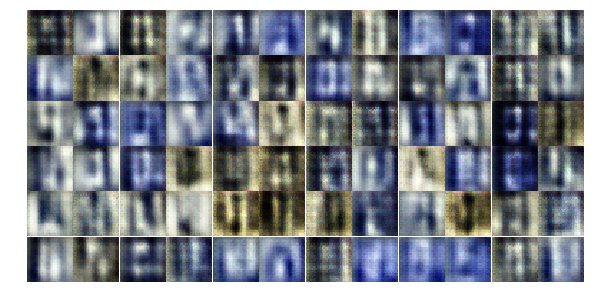

Epoch 1/25... Discriminator Loss: 0.3871... Generator Loss: 2.0566
Epoch 1/25... Discriminator Loss: 0.5399... Generator Loss: 2.4254
Epoch 1/25... Discriminator Loss: 0.4369... Generator Loss: 1.5166
Epoch 1/25... Discriminator Loss: 0.3126... Generator Loss: 2.6440
Epoch 1/25... Discriminator Loss: 0.6239... Generator Loss: 2.7520
Epoch 1/25... Discriminator Loss: 0.2703... Generator Loss: 2.2782
Epoch 1/25... Discriminator Loss: 0.7054... Generator Loss: 1.3064
Epoch 1/25... Discriminator Loss: 0.5907... Generator Loss: 1.4741
Epoch 1/25... Discriminator Loss: 1.6123... Generator Loss: 0.4958
Epoch 1/25... Discriminator Loss: 0.8276... Generator Loss: 2.6411


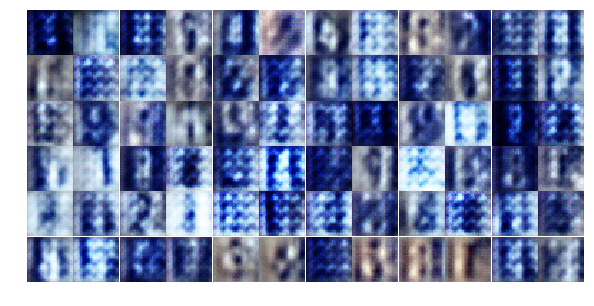

Epoch 1/25... Discriminator Loss: 1.0430... Generator Loss: 1.8833
Epoch 1/25... Discriminator Loss: 0.7077... Generator Loss: 1.2175
Epoch 1/25... Discriminator Loss: 0.5017... Generator Loss: 1.8247
Epoch 1/25... Discriminator Loss: 0.8506... Generator Loss: 1.2128
Epoch 1/25... Discriminator Loss: 0.6692... Generator Loss: 1.9368
Epoch 1/25... Discriminator Loss: 0.9623... Generator Loss: 0.7745
Epoch 1/25... Discriminator Loss: 0.7246... Generator Loss: 1.2497
Epoch 2/25... Discriminator Loss: 0.8655... Generator Loss: 1.6699
Epoch 2/25... Discriminator Loss: 0.5877... Generator Loss: 1.8507
Epoch 2/25... Discriminator Loss: 0.9252... Generator Loss: 1.1961


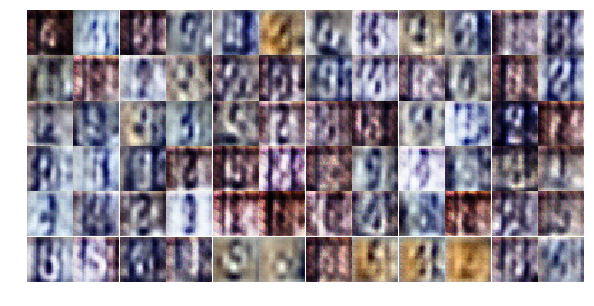

Epoch 2/25... Discriminator Loss: 0.7250... Generator Loss: 1.2597
Epoch 2/25... Discriminator Loss: 1.0772... Generator Loss: 1.1891
Epoch 2/25... Discriminator Loss: 1.1400... Generator Loss: 0.7700
Epoch 2/25... Discriminator Loss: 1.0079... Generator Loss: 0.9702
Epoch 2/25... Discriminator Loss: 0.9523... Generator Loss: 1.2675
Epoch 2/25... Discriminator Loss: 0.7650... Generator Loss: 1.3464
Epoch 2/25... Discriminator Loss: 0.8035... Generator Loss: 1.2900
Epoch 2/25... Discriminator Loss: 1.0192... Generator Loss: 2.0436
Epoch 2/25... Discriminator Loss: 1.3173... Generator Loss: 0.5852
Epoch 2/25... Discriminator Loss: 0.7246... Generator Loss: 1.4408


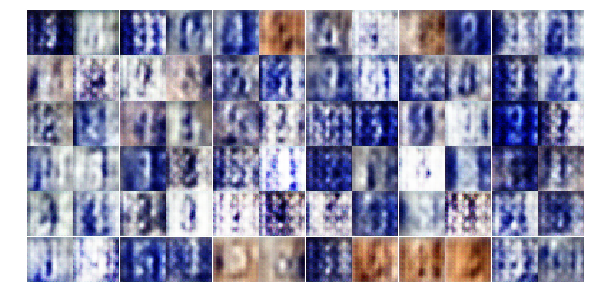

Epoch 2/25... Discriminator Loss: 1.0100... Generator Loss: 1.0802
Epoch 2/25... Discriminator Loss: 1.1185... Generator Loss: 0.8966
Epoch 2/25... Discriminator Loss: 1.1898... Generator Loss: 1.2297
Epoch 2/25... Discriminator Loss: 1.0723... Generator Loss: 1.0443
Epoch 2/25... Discriminator Loss: 0.8899... Generator Loss: 1.1564
Epoch 2/25... Discriminator Loss: 1.1488... Generator Loss: 0.9336
Epoch 2/25... Discriminator Loss: 0.8656... Generator Loss: 0.9843
Epoch 2/25... Discriminator Loss: 0.8816... Generator Loss: 1.0423
Epoch 2/25... Discriminator Loss: 1.2670... Generator Loss: 0.6907
Epoch 2/25... Discriminator Loss: 1.0331... Generator Loss: 0.9698


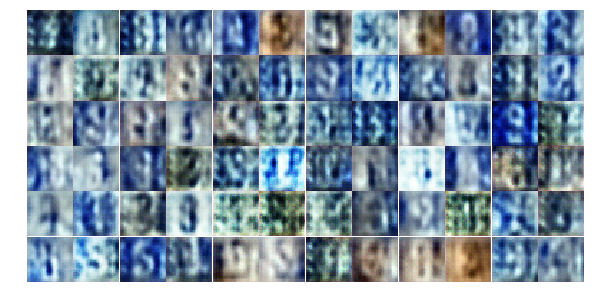

Epoch 2/25... Discriminator Loss: 1.0455... Generator Loss: 0.9150
Epoch 2/25... Discriminator Loss: 0.9909... Generator Loss: 1.0798
Epoch 2/25... Discriminator Loss: 0.9505... Generator Loss: 1.5484
Epoch 2/25... Discriminator Loss: 0.7551... Generator Loss: 1.3757
Epoch 2/25... Discriminator Loss: 0.8518... Generator Loss: 1.4970
Epoch 2/25... Discriminator Loss: 0.9811... Generator Loss: 0.9393
Epoch 2/25... Discriminator Loss: 0.6792... Generator Loss: 1.3088
Epoch 2/25... Discriminator Loss: 1.3654... Generator Loss: 0.6079
Epoch 2/25... Discriminator Loss: 1.1918... Generator Loss: 0.7962
Epoch 2/25... Discriminator Loss: 0.8497... Generator Loss: 1.1156


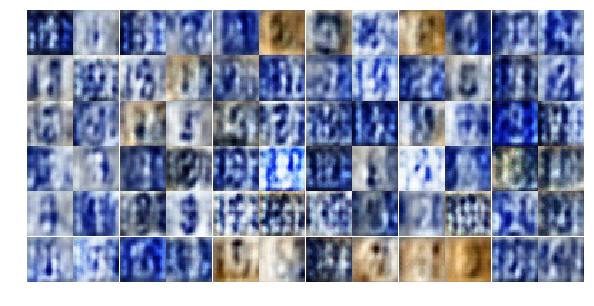

Epoch 2/25... Discriminator Loss: 0.9020... Generator Loss: 1.0679
Epoch 2/25... Discriminator Loss: 1.0379... Generator Loss: 0.9122
Epoch 2/25... Discriminator Loss: 0.9072... Generator Loss: 0.9135
Epoch 2/25... Discriminator Loss: 0.8552... Generator Loss: 1.0657
Epoch 2/25... Discriminator Loss: 0.9314... Generator Loss: 1.5815
Epoch 2/25... Discriminator Loss: 1.1856... Generator Loss: 1.4391
Epoch 2/25... Discriminator Loss: 1.0784... Generator Loss: 1.0717
Epoch 2/25... Discriminator Loss: 1.1456... Generator Loss: 2.1745
Epoch 2/25... Discriminator Loss: 1.0530... Generator Loss: 1.1689
Epoch 2/25... Discriminator Loss: 0.8567... Generator Loss: 1.3697


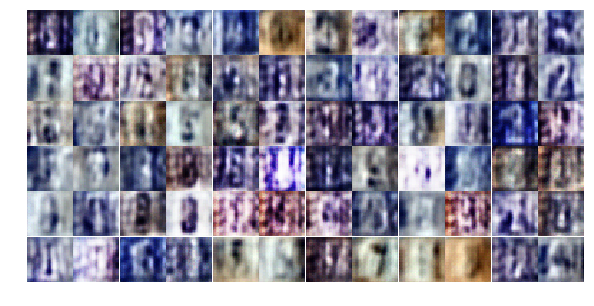

Epoch 2/25... Discriminator Loss: 0.7666... Generator Loss: 1.6352
Epoch 2/25... Discriminator Loss: 1.1816... Generator Loss: 0.7367
Epoch 2/25... Discriminator Loss: 0.7600... Generator Loss: 1.4195
Epoch 2/25... Discriminator Loss: 0.7327... Generator Loss: 1.2881
Epoch 2/25... Discriminator Loss: 0.9836... Generator Loss: 1.2164
Epoch 2/25... Discriminator Loss: 1.4122... Generator Loss: 0.4805
Epoch 2/25... Discriminator Loss: 0.9520... Generator Loss: 2.0488
Epoch 2/25... Discriminator Loss: 1.0100... Generator Loss: 1.3322
Epoch 2/25... Discriminator Loss: 0.5551... Generator Loss: 1.8614
Epoch 2/25... Discriminator Loss: 0.8220... Generator Loss: 1.0926


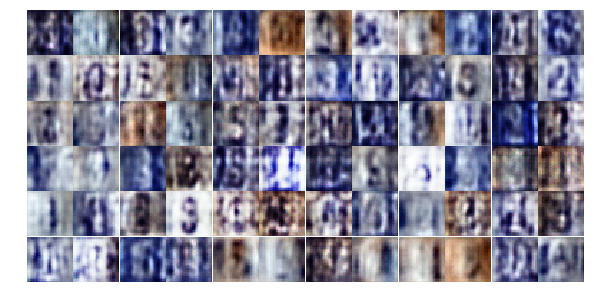

Epoch 2/25... Discriminator Loss: 0.6088... Generator Loss: 2.0085
Epoch 2/25... Discriminator Loss: 1.0392... Generator Loss: 0.6792
Epoch 2/25... Discriminator Loss: 0.8495... Generator Loss: 0.9634
Epoch 2/25... Discriminator Loss: 1.0600... Generator Loss: 0.7289
Epoch 3/25... Discriminator Loss: 0.7653... Generator Loss: 2.2826
Epoch 3/25... Discriminator Loss: 0.5577... Generator Loss: 1.3945
Epoch 3/25... Discriminator Loss: 0.4256... Generator Loss: 1.5657
Epoch 3/25... Discriminator Loss: 0.7527... Generator Loss: 0.8406
Epoch 3/25... Discriminator Loss: 0.5095... Generator Loss: 2.1280
Epoch 3/25... Discriminator Loss: 1.0047... Generator Loss: 1.9924


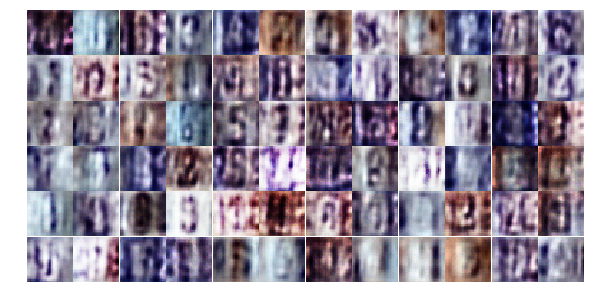

Epoch 3/25... Discriminator Loss: 0.7776... Generator Loss: 0.8732
Epoch 3/25... Discriminator Loss: 0.9429... Generator Loss: 1.1209
Epoch 3/25... Discriminator Loss: 0.4626... Generator Loss: 1.8630
Epoch 3/25... Discriminator Loss: 0.6408... Generator Loss: 1.5448
Epoch 3/25... Discriminator Loss: 2.0493... Generator Loss: 5.1401
Epoch 3/25... Discriminator Loss: 0.7520... Generator Loss: 1.1667
Epoch 3/25... Discriminator Loss: 0.6615... Generator Loss: 1.1054
Epoch 3/25... Discriminator Loss: 0.5074... Generator Loss: 2.4650
Epoch 3/25... Discriminator Loss: 0.4889... Generator Loss: 2.4350
Epoch 3/25... Discriminator Loss: 0.3083... Generator Loss: 2.4624


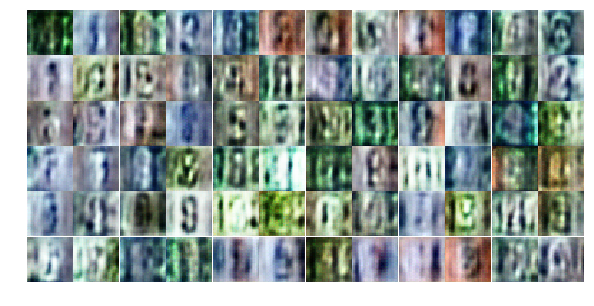

Epoch 3/25... Discriminator Loss: 0.7507... Generator Loss: 2.6084
Epoch 3/25... Discriminator Loss: 0.4189... Generator Loss: 2.5541
Epoch 3/25... Discriminator Loss: 0.5064... Generator Loss: 1.4550
Epoch 3/25... Discriminator Loss: 0.7847... Generator Loss: 0.8630
Epoch 3/25... Discriminator Loss: 0.6083... Generator Loss: 1.1101
Epoch 3/25... Discriminator Loss: 0.4262... Generator Loss: 1.7148
Epoch 3/25... Discriminator Loss: 1.1102... Generator Loss: 0.6594
Epoch 3/25... Discriminator Loss: 0.7668... Generator Loss: 1.1695
Epoch 3/25... Discriminator Loss: 0.4360... Generator Loss: 2.2125
Epoch 3/25... Discriminator Loss: 0.5337... Generator Loss: 1.2888


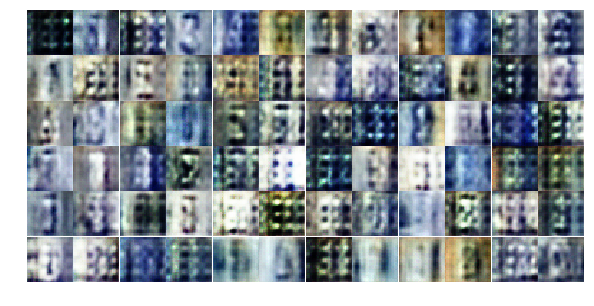

Epoch 3/25... Discriminator Loss: 0.9514... Generator Loss: 2.7845
Epoch 3/25... Discriminator Loss: 0.6721... Generator Loss: 1.0967
Epoch 3/25... Discriminator Loss: 0.6250... Generator Loss: 1.2755
Epoch 3/25... Discriminator Loss: 0.4522... Generator Loss: 1.4699
Epoch 3/25... Discriminator Loss: 0.6648... Generator Loss: 2.2175
Epoch 3/25... Discriminator Loss: 0.8181... Generator Loss: 0.9308
Epoch 3/25... Discriminator Loss: 0.4470... Generator Loss: 2.0080
Epoch 3/25... Discriminator Loss: 0.4837... Generator Loss: 1.8288
Epoch 3/25... Discriminator Loss: 0.7484... Generator Loss: 0.9510
Epoch 3/25... Discriminator Loss: 0.7659... Generator Loss: 0.9286


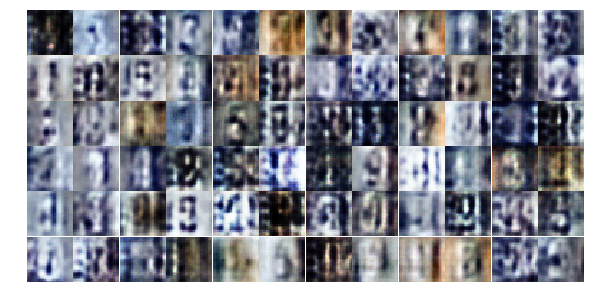

Epoch 3/25... Discriminator Loss: 1.1209... Generator Loss: 3.9611
Epoch 3/25... Discriminator Loss: 0.5470... Generator Loss: 1.5688
Epoch 3/25... Discriminator Loss: 0.4098... Generator Loss: 2.8480
Epoch 3/25... Discriminator Loss: 0.7162... Generator Loss: 1.0878
Epoch 3/25... Discriminator Loss: 0.6043... Generator Loss: 1.3537
Epoch 3/25... Discriminator Loss: 0.6002... Generator Loss: 1.7207
Epoch 3/25... Discriminator Loss: 0.6515... Generator Loss: 1.2479
Epoch 3/25... Discriminator Loss: 0.5704... Generator Loss: 3.0998
Epoch 3/25... Discriminator Loss: 0.4458... Generator Loss: 2.2249
Epoch 3/25... Discriminator Loss: 0.5965... Generator Loss: 1.3217


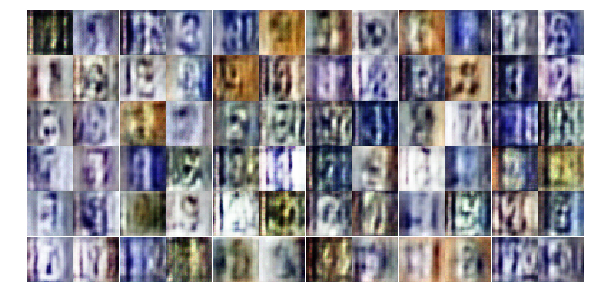

Epoch 3/25... Discriminator Loss: 1.1796... Generator Loss: 0.5632
Epoch 3/25... Discriminator Loss: 0.7644... Generator Loss: 1.7170
Epoch 3/25... Discriminator Loss: 0.7455... Generator Loss: 2.0947
Epoch 3/25... Discriminator Loss: 0.5178... Generator Loss: 2.0146
Epoch 3/25... Discriminator Loss: 0.8792... Generator Loss: 3.0281
Epoch 3/25... Discriminator Loss: 0.5095... Generator Loss: 1.5540
Epoch 3/25... Discriminator Loss: 0.3240... Generator Loss: 3.1798
Epoch 3/25... Discriminator Loss: 0.5597... Generator Loss: 2.8122
Epoch 3/25... Discriminator Loss: 0.5670... Generator Loss: 2.4435
Epoch 3/25... Discriminator Loss: 0.3103... Generator Loss: 2.5881


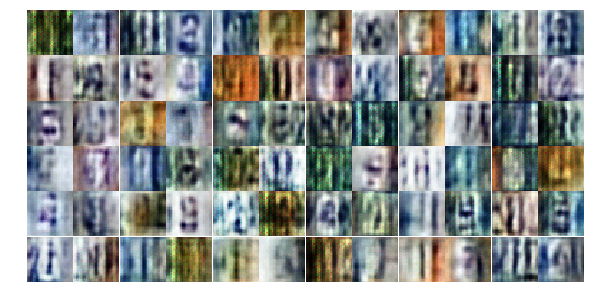

Epoch 3/25... Discriminator Loss: 1.6843... Generator Loss: 0.3834
Epoch 4/25... Discriminator Loss: 1.0506... Generator Loss: 0.6405
Epoch 4/25... Discriminator Loss: 0.7158... Generator Loss: 1.4068
Epoch 4/25... Discriminator Loss: 0.8000... Generator Loss: 0.9504
Epoch 4/25... Discriminator Loss: 0.3866... Generator Loss: 2.1562
Epoch 4/25... Discriminator Loss: 0.6476... Generator Loss: 1.0864
Epoch 4/25... Discriminator Loss: 0.7824... Generator Loss: 1.1880
Epoch 4/25... Discriminator Loss: 0.6787... Generator Loss: 1.1529
Epoch 4/25... Discriminator Loss: 1.1560... Generator Loss: 0.6130
Epoch 4/25... Discriminator Loss: 0.6821... Generator Loss: 1.1891


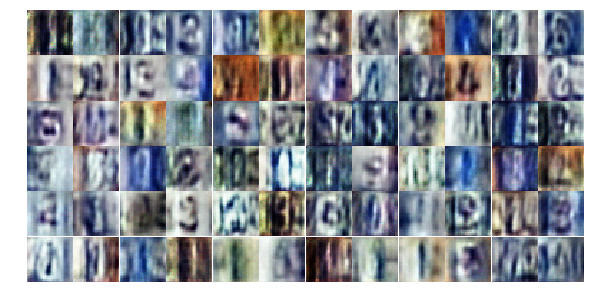

Epoch 4/25... Discriminator Loss: 0.3693... Generator Loss: 1.8443
Epoch 4/25... Discriminator Loss: 0.6666... Generator Loss: 1.8092
Epoch 4/25... Discriminator Loss: 0.5661... Generator Loss: 1.3123
Epoch 4/25... Discriminator Loss: 0.3875... Generator Loss: 2.1340
Epoch 4/25... Discriminator Loss: 0.9012... Generator Loss: 2.2551
Epoch 4/25... Discriminator Loss: 0.6249... Generator Loss: 1.4071
Epoch 4/25... Discriminator Loss: 0.9858... Generator Loss: 0.6019
Epoch 4/25... Discriminator Loss: 0.9626... Generator Loss: 0.7709
Epoch 4/25... Discriminator Loss: 0.7080... Generator Loss: 1.1351
Epoch 4/25... Discriminator Loss: 0.6974... Generator Loss: 1.6095


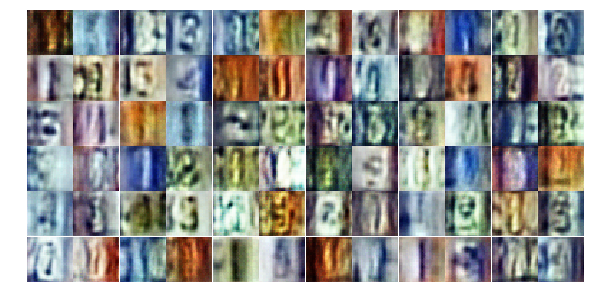

Epoch 4/25... Discriminator Loss: 0.5098... Generator Loss: 2.1056
Epoch 4/25... Discriminator Loss: 0.4910... Generator Loss: 1.4259
Epoch 4/25... Discriminator Loss: 0.9175... Generator Loss: 0.7485
Epoch 4/25... Discriminator Loss: 0.6311... Generator Loss: 1.8961
Epoch 4/25... Discriminator Loss: 0.5975... Generator Loss: 1.4129
Epoch 4/25... Discriminator Loss: 0.6669... Generator Loss: 2.0470
Epoch 4/25... Discriminator Loss: 0.8645... Generator Loss: 1.9477
Epoch 4/25... Discriminator Loss: 0.4307... Generator Loss: 1.6974
Epoch 4/25... Discriminator Loss: 0.6043... Generator Loss: 2.5457
Epoch 4/25... Discriminator Loss: 0.6716... Generator Loss: 1.2757


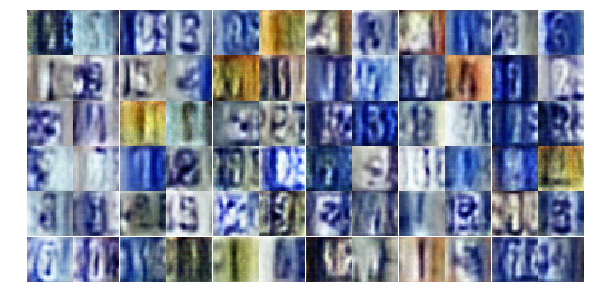

Epoch 4/25... Discriminator Loss: 0.4051... Generator Loss: 1.8875
Epoch 4/25... Discriminator Loss: 0.5630... Generator Loss: 1.1725
Epoch 4/25... Discriminator Loss: 0.3832... Generator Loss: 1.9015
Epoch 4/25... Discriminator Loss: 0.3143... Generator Loss: 2.1394
Epoch 4/25... Discriminator Loss: 0.3683... Generator Loss: 2.5616
Epoch 4/25... Discriminator Loss: 0.4955... Generator Loss: 1.3517
Epoch 4/25... Discriminator Loss: 0.8309... Generator Loss: 3.0618
Epoch 4/25... Discriminator Loss: 1.2628... Generator Loss: 0.5040
Epoch 4/25... Discriminator Loss: 0.6418... Generator Loss: 1.0995
Epoch 4/25... Discriminator Loss: 0.6734... Generator Loss: 1.1571


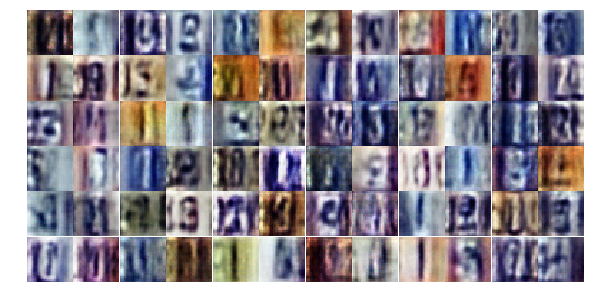

Epoch 4/25... Discriminator Loss: 0.6745... Generator Loss: 0.9455
Epoch 4/25... Discriminator Loss: 0.4163... Generator Loss: 1.7028
Epoch 4/25... Discriminator Loss: 0.4672... Generator Loss: 1.6689
Epoch 4/25... Discriminator Loss: 0.4694... Generator Loss: 2.5940
Epoch 4/25... Discriminator Loss: 0.3462... Generator Loss: 2.0005
Epoch 4/25... Discriminator Loss: 0.8163... Generator Loss: 0.8854
Epoch 4/25... Discriminator Loss: 1.2243... Generator Loss: 0.7092
Epoch 4/25... Discriminator Loss: 0.7480... Generator Loss: 1.4798
Epoch 4/25... Discriminator Loss: 0.7028... Generator Loss: 1.0343
Epoch 4/25... Discriminator Loss: 0.4664... Generator Loss: 1.6553


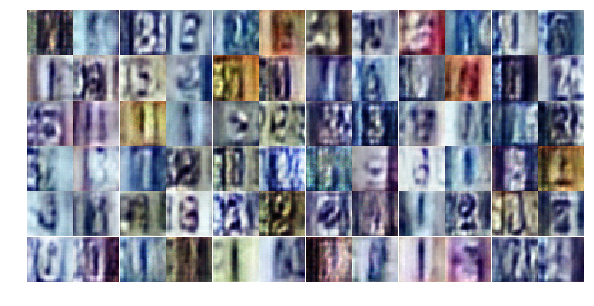

Epoch 4/25... Discriminator Loss: 0.5652... Generator Loss: 2.1247
Epoch 4/25... Discriminator Loss: 0.3506... Generator Loss: 2.1476
Epoch 4/25... Discriminator Loss: 0.4164... Generator Loss: 1.7984
Epoch 4/25... Discriminator Loss: 0.2950... Generator Loss: 2.4151
Epoch 4/25... Discriminator Loss: 0.4946... Generator Loss: 1.4822
Epoch 4/25... Discriminator Loss: 1.0406... Generator Loss: 1.8722
Epoch 4/25... Discriminator Loss: 0.3935... Generator Loss: 2.3038
Epoch 4/25... Discriminator Loss: 0.6885... Generator Loss: 1.0673
Epoch 4/25... Discriminator Loss: 0.4111... Generator Loss: 1.7822
Epoch 5/25... Discriminator Loss: 0.3986... Generator Loss: 1.9551


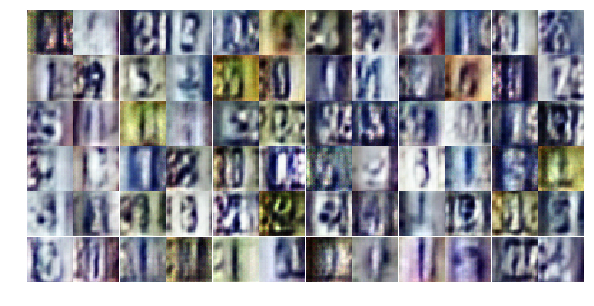

Epoch 5/25... Discriminator Loss: 0.5998... Generator Loss: 1.3635
Epoch 5/25... Discriminator Loss: 0.4862... Generator Loss: 2.1992
Epoch 5/25... Discriminator Loss: 0.7140... Generator Loss: 1.1350
Epoch 5/25... Discriminator Loss: 0.3401... Generator Loss: 1.7737
Epoch 5/25... Discriminator Loss: 0.2315... Generator Loss: 2.8716
Epoch 5/25... Discriminator Loss: 0.9898... Generator Loss: 0.6149
Epoch 5/25... Discriminator Loss: 0.5481... Generator Loss: 1.9806
Epoch 5/25... Discriminator Loss: 0.6098... Generator Loss: 1.0531
Epoch 5/25... Discriminator Loss: 0.7609... Generator Loss: 0.8470
Epoch 5/25... Discriminator Loss: 0.6247... Generator Loss: 1.1767


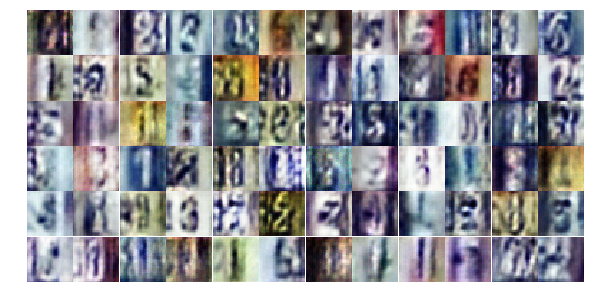

Epoch 5/25... Discriminator Loss: 1.8516... Generator Loss: 4.1778
Epoch 5/25... Discriminator Loss: 0.4968... Generator Loss: 1.9285
Epoch 5/25... Discriminator Loss: 0.3735... Generator Loss: 1.7690
Epoch 5/25... Discriminator Loss: 0.7983... Generator Loss: 0.8154
Epoch 5/25... Discriminator Loss: 2.7369... Generator Loss: 4.5600
Epoch 5/25... Discriminator Loss: 0.6647... Generator Loss: 1.4922
Epoch 5/25... Discriminator Loss: 0.5744... Generator Loss: 1.5264
Epoch 5/25... Discriminator Loss: 0.5534... Generator Loss: 1.3526
Epoch 5/25... Discriminator Loss: 0.4398... Generator Loss: 1.5002
Epoch 5/25... Discriminator Loss: 0.4426... Generator Loss: 2.0633


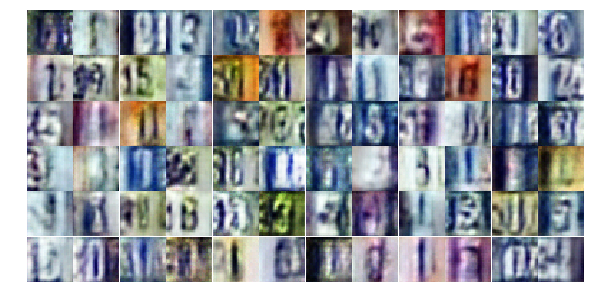

Epoch 5/25... Discriminator Loss: 0.4554... Generator Loss: 1.4849
Epoch 5/25... Discriminator Loss: 0.7014... Generator Loss: 0.9151
Epoch 5/25... Discriminator Loss: 0.5410... Generator Loss: 2.0848
Epoch 5/25... Discriminator Loss: 1.0422... Generator Loss: 0.7389
Epoch 5/25... Discriminator Loss: 0.7384... Generator Loss: 0.9089
Epoch 5/25... Discriminator Loss: 0.4539... Generator Loss: 1.4684
Epoch 5/25... Discriminator Loss: 0.9131... Generator Loss: 0.6973
Epoch 5/25... Discriminator Loss: 0.4370... Generator Loss: 2.8932
Epoch 5/25... Discriminator Loss: 1.5328... Generator Loss: 0.3943
Epoch 5/25... Discriminator Loss: 0.4054... Generator Loss: 1.8617


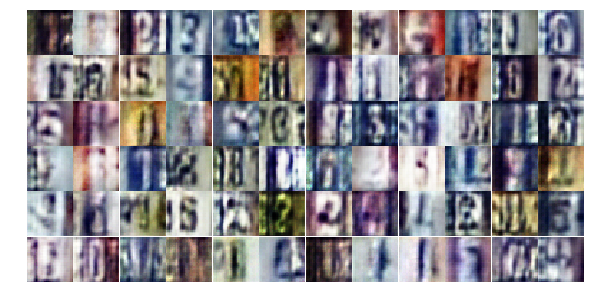

Epoch 5/25... Discriminator Loss: 1.0050... Generator Loss: 0.6230
Epoch 5/25... Discriminator Loss: 0.6084... Generator Loss: 1.0938
Epoch 5/25... Discriminator Loss: 0.4646... Generator Loss: 1.4982
Epoch 5/25... Discriminator Loss: 0.8384... Generator Loss: 2.4572
Epoch 5/25... Discriminator Loss: 0.8875... Generator Loss: 3.1067
Epoch 5/25... Discriminator Loss: 0.4087... Generator Loss: 2.2039
Epoch 5/25... Discriminator Loss: 0.7620... Generator Loss: 0.8204
Epoch 5/25... Discriminator Loss: 0.5125... Generator Loss: 1.2427
Epoch 5/25... Discriminator Loss: 0.6428... Generator Loss: 1.0613
Epoch 5/25... Discriminator Loss: 0.7958... Generator Loss: 0.8598


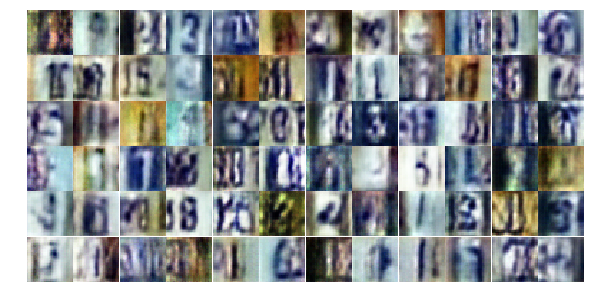

Epoch 5/25... Discriminator Loss: 0.3016... Generator Loss: 2.3833
Epoch 5/25... Discriminator Loss: 0.3667... Generator Loss: 1.9524
Epoch 5/25... Discriminator Loss: 0.7540... Generator Loss: 2.5199
Epoch 5/25... Discriminator Loss: 1.1132... Generator Loss: 3.7819
Epoch 5/25... Discriminator Loss: 1.1958... Generator Loss: 2.3955
Epoch 5/25... Discriminator Loss: 0.6162... Generator Loss: 1.2626
Epoch 5/25... Discriminator Loss: 0.5796... Generator Loss: 1.4574
Epoch 5/25... Discriminator Loss: 0.4398... Generator Loss: 1.5573
Epoch 5/25... Discriminator Loss: 0.5936... Generator Loss: 1.2420
Epoch 5/25... Discriminator Loss: 0.5080... Generator Loss: 1.6077


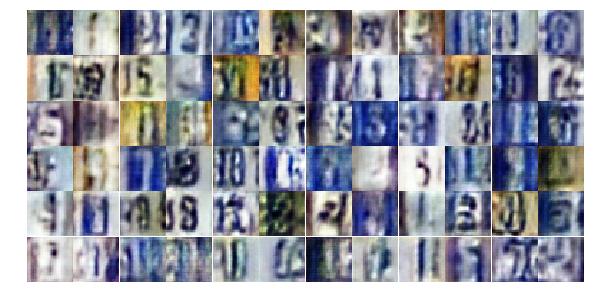

Epoch 5/25... Discriminator Loss: 0.7350... Generator Loss: 1.2691
Epoch 5/25... Discriminator Loss: 0.3782... Generator Loss: 1.6876
Epoch 5/25... Discriminator Loss: 1.2038... Generator Loss: 2.8939
Epoch 5/25... Discriminator Loss: 0.9084... Generator Loss: 0.6543
Epoch 5/25... Discriminator Loss: 0.4851... Generator Loss: 1.7303
Epoch 5/25... Discriminator Loss: 1.8489... Generator Loss: 0.2283
Epoch 6/25... Discriminator Loss: 1.0595... Generator Loss: 0.6194
Epoch 6/25... Discriminator Loss: 0.4396... Generator Loss: 1.6360
Epoch 6/25... Discriminator Loss: 0.3763... Generator Loss: 2.0305
Epoch 6/25... Discriminator Loss: 0.5816... Generator Loss: 1.3430


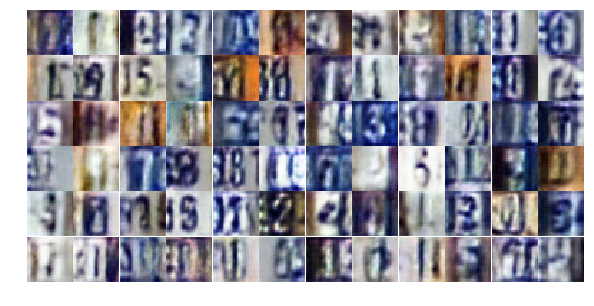

Epoch 6/25... Discriminator Loss: 0.3790... Generator Loss: 1.7834
Epoch 6/25... Discriminator Loss: 0.6624... Generator Loss: 1.5402
Epoch 6/25... Discriminator Loss: 0.4133... Generator Loss: 1.4393
Epoch 6/25... Discriminator Loss: 0.6844... Generator Loss: 1.0844
Epoch 6/25... Discriminator Loss: 1.3348... Generator Loss: 0.4083
Epoch 6/25... Discriminator Loss: 0.7602... Generator Loss: 1.0159
Epoch 6/25... Discriminator Loss: 0.6653... Generator Loss: 1.2146
Epoch 6/25... Discriminator Loss: 1.2194... Generator Loss: 0.4778
Epoch 6/25... Discriminator Loss: 0.5537... Generator Loss: 1.1792
Epoch 6/25... Discriminator Loss: 0.8566... Generator Loss: 1.0898


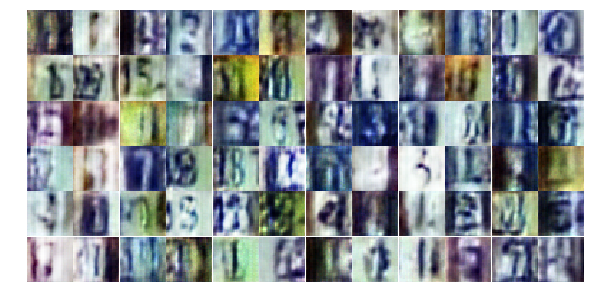

Epoch 6/25... Discriminator Loss: 0.4930... Generator Loss: 2.4464
Epoch 6/25... Discriminator Loss: 0.6530... Generator Loss: 1.2302
Epoch 6/25... Discriminator Loss: 1.2160... Generator Loss: 0.4918
Epoch 6/25... Discriminator Loss: 1.3112... Generator Loss: 0.4387
Epoch 6/25... Discriminator Loss: 0.4461... Generator Loss: 1.8750
Epoch 6/25... Discriminator Loss: 0.5859... Generator Loss: 1.2262
Epoch 6/25... Discriminator Loss: 0.4574... Generator Loss: 1.6603
Epoch 6/25... Discriminator Loss: 0.7988... Generator Loss: 0.8400
Epoch 6/25... Discriminator Loss: 0.4659... Generator Loss: 1.8457
Epoch 6/25... Discriminator Loss: 0.7176... Generator Loss: 1.1534


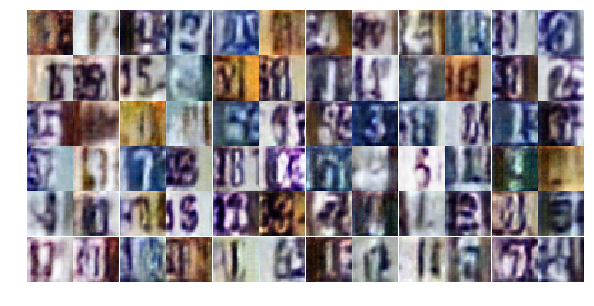

Epoch 6/25... Discriminator Loss: 1.3163... Generator Loss: 0.4510
Epoch 6/25... Discriminator Loss: 0.8556... Generator Loss: 0.7844
Epoch 6/25... Discriminator Loss: 1.0781... Generator Loss: 0.5303
Epoch 6/25... Discriminator Loss: 0.9052... Generator Loss: 0.6817
Epoch 6/25... Discriminator Loss: 0.5111... Generator Loss: 2.4619
Epoch 6/25... Discriminator Loss: 2.4290... Generator Loss: 0.1728
Epoch 6/25... Discriminator Loss: 1.0070... Generator Loss: 0.7595
Epoch 6/25... Discriminator Loss: 0.5322... Generator Loss: 1.3976
Epoch 6/25... Discriminator Loss: 0.5650... Generator Loss: 1.3279
Epoch 6/25... Discriminator Loss: 0.5996... Generator Loss: 1.3394


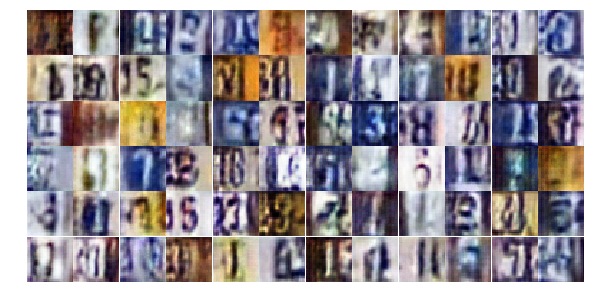

Epoch 6/25... Discriminator Loss: 0.7022... Generator Loss: 1.1096
Epoch 6/25... Discriminator Loss: 0.6305... Generator Loss: 1.4447
Epoch 6/25... Discriminator Loss: 0.5880... Generator Loss: 1.3869
Epoch 6/25... Discriminator Loss: 0.7171... Generator Loss: 1.0224
Epoch 6/25... Discriminator Loss: 0.9506... Generator Loss: 0.8020
Epoch 6/25... Discriminator Loss: 0.4237... Generator Loss: 1.4557
Epoch 6/25... Discriminator Loss: 0.5753... Generator Loss: 1.6687
Epoch 6/25... Discriminator Loss: 0.4871... Generator Loss: 1.4499
Epoch 6/25... Discriminator Loss: 0.7952... Generator Loss: 0.8608
Epoch 6/25... Discriminator Loss: 0.4836... Generator Loss: 1.4414


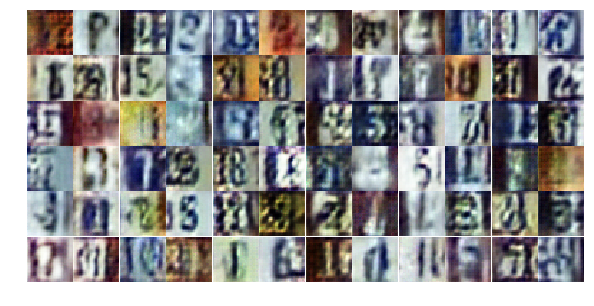

Epoch 6/25... Discriminator Loss: 0.9692... Generator Loss: 1.7348
Epoch 6/25... Discriminator Loss: 0.7880... Generator Loss: 1.4061
Epoch 6/25... Discriminator Loss: 1.1118... Generator Loss: 0.6376
Epoch 6/25... Discriminator Loss: 0.6377... Generator Loss: 1.7372
Epoch 6/25... Discriminator Loss: 0.5375... Generator Loss: 1.5883
Epoch 6/25... Discriminator Loss: 0.5231... Generator Loss: 1.3994
Epoch 6/25... Discriminator Loss: 0.8470... Generator Loss: 0.7908
Epoch 6/25... Discriminator Loss: 1.2127... Generator Loss: 0.4643
Epoch 6/25... Discriminator Loss: 0.7299... Generator Loss: 0.9973
Epoch 6/25... Discriminator Loss: 1.5862... Generator Loss: 0.3470


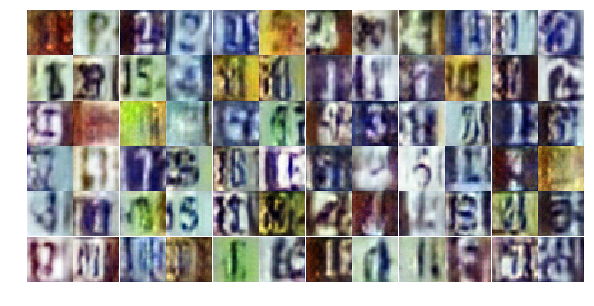

Epoch 6/25... Discriminator Loss: 0.5461... Generator Loss: 1.3590
Epoch 6/25... Discriminator Loss: 0.7032... Generator Loss: 0.9576
Epoch 6/25... Discriminator Loss: 0.7368... Generator Loss: 1.1777
Epoch 7/25... Discriminator Loss: 0.7126... Generator Loss: 1.3782
Epoch 7/25... Discriminator Loss: 0.5455... Generator Loss: 1.4604
Epoch 7/25... Discriminator Loss: 0.6615... Generator Loss: 1.0504
Epoch 7/25... Discriminator Loss: 0.3941... Generator Loss: 1.9053
Epoch 7/25... Discriminator Loss: 0.3805... Generator Loss: 1.6436
Epoch 7/25... Discriminator Loss: 0.4361... Generator Loss: 1.9385
Epoch 7/25... Discriminator Loss: 0.7350... Generator Loss: 0.9402


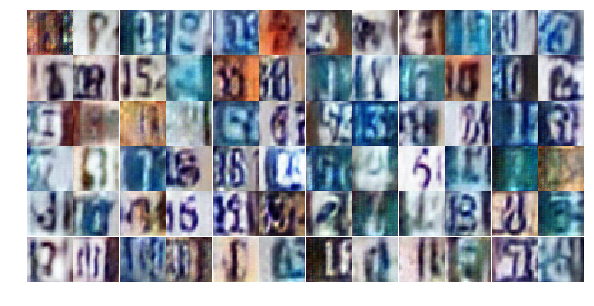

Epoch 7/25... Discriminator Loss: 0.7235... Generator Loss: 0.9053
Epoch 7/25... Discriminator Loss: 1.0680... Generator Loss: 2.0819
Epoch 7/25... Discriminator Loss: 1.3673... Generator Loss: 0.4111
Epoch 7/25... Discriminator Loss: 0.7007... Generator Loss: 1.0109
Epoch 7/25... Discriminator Loss: 0.6426... Generator Loss: 1.1248
Epoch 7/25... Discriminator Loss: 0.4882... Generator Loss: 1.7528
Epoch 7/25... Discriminator Loss: 0.7332... Generator Loss: 1.6592
Epoch 7/25... Discriminator Loss: 0.8554... Generator Loss: 2.4498
Epoch 7/25... Discriminator Loss: 0.5520... Generator Loss: 2.0246
Epoch 7/25... Discriminator Loss: 0.6006... Generator Loss: 1.1515


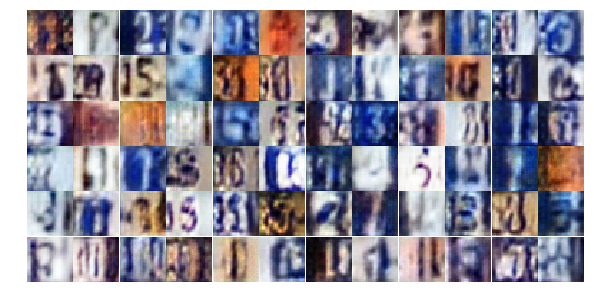

Epoch 7/25... Discriminator Loss: 0.5158... Generator Loss: 1.3282
Epoch 7/25... Discriminator Loss: 0.4946... Generator Loss: 1.3618
Epoch 7/25... Discriminator Loss: 0.9835... Generator Loss: 1.1772
Epoch 7/25... Discriminator Loss: 0.8606... Generator Loss: 2.3865
Epoch 7/25... Discriminator Loss: 0.5171... Generator Loss: 1.7541
Epoch 7/25... Discriminator Loss: 0.6766... Generator Loss: 1.5015
Epoch 7/25... Discriminator Loss: 0.6756... Generator Loss: 1.0189
Epoch 7/25... Discriminator Loss: 0.8493... Generator Loss: 0.9699
Epoch 7/25... Discriminator Loss: 0.3115... Generator Loss: 1.9420
Epoch 7/25... Discriminator Loss: 0.4630... Generator Loss: 1.5898


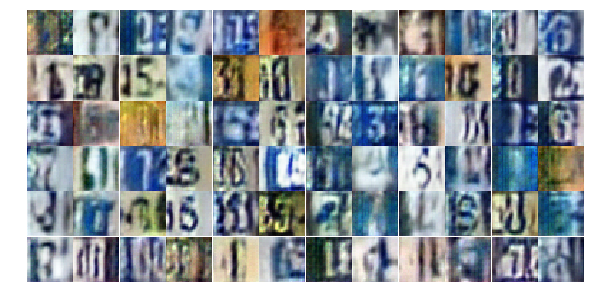

Epoch 7/25... Discriminator Loss: 0.8423... Generator Loss: 0.7189
Epoch 7/25... Discriminator Loss: 0.9929... Generator Loss: 0.6022
Epoch 7/25... Discriminator Loss: 0.5395... Generator Loss: 1.4384
Epoch 7/25... Discriminator Loss: 0.4660... Generator Loss: 1.7471
Epoch 7/25... Discriminator Loss: 0.8096... Generator Loss: 1.9746
Epoch 7/25... Discriminator Loss: 1.4718... Generator Loss: 0.3414
Epoch 7/25... Discriminator Loss: 0.5833... Generator Loss: 1.1600
Epoch 7/25... Discriminator Loss: 0.5142... Generator Loss: 1.5035
Epoch 7/25... Discriminator Loss: 0.8902... Generator Loss: 1.2039
Epoch 7/25... Discriminator Loss: 0.5963... Generator Loss: 2.1524


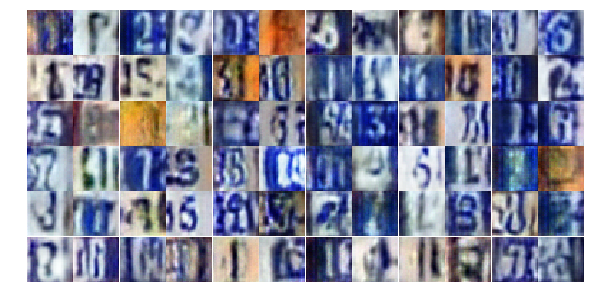

Epoch 7/25... Discriminator Loss: 0.9801... Generator Loss: 0.6855
Epoch 7/25... Discriminator Loss: 0.6945... Generator Loss: 2.0879
Epoch 7/25... Discriminator Loss: 0.4156... Generator Loss: 1.5014
Epoch 7/25... Discriminator Loss: 0.6334... Generator Loss: 1.7596
Epoch 7/25... Discriminator Loss: 1.3930... Generator Loss: 0.4147
Epoch 7/25... Discriminator Loss: 0.3405... Generator Loss: 1.8785
Epoch 7/25... Discriminator Loss: 0.7130... Generator Loss: 0.8998
Epoch 7/25... Discriminator Loss: 1.3000... Generator Loss: 1.8925
Epoch 7/25... Discriminator Loss: 0.3426... Generator Loss: 2.0224
Epoch 7/25... Discriminator Loss: 1.2416... Generator Loss: 0.5650


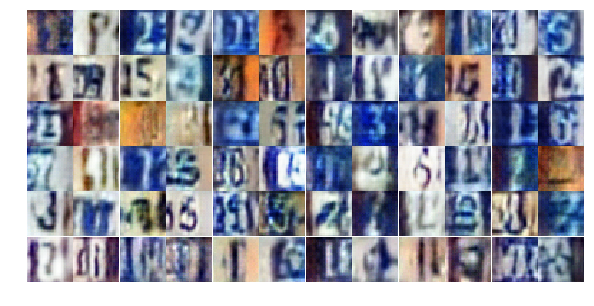

Epoch 7/25... Discriminator Loss: 0.4632... Generator Loss: 2.0426
Epoch 7/25... Discriminator Loss: 0.4474... Generator Loss: 1.6598
Epoch 7/25... Discriminator Loss: 0.9858... Generator Loss: 0.5951
Epoch 7/25... Discriminator Loss: 0.3532... Generator Loss: 1.7196
Epoch 7/25... Discriminator Loss: 0.5008... Generator Loss: 1.3371
Epoch 7/25... Discriminator Loss: 0.3003... Generator Loss: 2.0024
Epoch 7/25... Discriminator Loss: 1.8768... Generator Loss: 0.2649
Epoch 7/25... Discriminator Loss: 1.7720... Generator Loss: 2.0666
Epoch 7/25... Discriminator Loss: 1.0722... Generator Loss: 2.2182
Epoch 7/25... Discriminator Loss: 1.1363... Generator Loss: 0.5174


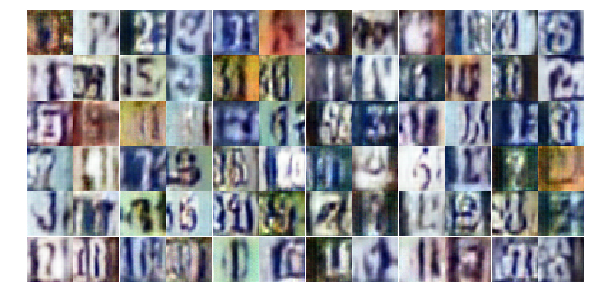

Epoch 7/25... Discriminator Loss: 0.5561... Generator Loss: 1.6650
Epoch 8/25... Discriminator Loss: 0.7296... Generator Loss: 0.9437
Epoch 8/25... Discriminator Loss: 0.8175... Generator Loss: 0.8022
Epoch 8/25... Discriminator Loss: 0.5185... Generator Loss: 1.3344
Epoch 8/25... Discriminator Loss: 0.5190... Generator Loss: 1.3029
Epoch 8/25... Discriminator Loss: 0.8978... Generator Loss: 0.7110
Epoch 8/25... Discriminator Loss: 0.9036... Generator Loss: 0.7245
Epoch 8/25... Discriminator Loss: 0.3767... Generator Loss: 1.7178
Epoch 8/25... Discriminator Loss: 1.2053... Generator Loss: 0.5166
Epoch 8/25... Discriminator Loss: 0.4802... Generator Loss: 1.4105


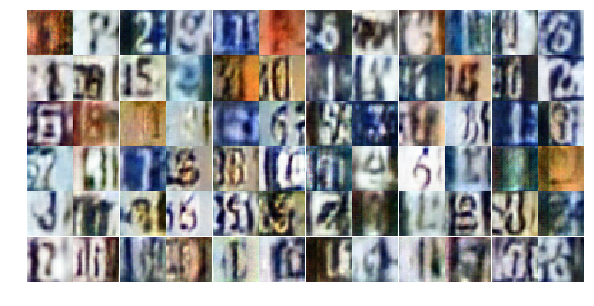

Epoch 8/25... Discriminator Loss: 0.5707... Generator Loss: 1.3190
Epoch 8/25... Discriminator Loss: 0.4702... Generator Loss: 1.4402
Epoch 8/25... Discriminator Loss: 0.6044... Generator Loss: 1.1392
Epoch 8/25... Discriminator Loss: 0.3521... Generator Loss: 1.6917
Epoch 8/25... Discriminator Loss: 0.9121... Generator Loss: 0.6826
Epoch 8/25... Discriminator Loss: 0.8615... Generator Loss: 2.9969
Epoch 8/25... Discriminator Loss: 0.6331... Generator Loss: 1.2513
Epoch 8/25... Discriminator Loss: 0.7063... Generator Loss: 1.4866
Epoch 8/25... Discriminator Loss: 0.6576... Generator Loss: 1.0182
Epoch 8/25... Discriminator Loss: 1.5554... Generator Loss: 0.3156


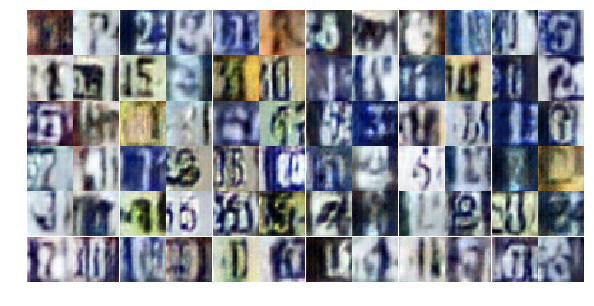

Epoch 8/25... Discriminator Loss: 0.5496... Generator Loss: 1.4131
Epoch 8/25... Discriminator Loss: 0.3926... Generator Loss: 1.5669
Epoch 8/25... Discriminator Loss: 0.4543... Generator Loss: 1.4871
Epoch 8/25... Discriminator Loss: 0.5973... Generator Loss: 1.4597
Epoch 8/25... Discriminator Loss: 0.4185... Generator Loss: 1.8637
Epoch 8/25... Discriminator Loss: 0.5821... Generator Loss: 1.6605
Epoch 8/25... Discriminator Loss: 0.4916... Generator Loss: 1.9303
Epoch 8/25... Discriminator Loss: 0.4265... Generator Loss: 1.6346
Epoch 8/25... Discriminator Loss: 0.9008... Generator Loss: 2.3495
Epoch 8/25... Discriminator Loss: 0.8676... Generator Loss: 1.4868


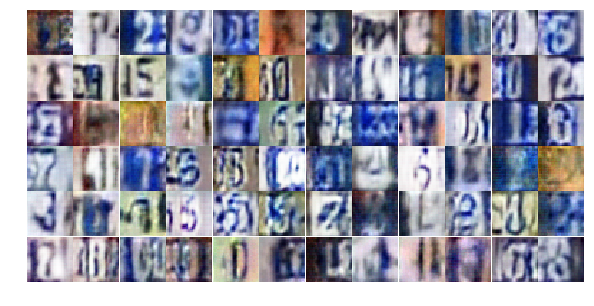

Epoch 8/25... Discriminator Loss: 1.0062... Generator Loss: 1.0429
Epoch 8/25... Discriminator Loss: 0.8649... Generator Loss: 0.7964
Epoch 8/25... Discriminator Loss: 0.6951... Generator Loss: 1.2355
Epoch 8/25... Discriminator Loss: 0.6435... Generator Loss: 1.1384
Epoch 8/25... Discriminator Loss: 0.5667... Generator Loss: 1.2866
Epoch 8/25... Discriminator Loss: 0.5629... Generator Loss: 1.1068
Epoch 8/25... Discriminator Loss: 0.4113... Generator Loss: 1.7454
Epoch 8/25... Discriminator Loss: 0.4208... Generator Loss: 1.7392
Epoch 8/25... Discriminator Loss: 0.5506... Generator Loss: 1.2237
Epoch 8/25... Discriminator Loss: 0.6202... Generator Loss: 1.0816


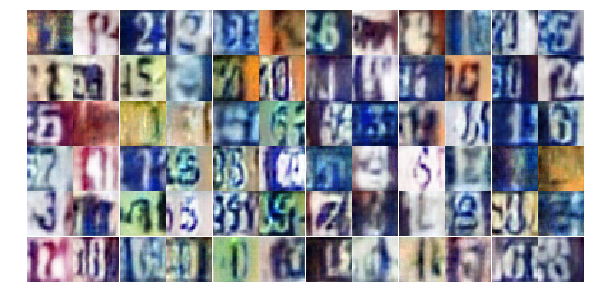

Epoch 8/25... Discriminator Loss: 0.4937... Generator Loss: 2.3681
Epoch 8/25... Discriminator Loss: 1.0271... Generator Loss: 0.5763
Epoch 8/25... Discriminator Loss: 0.6231... Generator Loss: 1.0647
Epoch 8/25... Discriminator Loss: 0.5158... Generator Loss: 1.3324
Epoch 8/25... Discriminator Loss: 0.9352... Generator Loss: 2.4399
Epoch 8/25... Discriminator Loss: 0.3753... Generator Loss: 1.6475
Epoch 8/25... Discriminator Loss: 0.3532... Generator Loss: 1.8232
Epoch 8/25... Discriminator Loss: 0.7013... Generator Loss: 0.9182
Epoch 8/25... Discriminator Loss: 0.5750... Generator Loss: 2.8298
Epoch 8/25... Discriminator Loss: 0.5786... Generator Loss: 2.9408


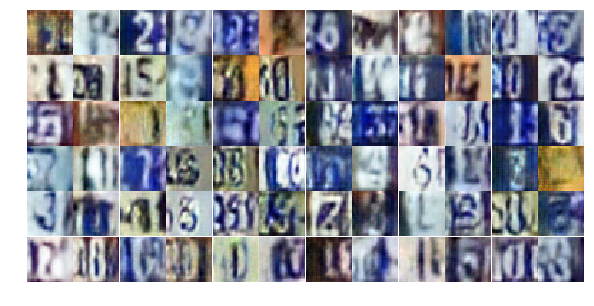

Epoch 8/25... Discriminator Loss: 0.4041... Generator Loss: 1.5729
Epoch 8/25... Discriminator Loss: 0.4498... Generator Loss: 1.4616
Epoch 8/25... Discriminator Loss: 1.2731... Generator Loss: 3.7392
Epoch 8/25... Discriminator Loss: 1.9785... Generator Loss: 0.2154
Epoch 8/25... Discriminator Loss: 0.5098... Generator Loss: 2.4142
Epoch 8/25... Discriminator Loss: 1.1963... Generator Loss: 0.5855
Epoch 8/25... Discriminator Loss: 0.5488... Generator Loss: 1.2697
Epoch 8/25... Discriminator Loss: 0.9908... Generator Loss: 2.8832
Epoch 9/25... Discriminator Loss: 0.8311... Generator Loss: 0.9221
Epoch 9/25... Discriminator Loss: 0.7072... Generator Loss: 0.9662


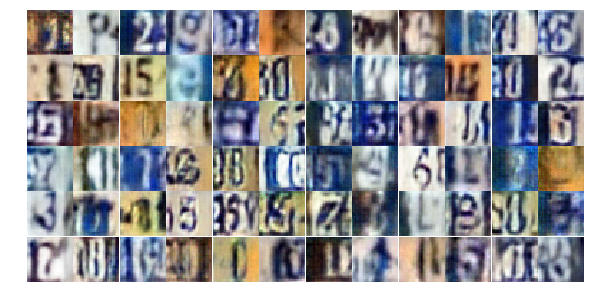

Epoch 9/25... Discriminator Loss: 0.5287... Generator Loss: 1.2855
Epoch 9/25... Discriminator Loss: 0.4956... Generator Loss: 1.4325
Epoch 9/25... Discriminator Loss: 0.9875... Generator Loss: 0.7250
Epoch 9/25... Discriminator Loss: 0.3508... Generator Loss: 2.1314
Epoch 9/25... Discriminator Loss: 0.9190... Generator Loss: 0.6453
Epoch 9/25... Discriminator Loss: 1.2421... Generator Loss: 3.7654
Epoch 9/25... Discriminator Loss: 0.7036... Generator Loss: 1.1285
Epoch 9/25... Discriminator Loss: 0.5072... Generator Loss: 1.3810
Epoch 9/25... Discriminator Loss: 0.7138... Generator Loss: 1.0563
Epoch 9/25... Discriminator Loss: 0.6807... Generator Loss: 0.9948


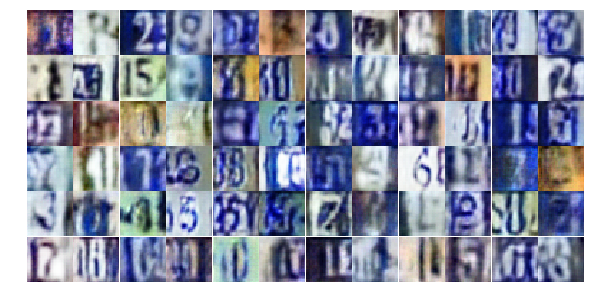

Epoch 9/25... Discriminator Loss: 0.9335... Generator Loss: 0.6978
Epoch 9/25... Discriminator Loss: 1.2075... Generator Loss: 0.5519
Epoch 9/25... Discriminator Loss: 0.6631... Generator Loss: 1.4392
Epoch 9/25... Discriminator Loss: 0.7119... Generator Loss: 1.8952
Epoch 9/25... Discriminator Loss: 0.7676... Generator Loss: 1.0855
Epoch 9/25... Discriminator Loss: 0.6041... Generator Loss: 2.0601
Epoch 9/25... Discriminator Loss: 1.3189... Generator Loss: 0.4370
Epoch 9/25... Discriminator Loss: 0.7243... Generator Loss: 0.9438
Epoch 9/25... Discriminator Loss: 0.8689... Generator Loss: 0.8164
Epoch 9/25... Discriminator Loss: 0.9445... Generator Loss: 0.7925


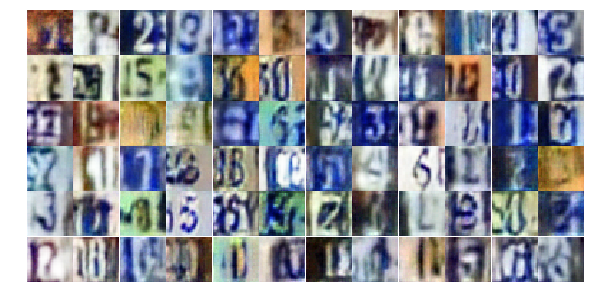

Epoch 9/25... Discriminator Loss: 0.9060... Generator Loss: 0.8685
Epoch 9/25... Discriminator Loss: 0.4776... Generator Loss: 1.8390
Epoch 9/25... Discriminator Loss: 0.6318... Generator Loss: 2.2382
Epoch 9/25... Discriminator Loss: 1.2177... Generator Loss: 0.5176
Epoch 9/25... Discriminator Loss: 0.6006... Generator Loss: 1.5811
Epoch 9/25... Discriminator Loss: 0.5362... Generator Loss: 1.9529
Epoch 9/25... Discriminator Loss: 1.1433... Generator Loss: 0.5437
Epoch 9/25... Discriminator Loss: 1.1376... Generator Loss: 2.7118
Epoch 9/25... Discriminator Loss: 0.5974... Generator Loss: 1.2908
Epoch 9/25... Discriminator Loss: 0.5270... Generator Loss: 1.2252


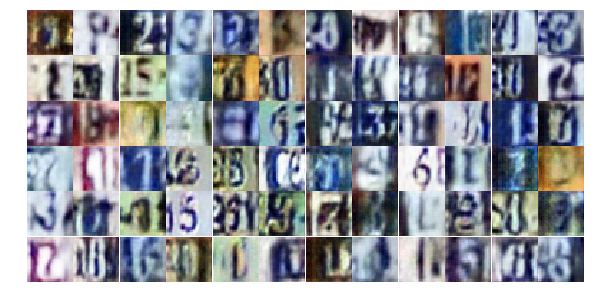

Epoch 9/25... Discriminator Loss: 0.6783... Generator Loss: 0.9724
Epoch 9/25... Discriminator Loss: 0.5250... Generator Loss: 1.2568
Epoch 9/25... Discriminator Loss: 0.7924... Generator Loss: 0.8096
Epoch 9/25... Discriminator Loss: 0.6539... Generator Loss: 1.6893
Epoch 9/25... Discriminator Loss: 0.5216... Generator Loss: 1.4499
Epoch 9/25... Discriminator Loss: 0.6962... Generator Loss: 1.2443
Epoch 9/25... Discriminator Loss: 0.5068... Generator Loss: 1.5451
Epoch 9/25... Discriminator Loss: 0.3743... Generator Loss: 1.6738
Epoch 9/25... Discriminator Loss: 0.9253... Generator Loss: 0.7118
Epoch 9/25... Discriminator Loss: 0.8669... Generator Loss: 0.6918


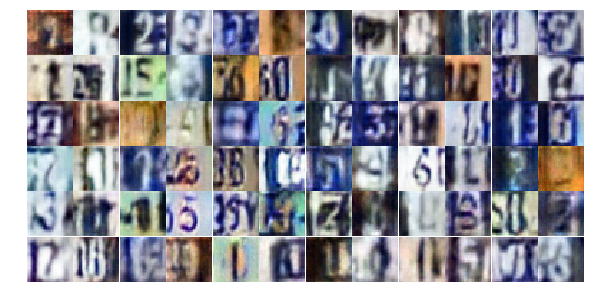

Epoch 9/25... Discriminator Loss: 0.4345... Generator Loss: 1.8858
Epoch 9/25... Discriminator Loss: 0.4414... Generator Loss: 1.6157
Epoch 9/25... Discriminator Loss: 0.5000... Generator Loss: 2.2042
Epoch 9/25... Discriminator Loss: 0.5994... Generator Loss: 1.3436
Epoch 9/25... Discriminator Loss: 0.4017... Generator Loss: 1.7354
Epoch 9/25... Discriminator Loss: 0.8193... Generator Loss: 1.1668
Epoch 9/25... Discriminator Loss: 0.7427... Generator Loss: 0.8919
Epoch 9/25... Discriminator Loss: 1.4932... Generator Loss: 0.4128
Epoch 9/25... Discriminator Loss: 0.6603... Generator Loss: 0.9555
Epoch 9/25... Discriminator Loss: 0.5962... Generator Loss: 2.7472


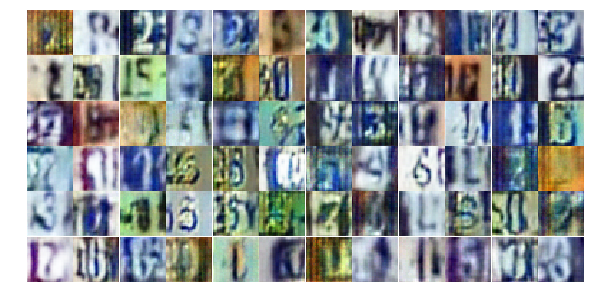

Epoch 9/25... Discriminator Loss: 1.2838... Generator Loss: 0.4456
Epoch 9/25... Discriminator Loss: 1.3739... Generator Loss: 3.8068
Epoch 9/25... Discriminator Loss: 0.5157... Generator Loss: 1.6227
Epoch 9/25... Discriminator Loss: 1.7185... Generator Loss: 0.2592
Epoch 9/25... Discriminator Loss: 0.6645... Generator Loss: 1.4954
Epoch 10/25... Discriminator Loss: 0.5978... Generator Loss: 1.2150
Epoch 10/25... Discriminator Loss: 0.5521... Generator Loss: 1.2451
Epoch 10/25... Discriminator Loss: 0.5844... Generator Loss: 1.1447
Epoch 10/25... Discriminator Loss: 0.6798... Generator Loss: 1.0508
Epoch 10/25... Discriminator Loss: 1.0961... Generator Loss: 0.5276


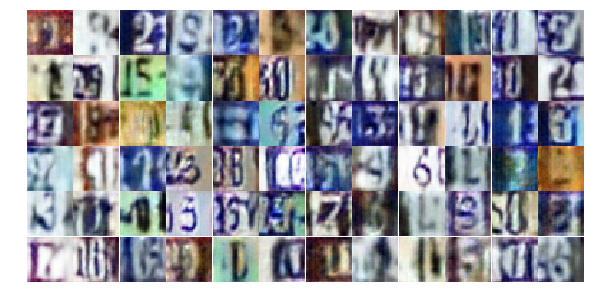

Epoch 10/25... Discriminator Loss: 0.5496... Generator Loss: 1.1540
Epoch 10/25... Discriminator Loss: 0.4240... Generator Loss: 1.8480
Epoch 10/25... Discriminator Loss: 0.5668... Generator Loss: 1.1963
Epoch 10/25... Discriminator Loss: 0.4903... Generator Loss: 1.5486
Epoch 10/25... Discriminator Loss: 0.5239... Generator Loss: 1.2954
Epoch 10/25... Discriminator Loss: 0.5637... Generator Loss: 1.2584
Epoch 10/25... Discriminator Loss: 0.3982... Generator Loss: 1.5018
Epoch 10/25... Discriminator Loss: 0.8856... Generator Loss: 0.8355
Epoch 10/25... Discriminator Loss: 1.3406... Generator Loss: 0.4173
Epoch 10/25... Discriminator Loss: 0.8200... Generator Loss: 0.8478


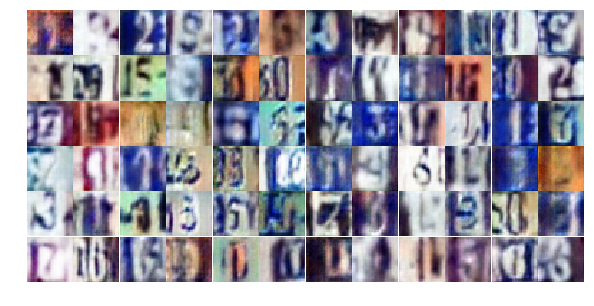

Epoch 10/25... Discriminator Loss: 0.5822... Generator Loss: 1.6430
Epoch 10/25... Discriminator Loss: 0.8590... Generator Loss: 0.8507
Epoch 10/25... Discriminator Loss: 0.5569... Generator Loss: 1.2834
Epoch 10/25... Discriminator Loss: 1.1589... Generator Loss: 0.4894
Epoch 10/25... Discriminator Loss: 0.6486... Generator Loss: 1.1598
Epoch 10/25... Discriminator Loss: 0.4209... Generator Loss: 1.5674
Epoch 10/25... Discriminator Loss: 0.8284... Generator Loss: 0.7901
Epoch 10/25... Discriminator Loss: 0.4431... Generator Loss: 1.5531
Epoch 10/25... Discriminator Loss: 0.5718... Generator Loss: 1.3129
Epoch 10/25... Discriminator Loss: 1.0544... Generator Loss: 4.0212


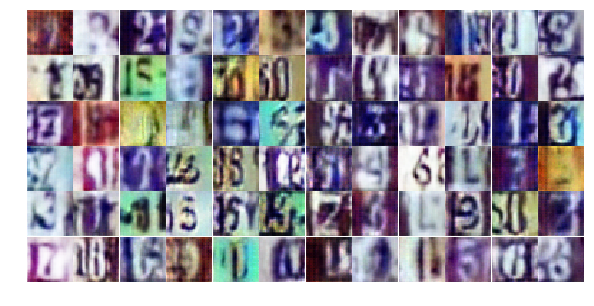

Epoch 10/25... Discriminator Loss: 1.3975... Generator Loss: 0.4575
Epoch 10/25... Discriminator Loss: 0.5746... Generator Loss: 1.5172
Epoch 10/25... Discriminator Loss: 0.4672... Generator Loss: 1.4547
Epoch 10/25... Discriminator Loss: 0.4178... Generator Loss: 1.7588
Epoch 10/25... Discriminator Loss: 1.4795... Generator Loss: 0.3423
Epoch 10/25... Discriminator Loss: 0.4788... Generator Loss: 1.3970
Epoch 10/25... Discriminator Loss: 0.3107... Generator Loss: 1.7585
Epoch 10/25... Discriminator Loss: 0.6915... Generator Loss: 1.3121
Epoch 10/25... Discriminator Loss: 0.7459... Generator Loss: 0.8686
Epoch 10/25... Discriminator Loss: 0.9524... Generator Loss: 2.4585


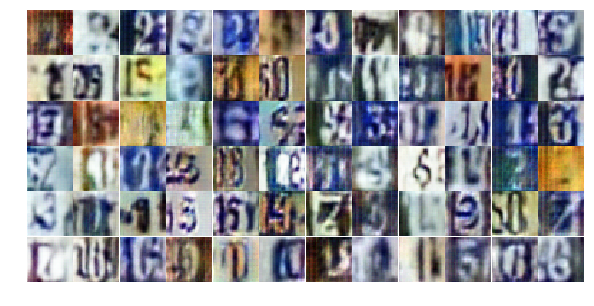

Epoch 10/25... Discriminator Loss: 1.4096... Generator Loss: 4.0723
Epoch 10/25... Discriminator Loss: 0.6281... Generator Loss: 1.3838
Epoch 10/25... Discriminator Loss: 0.6509... Generator Loss: 1.5198
Epoch 10/25... Discriminator Loss: 0.4553... Generator Loss: 1.9833
Epoch 10/25... Discriminator Loss: 0.8393... Generator Loss: 0.7990
Epoch 10/25... Discriminator Loss: 0.5397... Generator Loss: 1.2941
Epoch 10/25... Discriminator Loss: 0.8978... Generator Loss: 0.7230
Epoch 10/25... Discriminator Loss: 0.9169... Generator Loss: 0.6951
Epoch 10/25... Discriminator Loss: 0.3340... Generator Loss: 1.7798
Epoch 10/25... Discriminator Loss: 0.4493... Generator Loss: 2.1578


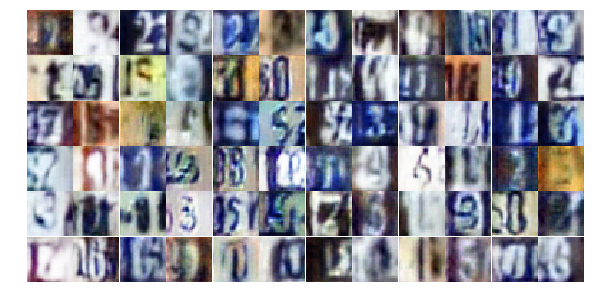

Epoch 10/25... Discriminator Loss: 0.4971... Generator Loss: 1.4244
Epoch 10/25... Discriminator Loss: 0.6915... Generator Loss: 1.0766
Epoch 10/25... Discriminator Loss: 1.5600... Generator Loss: 0.5144
Epoch 10/25... Discriminator Loss: 0.6646... Generator Loss: 1.0971
Epoch 10/25... Discriminator Loss: 0.4659... Generator Loss: 1.8081
Epoch 10/25... Discriminator Loss: 0.4435... Generator Loss: 1.5276
Epoch 10/25... Discriminator Loss: 0.6643... Generator Loss: 0.9962
Epoch 10/25... Discriminator Loss: 0.4459... Generator Loss: 1.7017
Epoch 10/25... Discriminator Loss: 0.8705... Generator Loss: 2.2205
Epoch 10/25... Discriminator Loss: 0.5913... Generator Loss: 1.4807


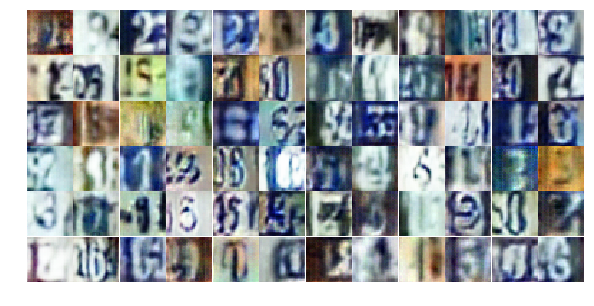

Epoch 10/25... Discriminator Loss: 1.1568... Generator Loss: 0.5099
Epoch 10/25... Discriminator Loss: 0.6090... Generator Loss: 1.1165
Epoch 10/25... Discriminator Loss: 0.4583... Generator Loss: 1.3205
Epoch 11/25... Discriminator Loss: 1.3119... Generator Loss: 0.4395
Epoch 11/25... Discriminator Loss: 0.5552... Generator Loss: 1.3389
Epoch 11/25... Discriminator Loss: 1.3475... Generator Loss: 0.4004
Epoch 11/25... Discriminator Loss: 1.1265... Generator Loss: 0.5579
Epoch 11/25... Discriminator Loss: 0.7144... Generator Loss: 2.3499
Epoch 11/25... Discriminator Loss: 1.7084... Generator Loss: 0.2692
Epoch 11/25... Discriminator Loss: 0.6601... Generator Loss: 1.0875


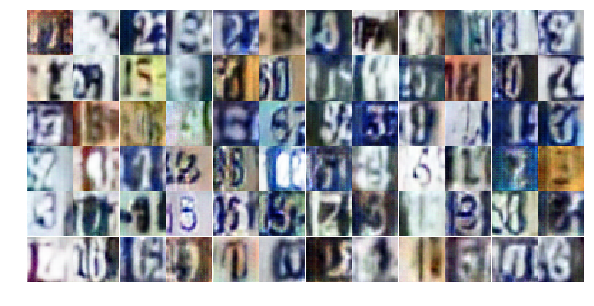

Epoch 11/25... Discriminator Loss: 0.4335... Generator Loss: 1.4968
Epoch 11/25... Discriminator Loss: 0.6939... Generator Loss: 1.0646
Epoch 11/25... Discriminator Loss: 0.6069... Generator Loss: 1.0857
Epoch 11/25... Discriminator Loss: 0.7312... Generator Loss: 0.9890
Epoch 11/25... Discriminator Loss: 0.6604... Generator Loss: 1.1447
Epoch 11/25... Discriminator Loss: 0.3702... Generator Loss: 1.8422
Epoch 11/25... Discriminator Loss: 0.7020... Generator Loss: 1.0414
Epoch 11/25... Discriminator Loss: 0.3095... Generator Loss: 2.1875
Epoch 11/25... Discriminator Loss: 0.6703... Generator Loss: 1.1283
Epoch 11/25... Discriminator Loss: 1.1168... Generator Loss: 0.5921


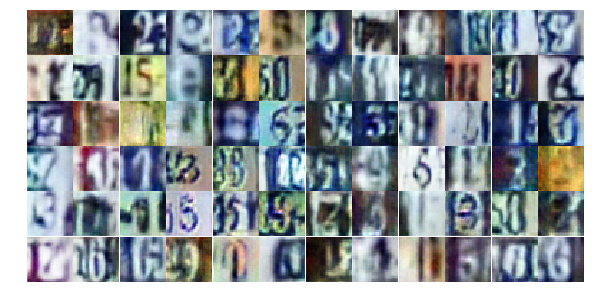

Epoch 11/25... Discriminator Loss: 0.7648... Generator Loss: 0.8874
Epoch 11/25... Discriminator Loss: 0.5028... Generator Loss: 1.8012
Epoch 11/25... Discriminator Loss: 0.4160... Generator Loss: 1.4146
Epoch 11/25... Discriminator Loss: 0.6054... Generator Loss: 1.1546
Epoch 11/25... Discriminator Loss: 0.2955... Generator Loss: 1.8519
Epoch 11/25... Discriminator Loss: 0.4787... Generator Loss: 1.3463
Epoch 11/25... Discriminator Loss: 0.5288... Generator Loss: 1.1793
Epoch 11/25... Discriminator Loss: 1.3712... Generator Loss: 0.4243
Epoch 11/25... Discriminator Loss: 0.6249... Generator Loss: 2.3241
Epoch 11/25... Discriminator Loss: 0.8300... Generator Loss: 0.8523


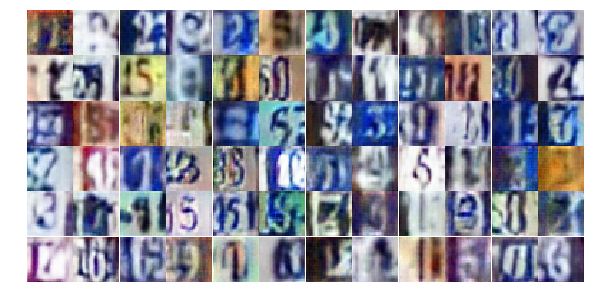

Epoch 11/25... Discriminator Loss: 0.6207... Generator Loss: 1.1815
Epoch 11/25... Discriminator Loss: 0.5045... Generator Loss: 1.3187
Epoch 11/25... Discriminator Loss: 0.7678... Generator Loss: 0.9311
Epoch 11/25... Discriminator Loss: 0.3745... Generator Loss: 1.7275
Epoch 11/25... Discriminator Loss: 0.6219... Generator Loss: 1.0624
Epoch 11/25... Discriminator Loss: 0.7615... Generator Loss: 0.9095
Epoch 11/25... Discriminator Loss: 1.0136... Generator Loss: 0.6865
Epoch 11/25... Discriminator Loss: 1.2355... Generator Loss: 0.4379
Epoch 11/25... Discriminator Loss: 0.7736... Generator Loss: 1.4031
Epoch 11/25... Discriminator Loss: 1.2098... Generator Loss: 0.5138


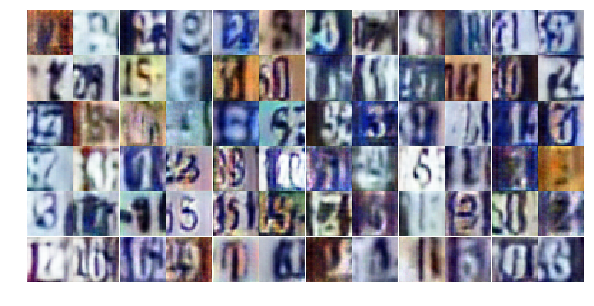

Epoch 11/25... Discriminator Loss: 0.3875... Generator Loss: 1.6612
Epoch 11/25... Discriminator Loss: 0.6070... Generator Loss: 1.2137
Epoch 11/25... Discriminator Loss: 0.6937... Generator Loss: 1.0583
Epoch 11/25... Discriminator Loss: 0.6400... Generator Loss: 1.1573
Epoch 11/25... Discriminator Loss: 0.9109... Generator Loss: 0.6989
Epoch 11/25... Discriminator Loss: 0.6636... Generator Loss: 1.1304
Epoch 11/25... Discriminator Loss: 0.4916... Generator Loss: 1.8712
Epoch 11/25... Discriminator Loss: 0.5554... Generator Loss: 1.9810
Epoch 11/25... Discriminator Loss: 1.4745... Generator Loss: 0.3952
Epoch 11/25... Discriminator Loss: 0.5041... Generator Loss: 1.2513


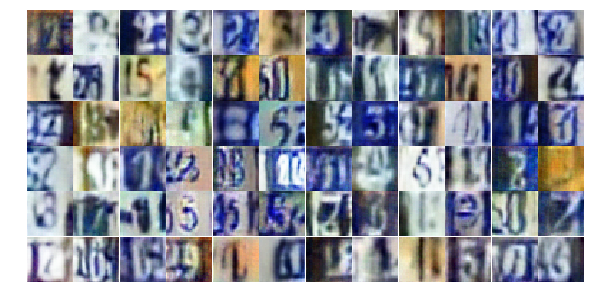

Epoch 11/25... Discriminator Loss: 0.5480... Generator Loss: 1.2558
Epoch 11/25... Discriminator Loss: 0.3570... Generator Loss: 2.0236
Epoch 11/25... Discriminator Loss: 0.9169... Generator Loss: 0.8125
Epoch 11/25... Discriminator Loss: 0.5913... Generator Loss: 1.0866
Epoch 11/25... Discriminator Loss: 0.7468... Generator Loss: 0.9865
Epoch 11/25... Discriminator Loss: 0.6333... Generator Loss: 1.1396
Epoch 11/25... Discriminator Loss: 0.8516... Generator Loss: 0.8554
Epoch 11/25... Discriminator Loss: 0.8771... Generator Loss: 0.7856
Epoch 11/25... Discriminator Loss: 2.0879... Generator Loss: 0.1833
Epoch 11/25... Discriminator Loss: 0.5155... Generator Loss: 1.4537


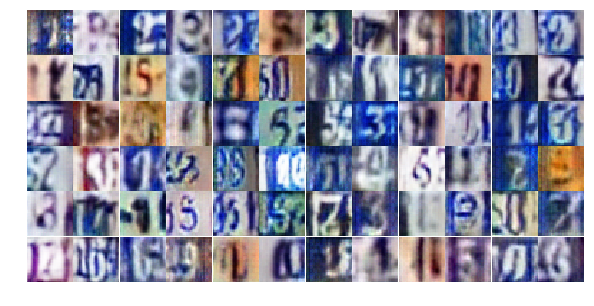

Epoch 12/25... Discriminator Loss: 0.6336... Generator Loss: 1.5654
Epoch 12/25... Discriminator Loss: 0.6103... Generator Loss: 1.3566
Epoch 12/25... Discriminator Loss: 0.8580... Generator Loss: 0.8171
Epoch 12/25... Discriminator Loss: 0.5916... Generator Loss: 1.2431
Epoch 12/25... Discriminator Loss: 0.4564... Generator Loss: 1.5449
Epoch 12/25... Discriminator Loss: 0.7174... Generator Loss: 0.8903
Epoch 12/25... Discriminator Loss: 0.5857... Generator Loss: 1.2673
Epoch 12/25... Discriminator Loss: 0.4090... Generator Loss: 1.7625
Epoch 12/25... Discriminator Loss: 0.7461... Generator Loss: 1.0031
Epoch 12/25... Discriminator Loss: 1.6261... Generator Loss: 0.3030


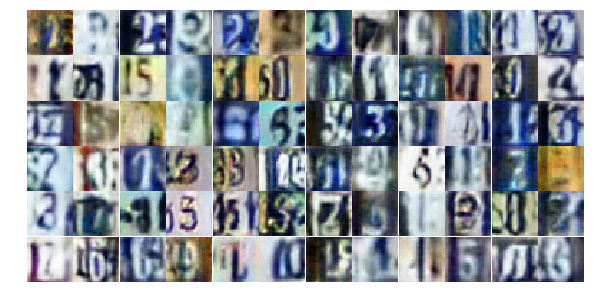

Epoch 12/25... Discriminator Loss: 0.5941... Generator Loss: 1.1092
Epoch 12/25... Discriminator Loss: 0.7426... Generator Loss: 0.8980
Epoch 12/25... Discriminator Loss: 0.4304... Generator Loss: 1.5059
Epoch 12/25... Discriminator Loss: 0.5620... Generator Loss: 1.8029
Epoch 12/25... Discriminator Loss: 0.4186... Generator Loss: 2.1885
Epoch 12/25... Discriminator Loss: 1.1128... Generator Loss: 1.6566
Epoch 12/25... Discriminator Loss: 1.4853... Generator Loss: 0.3645
Epoch 12/25... Discriminator Loss: 0.4311... Generator Loss: 1.8997
Epoch 12/25... Discriminator Loss: 0.4785... Generator Loss: 1.7279
Epoch 12/25... Discriminator Loss: 0.7509... Generator Loss: 0.9440


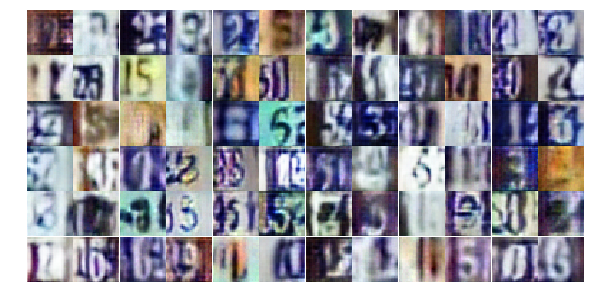

Epoch 12/25... Discriminator Loss: 0.4665... Generator Loss: 2.7131
Epoch 12/25... Discriminator Loss: 0.4852... Generator Loss: 1.6037
Epoch 12/25... Discriminator Loss: 0.4792... Generator Loss: 1.5468
Epoch 12/25... Discriminator Loss: 0.4342... Generator Loss: 1.6571
Epoch 12/25... Discriminator Loss: 0.3596... Generator Loss: 2.2970
Epoch 12/25... Discriminator Loss: 0.5095... Generator Loss: 1.5846
Epoch 12/25... Discriminator Loss: 0.6801... Generator Loss: 0.9798
Epoch 12/25... Discriminator Loss: 0.4764... Generator Loss: 1.4080
Epoch 12/25... Discriminator Loss: 0.5157... Generator Loss: 1.2962
Epoch 12/25... Discriminator Loss: 0.4831... Generator Loss: 1.2987


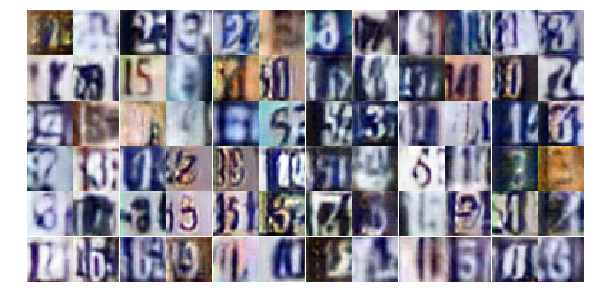

Epoch 12/25... Discriminator Loss: 0.4231... Generator Loss: 1.4819
Epoch 12/25... Discriminator Loss: 1.2323... Generator Loss: 0.5045
Epoch 12/25... Discriminator Loss: 0.8111... Generator Loss: 0.7904
Epoch 12/25... Discriminator Loss: 1.8457... Generator Loss: 0.2396
Epoch 12/25... Discriminator Loss: 0.4580... Generator Loss: 1.9850
Epoch 12/25... Discriminator Loss: 0.6044... Generator Loss: 1.1708
Epoch 12/25... Discriminator Loss: 1.4285... Generator Loss: 0.4029
Epoch 12/25... Discriminator Loss: 0.7186... Generator Loss: 0.9463
Epoch 12/25... Discriminator Loss: 0.5305... Generator Loss: 1.7938
Epoch 12/25... Discriminator Loss: 0.3434... Generator Loss: 1.7710


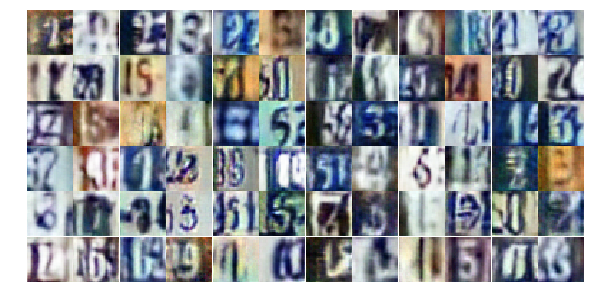

Epoch 12/25... Discriminator Loss: 0.4204... Generator Loss: 1.8632
Epoch 12/25... Discriminator Loss: 0.3661... Generator Loss: 2.4486
Epoch 12/25... Discriminator Loss: 0.5266... Generator Loss: 1.3931
Epoch 12/25... Discriminator Loss: 0.7716... Generator Loss: 1.1159
Epoch 12/25... Discriminator Loss: 1.4414... Generator Loss: 2.0658
Epoch 12/25... Discriminator Loss: 0.8422... Generator Loss: 0.7953
Epoch 12/25... Discriminator Loss: 0.6275... Generator Loss: 1.2411
Epoch 12/25... Discriminator Loss: 0.9891... Generator Loss: 0.6886
Epoch 12/25... Discriminator Loss: 0.3531... Generator Loss: 1.6605
Epoch 12/25... Discriminator Loss: 0.7670... Generator Loss: 0.8410


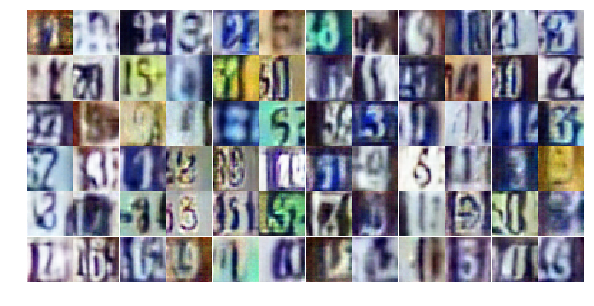

Epoch 12/25... Discriminator Loss: 0.7588... Generator Loss: 1.0122
Epoch 12/25... Discriminator Loss: 0.5522... Generator Loss: 1.4149
Epoch 12/25... Discriminator Loss: 0.6384... Generator Loss: 1.1176
Epoch 12/25... Discriminator Loss: 1.3754... Generator Loss: 0.4500
Epoch 12/25... Discriminator Loss: 0.5055... Generator Loss: 1.2605
Epoch 12/25... Discriminator Loss: 0.7989... Generator Loss: 1.3139
Epoch 12/25... Discriminator Loss: 0.6471... Generator Loss: 1.1501
Epoch 13/25... Discriminator Loss: 0.5192... Generator Loss: 1.3010
Epoch 13/25... Discriminator Loss: 0.4910... Generator Loss: 1.3206
Epoch 13/25... Discriminator Loss: 0.7137... Generator Loss: 0.9464


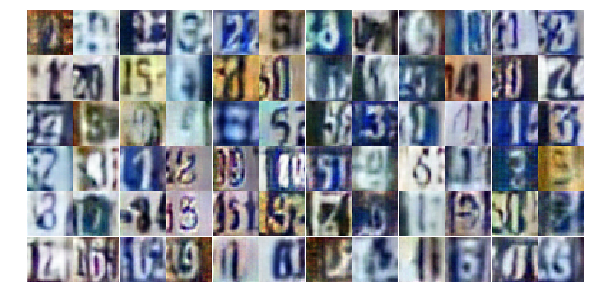

Epoch 13/25... Discriminator Loss: 0.3648... Generator Loss: 1.5523
Epoch 13/25... Discriminator Loss: 0.6261... Generator Loss: 1.0810
Epoch 13/25... Discriminator Loss: 1.2062... Generator Loss: 0.5294
Epoch 13/25... Discriminator Loss: 1.4446... Generator Loss: 0.3924
Epoch 13/25... Discriminator Loss: 0.7914... Generator Loss: 2.8819
Epoch 13/25... Discriminator Loss: 0.6591... Generator Loss: 1.1022
Epoch 13/25... Discriminator Loss: 0.4143... Generator Loss: 1.5448
Epoch 13/25... Discriminator Loss: 0.6796... Generator Loss: 1.0990
Epoch 13/25... Discriminator Loss: 0.5015... Generator Loss: 1.3495
Epoch 13/25... Discriminator Loss: 0.6289... Generator Loss: 1.1407


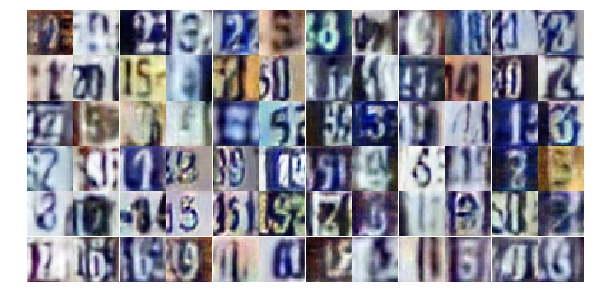

Epoch 13/25... Discriminator Loss: 0.6478... Generator Loss: 0.9932
Epoch 13/25... Discriminator Loss: 0.4091... Generator Loss: 1.7276
Epoch 13/25... Discriminator Loss: 0.8398... Generator Loss: 1.8733
Epoch 13/25... Discriminator Loss: 0.8675... Generator Loss: 0.8049
Epoch 13/25... Discriminator Loss: 0.5994... Generator Loss: 1.1779
Epoch 13/25... Discriminator Loss: 0.8052... Generator Loss: 0.8397
Epoch 13/25... Discriminator Loss: 0.6414... Generator Loss: 1.0965
Epoch 13/25... Discriminator Loss: 1.2128... Generator Loss: 0.5906
Epoch 13/25... Discriminator Loss: 0.7109... Generator Loss: 1.0428
Epoch 13/25... Discriminator Loss: 0.9503... Generator Loss: 0.6596


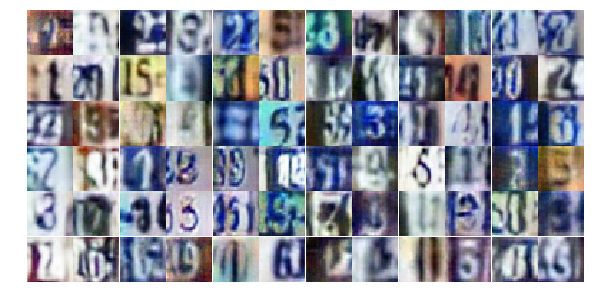

Epoch 13/25... Discriminator Loss: 0.5602... Generator Loss: 1.2358
Epoch 13/25... Discriminator Loss: 0.5186... Generator Loss: 1.2954
Epoch 13/25... Discriminator Loss: 0.6751... Generator Loss: 1.2021
Epoch 13/25... Discriminator Loss: 0.6716... Generator Loss: 1.1549
Epoch 13/25... Discriminator Loss: 0.8051... Generator Loss: 0.8059
Epoch 13/25... Discriminator Loss: 0.9816... Generator Loss: 0.6288
Epoch 13/25... Discriminator Loss: 0.8712... Generator Loss: 1.6328
Epoch 13/25... Discriminator Loss: 0.5577... Generator Loss: 1.3905
Epoch 13/25... Discriminator Loss: 0.4315... Generator Loss: 1.6324
Epoch 13/25... Discriminator Loss: 0.4765... Generator Loss: 1.5654


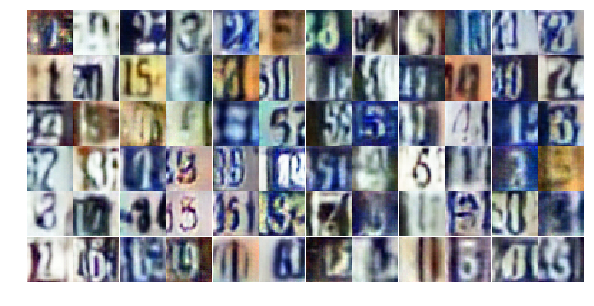

Epoch 13/25... Discriminator Loss: 1.4661... Generator Loss: 0.3651
Epoch 13/25... Discriminator Loss: 1.0566... Generator Loss: 0.6653
Epoch 13/25... Discriminator Loss: 1.6631... Generator Loss: 0.3079
Epoch 13/25... Discriminator Loss: 1.2101... Generator Loss: 0.4901
Epoch 13/25... Discriminator Loss: 0.5612... Generator Loss: 1.1819
Epoch 13/25... Discriminator Loss: 0.3663... Generator Loss: 1.9924
Epoch 13/25... Discriminator Loss: 0.5327... Generator Loss: 1.2022
Epoch 13/25... Discriminator Loss: 0.7086... Generator Loss: 1.1535
Epoch 13/25... Discriminator Loss: 0.6436... Generator Loss: 1.1204
Epoch 13/25... Discriminator Loss: 0.5703... Generator Loss: 1.1506


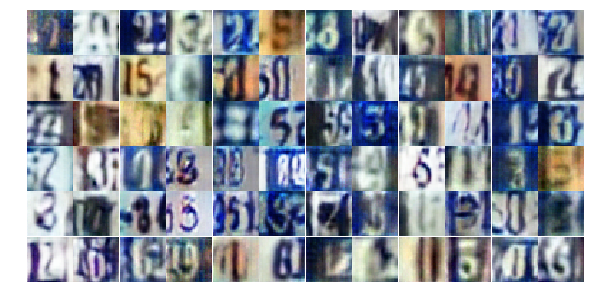

Epoch 13/25... Discriminator Loss: 0.4950... Generator Loss: 1.3116
Epoch 13/25... Discriminator Loss: 0.8346... Generator Loss: 1.0375
Epoch 13/25... Discriminator Loss: 0.8731... Generator Loss: 0.8375
Epoch 13/25... Discriminator Loss: 0.4814... Generator Loss: 1.8775
Epoch 13/25... Discriminator Loss: 0.7739... Generator Loss: 0.8493
Epoch 13/25... Discriminator Loss: 0.4730... Generator Loss: 2.0543
Epoch 13/25... Discriminator Loss: 0.8846... Generator Loss: 0.7042
Epoch 13/25... Discriminator Loss: 0.8588... Generator Loss: 0.8633
Epoch 13/25... Discriminator Loss: 1.2142... Generator Loss: 0.5569
Epoch 13/25... Discriminator Loss: 0.9216... Generator Loss: 0.7054


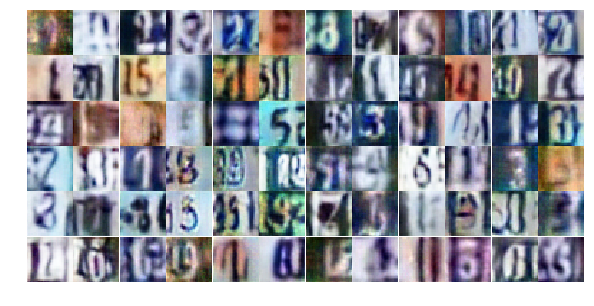

Epoch 13/25... Discriminator Loss: 0.2569... Generator Loss: 2.8445
Epoch 13/25... Discriminator Loss: 1.7570... Generator Loss: 0.2850
Epoch 13/25... Discriminator Loss: 0.7810... Generator Loss: 0.8976
Epoch 13/25... Discriminator Loss: 1.2274... Generator Loss: 0.4508
Epoch 14/25... Discriminator Loss: 1.1438... Generator Loss: 0.5476
Epoch 14/25... Discriminator Loss: 0.7265... Generator Loss: 2.1517
Epoch 14/25... Discriminator Loss: 1.2648... Generator Loss: 0.4834
Epoch 14/25... Discriminator Loss: 0.5087... Generator Loss: 2.2143
Epoch 14/25... Discriminator Loss: 0.6401... Generator Loss: 0.9637
Epoch 14/25... Discriminator Loss: 0.7361... Generator Loss: 0.8435


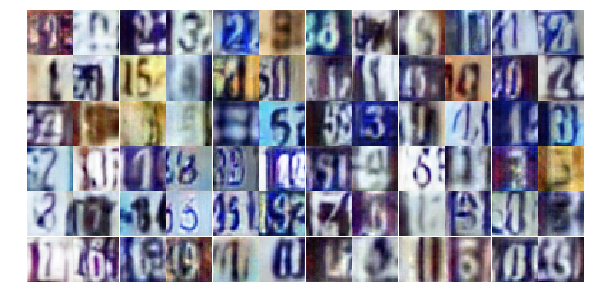

Epoch 14/25... Discriminator Loss: 1.0969... Generator Loss: 3.1275
Epoch 14/25... Discriminator Loss: 1.3465... Generator Loss: 0.4884
Epoch 14/25... Discriminator Loss: 0.9244... Generator Loss: 0.7795
Epoch 14/25... Discriminator Loss: 0.5793... Generator Loss: 1.3535
Epoch 14/25... Discriminator Loss: 0.7045... Generator Loss: 0.9895
Epoch 14/25... Discriminator Loss: 0.3562... Generator Loss: 1.7765
Epoch 14/25... Discriminator Loss: 0.4924... Generator Loss: 1.3708
Epoch 14/25... Discriminator Loss: 1.5202... Generator Loss: 0.3540
Epoch 14/25... Discriminator Loss: 1.2174... Generator Loss: 0.4815
Epoch 14/25... Discriminator Loss: 1.2246... Generator Loss: 0.5167


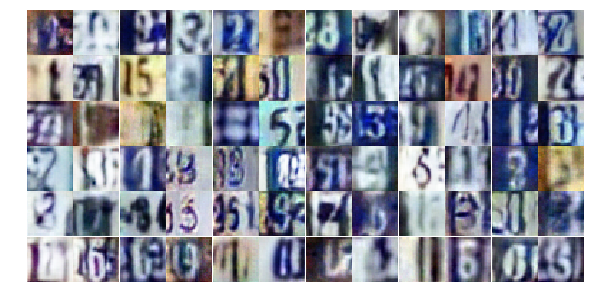

Epoch 14/25... Discriminator Loss: 0.3087... Generator Loss: 1.6943
Epoch 14/25... Discriminator Loss: 1.5034... Generator Loss: 4.4150
Epoch 14/25... Discriminator Loss: 1.0323... Generator Loss: 1.6732
Epoch 14/25... Discriminator Loss: 0.5461... Generator Loss: 1.3151
Epoch 14/25... Discriminator Loss: 1.0255... Generator Loss: 0.6557
Epoch 14/25... Discriminator Loss: 0.6754... Generator Loss: 1.4440
Epoch 14/25... Discriminator Loss: 0.5967... Generator Loss: 1.2021
Epoch 14/25... Discriminator Loss: 0.6597... Generator Loss: 1.0218
Epoch 14/25... Discriminator Loss: 0.5570... Generator Loss: 1.3098
Epoch 14/25... Discriminator Loss: 0.6440... Generator Loss: 1.0177


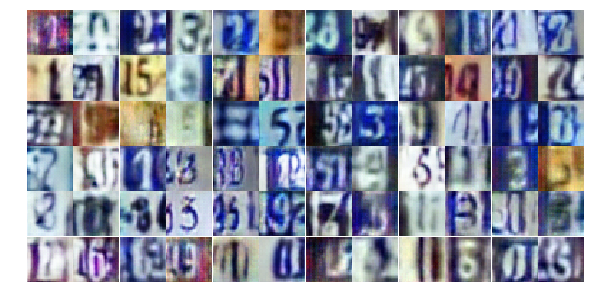

Epoch 14/25... Discriminator Loss: 1.1410... Generator Loss: 0.6015
Epoch 14/25... Discriminator Loss: 0.6781... Generator Loss: 0.9607
Epoch 14/25... Discriminator Loss: 0.5180... Generator Loss: 1.5336
Epoch 14/25... Discriminator Loss: 0.3832... Generator Loss: 1.7323
Epoch 14/25... Discriminator Loss: 0.5962... Generator Loss: 1.1844
Epoch 14/25... Discriminator Loss: 1.0223... Generator Loss: 0.6095
Epoch 14/25... Discriminator Loss: 0.6737... Generator Loss: 1.1516
Epoch 14/25... Discriminator Loss: 0.4477... Generator Loss: 1.3880
Epoch 14/25... Discriminator Loss: 0.4371... Generator Loss: 2.5620
Epoch 14/25... Discriminator Loss: 0.7161... Generator Loss: 0.9448


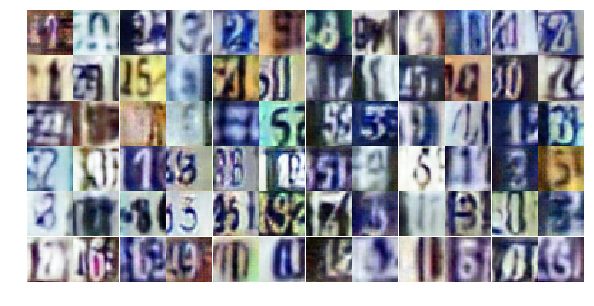

Epoch 14/25... Discriminator Loss: 1.4748... Generator Loss: 0.3716
Epoch 14/25... Discriminator Loss: 0.6329... Generator Loss: 1.3229
Epoch 14/25... Discriminator Loss: 0.6374... Generator Loss: 1.0682
Epoch 14/25... Discriminator Loss: 0.9284... Generator Loss: 0.6956
Epoch 14/25... Discriminator Loss: 0.6662... Generator Loss: 1.5175
Epoch 14/25... Discriminator Loss: 0.6811... Generator Loss: 1.5363
Epoch 14/25... Discriminator Loss: 0.6505... Generator Loss: 1.0615
Epoch 14/25... Discriminator Loss: 0.5192... Generator Loss: 1.2494
Epoch 14/25... Discriminator Loss: 1.2740... Generator Loss: 0.5688
Epoch 14/25... Discriminator Loss: 0.9940... Generator Loss: 0.6453


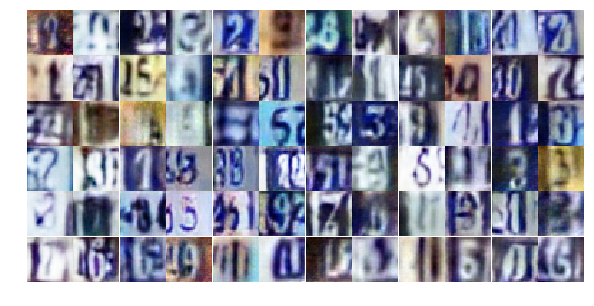

Epoch 14/25... Discriminator Loss: 1.1650... Generator Loss: 2.7289
Epoch 14/25... Discriminator Loss: 1.1243... Generator Loss: 0.6525
Epoch 14/25... Discriminator Loss: 0.6776... Generator Loss: 0.9328
Epoch 14/25... Discriminator Loss: 1.2043... Generator Loss: 0.5602
Epoch 14/25... Discriminator Loss: 0.5152... Generator Loss: 1.4494
Epoch 14/25... Discriminator Loss: 0.7021... Generator Loss: 0.9375
Epoch 14/25... Discriminator Loss: 0.6356... Generator Loss: 1.1114
Epoch 14/25... Discriminator Loss: 0.8344... Generator Loss: 0.8641
Epoch 14/25... Discriminator Loss: 0.7643... Generator Loss: 2.7152
Epoch 14/25... Discriminator Loss: 1.5194... Generator Loss: 0.3683


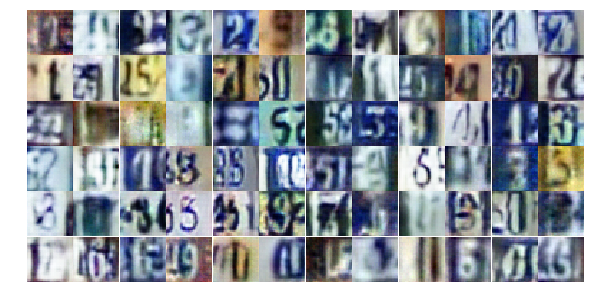

Epoch 14/25... Discriminator Loss: 1.7892... Generator Loss: 0.3069
Epoch 14/25... Discriminator Loss: 0.9657... Generator Loss: 0.7606
Epoch 15/25... Discriminator Loss: 0.5980... Generator Loss: 1.3308
Epoch 15/25... Discriminator Loss: 0.5618... Generator Loss: 1.4382
Epoch 15/25... Discriminator Loss: 0.5622... Generator Loss: 1.1703
Epoch 15/25... Discriminator Loss: 0.9435... Generator Loss: 0.7264
Epoch 15/25... Discriminator Loss: 0.6577... Generator Loss: 1.0523
Epoch 15/25... Discriminator Loss: 0.7048... Generator Loss: 0.9481
Epoch 15/25... Discriminator Loss: 1.2744... Generator Loss: 0.4925
Epoch 15/25... Discriminator Loss: 0.6150... Generator Loss: 1.1550


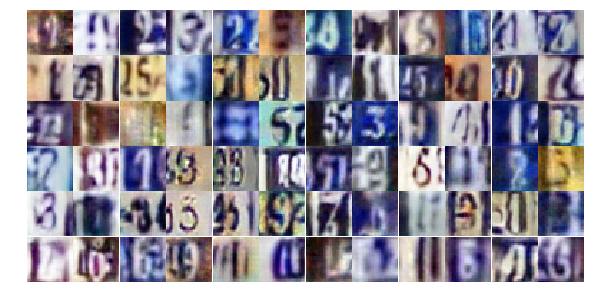

Epoch 15/25... Discriminator Loss: 0.8102... Generator Loss: 0.8445
Epoch 15/25... Discriminator Loss: 0.6993... Generator Loss: 2.1719
Epoch 15/25... Discriminator Loss: 0.7397... Generator Loss: 0.9675
Epoch 15/25... Discriminator Loss: 0.7229... Generator Loss: 1.6471
Epoch 15/25... Discriminator Loss: 1.1306... Generator Loss: 0.7029
Epoch 15/25... Discriminator Loss: 0.4832... Generator Loss: 1.7617
Epoch 15/25... Discriminator Loss: 1.3536... Generator Loss: 0.4308
Epoch 15/25... Discriminator Loss: 0.6279... Generator Loss: 1.2106
Epoch 15/25... Discriminator Loss: 0.4698... Generator Loss: 2.1381
Epoch 15/25... Discriminator Loss: 1.3164... Generator Loss: 0.4541


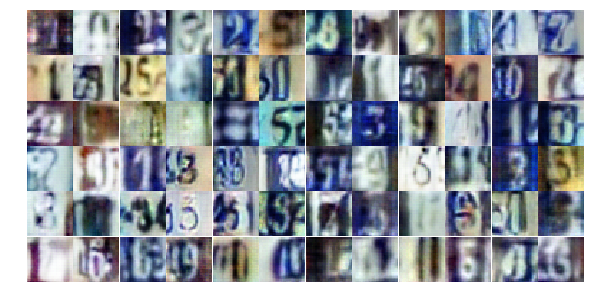

Epoch 15/25... Discriminator Loss: 1.3737... Generator Loss: 0.5089
Epoch 15/25... Discriminator Loss: 0.5535... Generator Loss: 1.3184
Epoch 15/25... Discriminator Loss: 0.6316... Generator Loss: 1.4391
Epoch 15/25... Discriminator Loss: 0.6776... Generator Loss: 0.9930
Epoch 15/25... Discriminator Loss: 0.8814... Generator Loss: 0.8255
Epoch 15/25... Discriminator Loss: 0.4554... Generator Loss: 1.5093
Epoch 15/25... Discriminator Loss: 1.0733... Generator Loss: 0.7273
Epoch 15/25... Discriminator Loss: 0.9843... Generator Loss: 0.7016
Epoch 15/25... Discriminator Loss: 0.3830... Generator Loss: 2.1561
Epoch 15/25... Discriminator Loss: 1.6160... Generator Loss: 0.3531


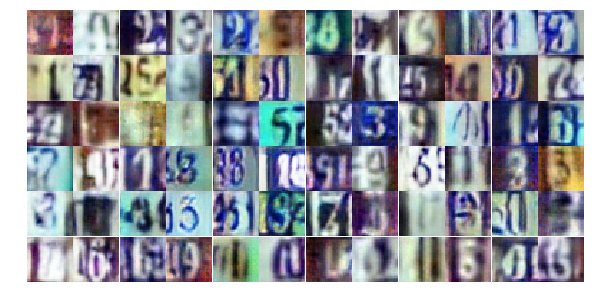

Epoch 15/25... Discriminator Loss: 0.7275... Generator Loss: 1.0061
Epoch 15/25... Discriminator Loss: 1.2570... Generator Loss: 0.5748
Epoch 15/25... Discriminator Loss: 0.4715... Generator Loss: 1.5894
Epoch 15/25... Discriminator Loss: 0.6982... Generator Loss: 1.0649
Epoch 15/25... Discriminator Loss: 0.4572... Generator Loss: 1.6193
Epoch 15/25... Discriminator Loss: 2.0959... Generator Loss: 3.9667
Epoch 15/25... Discriminator Loss: 1.4381... Generator Loss: 0.4712
Epoch 15/25... Discriminator Loss: 0.8136... Generator Loss: 0.7925
Epoch 15/25... Discriminator Loss: 0.6374... Generator Loss: 1.1297
Epoch 15/25... Discriminator Loss: 0.9222... Generator Loss: 0.7108


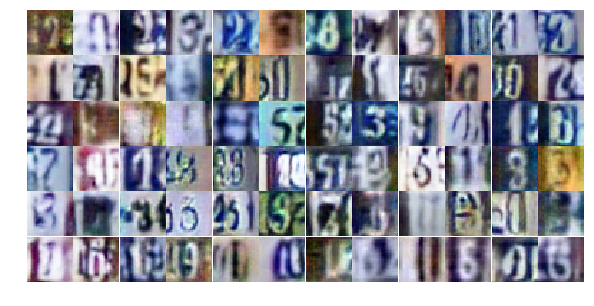

Epoch 15/25... Discriminator Loss: 0.6923... Generator Loss: 1.0488
Epoch 15/25... Discriminator Loss: 1.2379... Generator Loss: 0.4695
Epoch 15/25... Discriminator Loss: 0.6999... Generator Loss: 1.0690
Epoch 15/25... Discriminator Loss: 0.4413... Generator Loss: 1.5424
Epoch 15/25... Discriminator Loss: 0.6144... Generator Loss: 1.1381
Epoch 15/25... Discriminator Loss: 2.1210... Generator Loss: 0.2310
Epoch 15/25... Discriminator Loss: 0.6220... Generator Loss: 1.2852
Epoch 15/25... Discriminator Loss: 0.6920... Generator Loss: 1.0513
Epoch 15/25... Discriminator Loss: 0.7063... Generator Loss: 0.9911
Epoch 15/25... Discriminator Loss: 0.8497... Generator Loss: 0.8795


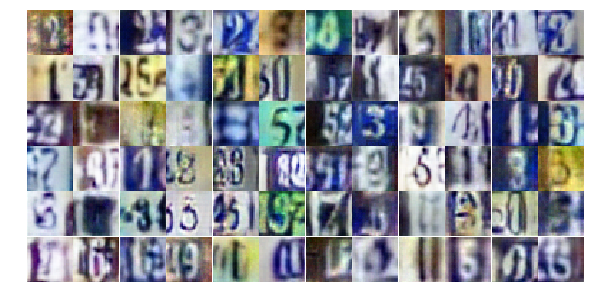

Epoch 15/25... Discriminator Loss: 0.9316... Generator Loss: 0.6742
Epoch 15/25... Discriminator Loss: 0.8469... Generator Loss: 0.8250
Epoch 15/25... Discriminator Loss: 0.4732... Generator Loss: 1.3107
Epoch 15/25... Discriminator Loss: 0.7466... Generator Loss: 1.3111
Epoch 15/25... Discriminator Loss: 0.4633... Generator Loss: 1.3559
Epoch 15/25... Discriminator Loss: 0.7165... Generator Loss: 1.7056
Epoch 15/25... Discriminator Loss: 0.7030... Generator Loss: 1.1861
Epoch 15/25... Discriminator Loss: 0.5657... Generator Loss: 1.3278
Epoch 15/25... Discriminator Loss: 1.6568... Generator Loss: 0.2881
Epoch 16/25... Discriminator Loss: 1.3883... Generator Loss: 0.4934


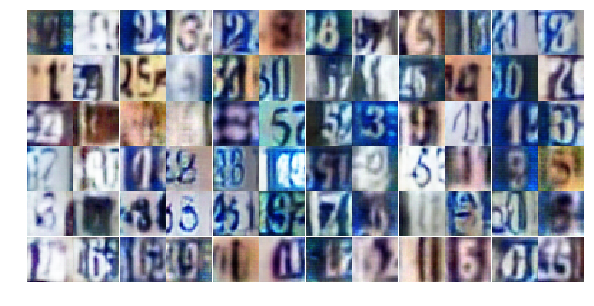

Epoch 16/25... Discriminator Loss: 0.7812... Generator Loss: 0.9816
Epoch 16/25... Discriminator Loss: 0.8245... Generator Loss: 0.8475
Epoch 16/25... Discriminator Loss: 1.1431... Generator Loss: 0.5195
Epoch 16/25... Discriminator Loss: 0.9290... Generator Loss: 0.7569
Epoch 16/25... Discriminator Loss: 0.6365... Generator Loss: 1.5310
Epoch 16/25... Discriminator Loss: 0.5530... Generator Loss: 1.8843
Epoch 16/25... Discriminator Loss: 1.7721... Generator Loss: 0.2550
Epoch 16/25... Discriminator Loss: 0.8774... Generator Loss: 0.7453
Epoch 16/25... Discriminator Loss: 0.7293... Generator Loss: 0.9732
Epoch 16/25... Discriminator Loss: 0.6678... Generator Loss: 0.9764


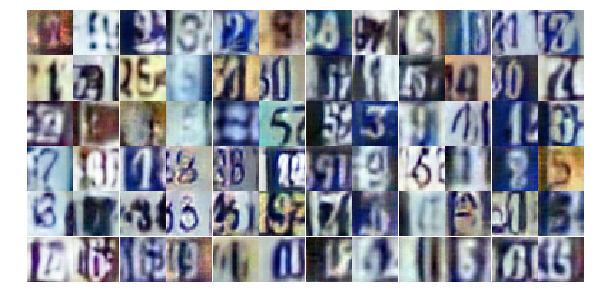

Epoch 16/25... Discriminator Loss: 1.2688... Generator Loss: 0.4783
Epoch 16/25... Discriminator Loss: 0.5956... Generator Loss: 1.1926
Epoch 16/25... Discriminator Loss: 0.6935... Generator Loss: 1.0819
Epoch 16/25... Discriminator Loss: 1.4316... Generator Loss: 0.4008
Epoch 16/25... Discriminator Loss: 1.0400... Generator Loss: 1.4936
Epoch 16/25... Discriminator Loss: 0.7658... Generator Loss: 1.0289
Epoch 16/25... Discriminator Loss: 0.8801... Generator Loss: 0.9987
Epoch 16/25... Discriminator Loss: 0.2687... Generator Loss: 2.1664
Epoch 16/25... Discriminator Loss: 0.7523... Generator Loss: 0.9439
Epoch 16/25... Discriminator Loss: 0.8081... Generator Loss: 2.3876


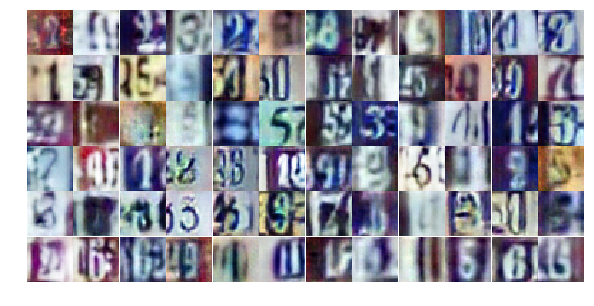

Epoch 16/25... Discriminator Loss: 0.9527... Generator Loss: 0.7426
Epoch 16/25... Discriminator Loss: 1.7042... Generator Loss: 4.5754
Epoch 16/25... Discriminator Loss: 1.1535... Generator Loss: 0.5863
Epoch 16/25... Discriminator Loss: 0.8800... Generator Loss: 0.8625
Epoch 16/25... Discriminator Loss: 0.6281... Generator Loss: 1.3748
Epoch 16/25... Discriminator Loss: 0.7371... Generator Loss: 1.1135
Epoch 16/25... Discriminator Loss: 0.9696... Generator Loss: 0.6845
Epoch 16/25... Discriminator Loss: 0.7133... Generator Loss: 1.0177
Epoch 16/25... Discriminator Loss: 0.9389... Generator Loss: 0.7331
Epoch 16/25... Discriminator Loss: 0.5882... Generator Loss: 1.3954


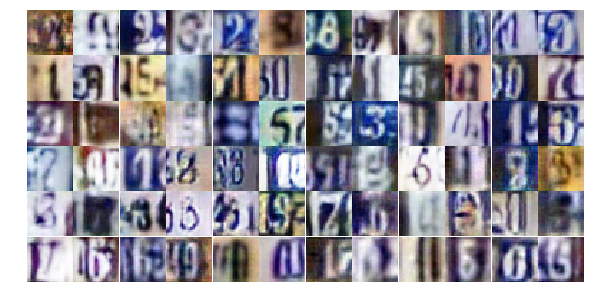

Epoch 16/25... Discriminator Loss: 0.6802... Generator Loss: 0.9959
Epoch 16/25... Discriminator Loss: 0.5053... Generator Loss: 1.5561
Epoch 16/25... Discriminator Loss: 0.6286... Generator Loss: 1.0776
Epoch 16/25... Discriminator Loss: 0.5807... Generator Loss: 2.3497
Epoch 16/25... Discriminator Loss: 1.0062... Generator Loss: 0.7950
Epoch 16/25... Discriminator Loss: 0.7923... Generator Loss: 1.3019
Epoch 16/25... Discriminator Loss: 1.0546... Generator Loss: 0.6097
Epoch 16/25... Discriminator Loss: 1.2184... Generator Loss: 0.4961
Epoch 16/25... Discriminator Loss: 0.8198... Generator Loss: 0.8809
Epoch 16/25... Discriminator Loss: 0.4785... Generator Loss: 1.3623


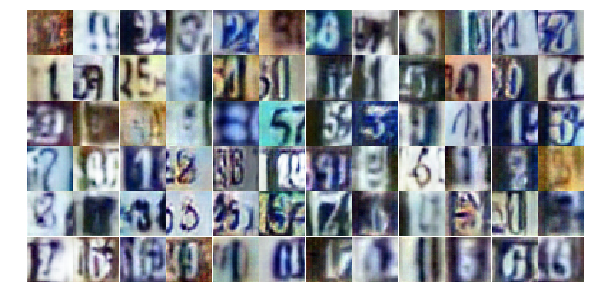

Epoch 16/25... Discriminator Loss: 0.5937... Generator Loss: 1.1520
Epoch 16/25... Discriminator Loss: 0.8607... Generator Loss: 0.8404
Epoch 16/25... Discriminator Loss: 1.5008... Generator Loss: 0.3883
Epoch 16/25... Discriminator Loss: 1.1546... Generator Loss: 0.6698
Epoch 16/25... Discriminator Loss: 0.8120... Generator Loss: 1.0198
Epoch 16/25... Discriminator Loss: 0.8553... Generator Loss: 0.8217
Epoch 16/25... Discriminator Loss: 0.4128... Generator Loss: 1.5605
Epoch 16/25... Discriminator Loss: 0.9145... Generator Loss: 0.7306
Epoch 16/25... Discriminator Loss: 0.4350... Generator Loss: 1.4544
Epoch 16/25... Discriminator Loss: 0.9284... Generator Loss: 0.6989


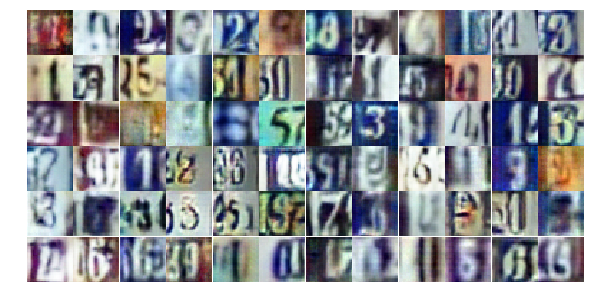

Epoch 16/25... Discriminator Loss: 0.8187... Generator Loss: 0.8786
Epoch 16/25... Discriminator Loss: 0.5562... Generator Loss: 1.9590
Epoch 16/25... Discriminator Loss: 1.5399... Generator Loss: 0.4731
Epoch 16/25... Discriminator Loss: 0.3917... Generator Loss: 1.8414
Epoch 16/25... Discriminator Loss: 0.4168... Generator Loss: 1.6679
Epoch 16/25... Discriminator Loss: 0.6099... Generator Loss: 1.2366
Epoch 17/25... Discriminator Loss: 0.4578... Generator Loss: 1.7224
Epoch 17/25... Discriminator Loss: 0.9755... Generator Loss: 0.6901
Epoch 17/25... Discriminator Loss: 0.5441... Generator Loss: 1.2912
Epoch 17/25... Discriminator Loss: 0.6697... Generator Loss: 1.0994


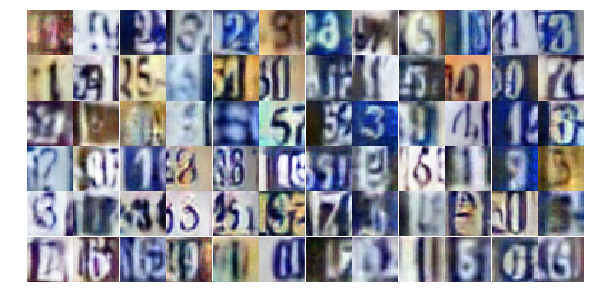

Epoch 17/25... Discriminator Loss: 0.3769... Generator Loss: 1.7088
Epoch 17/25... Discriminator Loss: 0.6553... Generator Loss: 0.9798
Epoch 17/25... Discriminator Loss: 0.5273... Generator Loss: 1.4196
Epoch 17/25... Discriminator Loss: 0.7940... Generator Loss: 0.8781
Epoch 17/25... Discriminator Loss: 0.6026... Generator Loss: 1.4644
Epoch 17/25... Discriminator Loss: 1.0469... Generator Loss: 0.6564
Epoch 17/25... Discriminator Loss: 0.9379... Generator Loss: 0.7545
Epoch 17/25... Discriminator Loss: 0.6140... Generator Loss: 1.0653
Epoch 17/25... Discriminator Loss: 0.3352... Generator Loss: 1.9101
Epoch 17/25... Discriminator Loss: 0.8618... Generator Loss: 3.2204


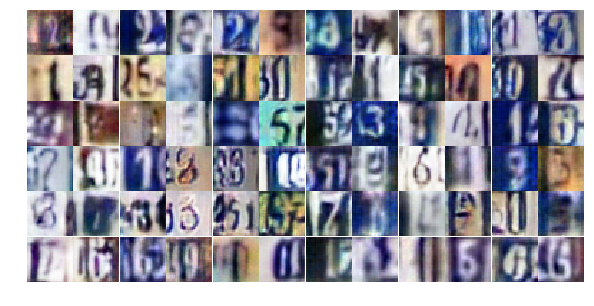

Epoch 17/25... Discriminator Loss: 2.5405... Generator Loss: 4.0342
Epoch 17/25... Discriminator Loss: 0.9154... Generator Loss: 1.8026
Epoch 17/25... Discriminator Loss: 0.6835... Generator Loss: 1.1143
Epoch 17/25... Discriminator Loss: 1.0816... Generator Loss: 0.6245
Epoch 17/25... Discriminator Loss: 0.5050... Generator Loss: 1.6200
Epoch 17/25... Discriminator Loss: 0.9980... Generator Loss: 0.6943
Epoch 17/25... Discriminator Loss: 0.7128... Generator Loss: 1.1555
Epoch 17/25... Discriminator Loss: 0.4246... Generator Loss: 1.5047
Epoch 17/25... Discriminator Loss: 0.6667... Generator Loss: 1.0370
Epoch 17/25... Discriminator Loss: 0.6199... Generator Loss: 1.1501


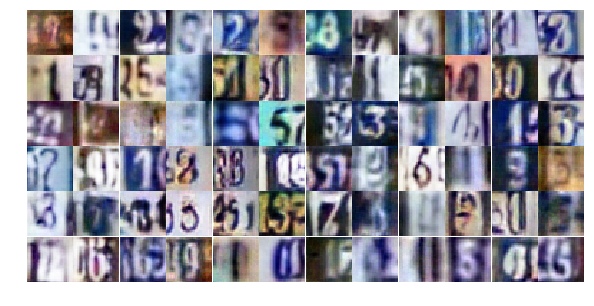

Epoch 17/25... Discriminator Loss: 1.7628... Generator Loss: 0.3073
Epoch 17/25... Discriminator Loss: 0.4438... Generator Loss: 1.6833
Epoch 17/25... Discriminator Loss: 0.4926... Generator Loss: 1.3426
Epoch 17/25... Discriminator Loss: 1.1898... Generator Loss: 0.5485
Epoch 17/25... Discriminator Loss: 1.6407... Generator Loss: 0.3246
Epoch 17/25... Discriminator Loss: 0.6375... Generator Loss: 1.1105
Epoch 17/25... Discriminator Loss: 0.8793... Generator Loss: 0.7821
Epoch 17/25... Discriminator Loss: 1.3076... Generator Loss: 0.4615
Epoch 17/25... Discriminator Loss: 0.7885... Generator Loss: 0.9139
Epoch 17/25... Discriminator Loss: 0.3856... Generator Loss: 1.5698


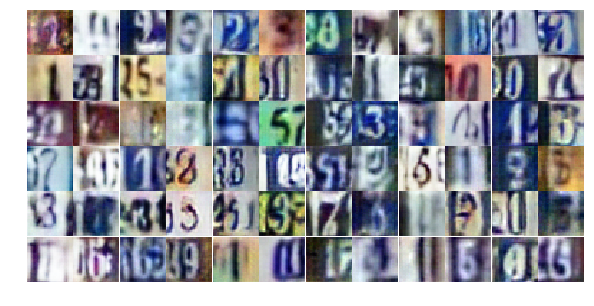

Epoch 17/25... Discriminator Loss: 0.7427... Generator Loss: 1.0256
Epoch 17/25... Discriminator Loss: 1.6292... Generator Loss: 0.3142
Epoch 17/25... Discriminator Loss: 0.8675... Generator Loss: 2.6831
Epoch 17/25... Discriminator Loss: 0.9637... Generator Loss: 0.7210
Epoch 17/25... Discriminator Loss: 1.0133... Generator Loss: 0.6612
Epoch 17/25... Discriminator Loss: 0.6428... Generator Loss: 1.0894
Epoch 17/25... Discriminator Loss: 0.7549... Generator Loss: 0.9272
Epoch 17/25... Discriminator Loss: 0.5098... Generator Loss: 1.9026
Epoch 17/25... Discriminator Loss: 0.2810... Generator Loss: 2.4177
Epoch 17/25... Discriminator Loss: 0.9360... Generator Loss: 0.7525


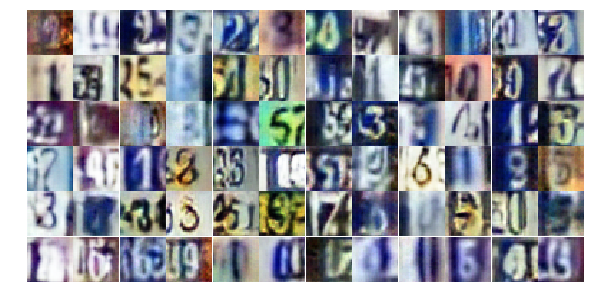

Epoch 17/25... Discriminator Loss: 0.8780... Generator Loss: 0.9194
Epoch 17/25... Discriminator Loss: 0.4080... Generator Loss: 1.3829
Epoch 17/25... Discriminator Loss: 0.6886... Generator Loss: 1.3939
Epoch 17/25... Discriminator Loss: 0.5754... Generator Loss: 1.1458
Epoch 17/25... Discriminator Loss: 0.7549... Generator Loss: 0.9292
Epoch 17/25... Discriminator Loss: 0.6986... Generator Loss: 1.3669
Epoch 17/25... Discriminator Loss: 1.8354... Generator Loss: 0.2674
Epoch 17/25... Discriminator Loss: 0.5642... Generator Loss: 1.1615
Epoch 17/25... Discriminator Loss: 0.8142... Generator Loss: 0.8499
Epoch 17/25... Discriminator Loss: 1.6951... Generator Loss: 0.3392


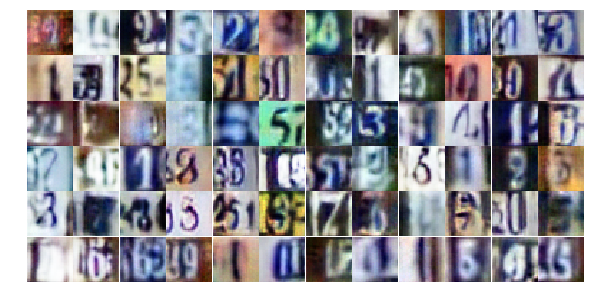

Epoch 17/25... Discriminator Loss: 1.1727... Generator Loss: 0.6652
Epoch 17/25... Discriminator Loss: 0.6750... Generator Loss: 1.0644
Epoch 17/25... Discriminator Loss: 0.3504... Generator Loss: 2.0302
Epoch 17/25... Discriminator Loss: 0.4733... Generator Loss: 1.4193
Epoch 18/25... Discriminator Loss: 0.8790... Generator Loss: 0.7904
Epoch 18/25... Discriminator Loss: 1.0326... Generator Loss: 0.5743
Epoch 18/25... Discriminator Loss: 0.9239... Generator Loss: 0.7101
Epoch 18/25... Discriminator Loss: 1.0887... Generator Loss: 0.5583
Epoch 18/25... Discriminator Loss: 0.8411... Generator Loss: 0.9346
Epoch 18/25... Discriminator Loss: 0.6564... Generator Loss: 1.0508


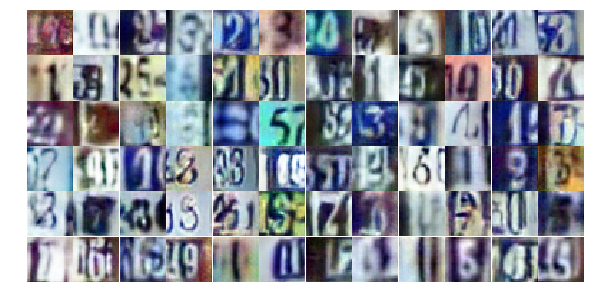

Epoch 18/25... Discriminator Loss: 0.3133... Generator Loss: 1.8691
Epoch 18/25... Discriminator Loss: 1.1167... Generator Loss: 0.5805
Epoch 18/25... Discriminator Loss: 1.0957... Generator Loss: 0.5682
Epoch 18/25... Discriminator Loss: 0.5477... Generator Loss: 1.4317
Epoch 18/25... Discriminator Loss: 0.7165... Generator Loss: 0.9967
Epoch 18/25... Discriminator Loss: 0.9567... Generator Loss: 0.7245
Epoch 18/25... Discriminator Loss: 0.3633... Generator Loss: 1.8138
Epoch 18/25... Discriminator Loss: 0.8003... Generator Loss: 0.8690
Epoch 18/25... Discriminator Loss: 0.6255... Generator Loss: 1.1258
Epoch 18/25... Discriminator Loss: 0.4365... Generator Loss: 1.4222


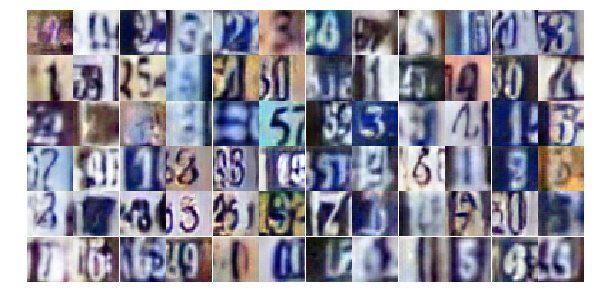

Epoch 18/25... Discriminator Loss: 0.8188... Generator Loss: 0.9860
Epoch 18/25... Discriminator Loss: 0.6153... Generator Loss: 2.1040
Epoch 18/25... Discriminator Loss: 0.8513... Generator Loss: 0.9026
Epoch 18/25... Discriminator Loss: 0.4850... Generator Loss: 1.3320
Epoch 18/25... Discriminator Loss: 1.2493... Generator Loss: 0.4810
Epoch 18/25... Discriminator Loss: 0.5804... Generator Loss: 1.3270
Epoch 18/25... Discriminator Loss: 0.7434... Generator Loss: 1.8182
Epoch 18/25... Discriminator Loss: 1.2778... Generator Loss: 0.4810
Epoch 18/25... Discriminator Loss: 0.3425... Generator Loss: 1.7958
Epoch 18/25... Discriminator Loss: 0.7699... Generator Loss: 0.9240


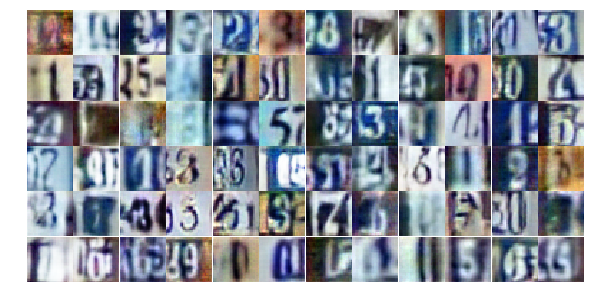

Epoch 18/25... Discriminator Loss: 0.4126... Generator Loss: 1.8659
Epoch 18/25... Discriminator Loss: 0.8430... Generator Loss: 0.8136
Epoch 18/25... Discriminator Loss: 0.6842... Generator Loss: 1.0379
Epoch 18/25... Discriminator Loss: 0.5168... Generator Loss: 2.1147
Epoch 18/25... Discriminator Loss: 1.0366... Generator Loss: 0.6130
Epoch 18/25... Discriminator Loss: 0.8893... Generator Loss: 0.7376
Epoch 18/25... Discriminator Loss: 0.8427... Generator Loss: 0.7973
Epoch 18/25... Discriminator Loss: 1.8585... Generator Loss: 0.3601
Epoch 18/25... Discriminator Loss: 0.4909... Generator Loss: 1.4143
Epoch 18/25... Discriminator Loss: 0.6034... Generator Loss: 1.2573


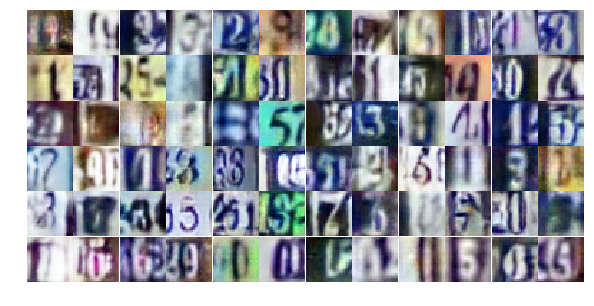

Epoch 18/25... Discriminator Loss: 0.6758... Generator Loss: 1.2845
Epoch 18/25... Discriminator Loss: 0.8805... Generator Loss: 0.8458
Epoch 18/25... Discriminator Loss: 0.5458... Generator Loss: 1.1434
Epoch 18/25... Discriminator Loss: 0.6332... Generator Loss: 1.0650
Epoch 18/25... Discriminator Loss: 0.8852... Generator Loss: 0.8144
Epoch 18/25... Discriminator Loss: 0.4943... Generator Loss: 1.2433
Epoch 18/25... Discriminator Loss: 0.9410... Generator Loss: 0.7337
Epoch 18/25... Discriminator Loss: 1.2357... Generator Loss: 0.5778
Epoch 18/25... Discriminator Loss: 0.6469... Generator Loss: 1.3212
Epoch 18/25... Discriminator Loss: 0.3258... Generator Loss: 1.8818


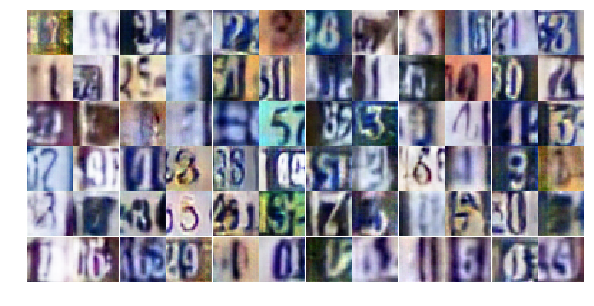

Epoch 18/25... Discriminator Loss: 0.6954... Generator Loss: 1.0103
Epoch 18/25... Discriminator Loss: 0.7291... Generator Loss: 0.9323
Epoch 18/25... Discriminator Loss: 0.6686... Generator Loss: 1.4307
Epoch 18/25... Discriminator Loss: 1.9306... Generator Loss: 4.5944
Epoch 18/25... Discriminator Loss: 0.8751... Generator Loss: 2.1536
Epoch 18/25... Discriminator Loss: 0.8478... Generator Loss: 0.8262
Epoch 18/25... Discriminator Loss: 0.4764... Generator Loss: 1.7040
Epoch 18/25... Discriminator Loss: 0.4662... Generator Loss: 1.5648
Epoch 18/25... Discriminator Loss: 0.8556... Generator Loss: 0.8196
Epoch 18/25... Discriminator Loss: 0.8199... Generator Loss: 0.8113


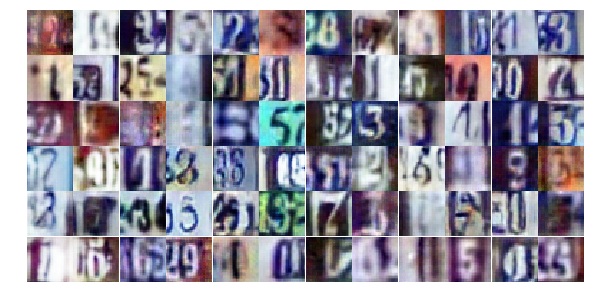

Epoch 18/25... Discriminator Loss: 0.7736... Generator Loss: 2.2610
Epoch 19/25... Discriminator Loss: 1.1818... Generator Loss: 2.3646
Epoch 19/25... Discriminator Loss: 1.0322... Generator Loss: 0.6757
Epoch 19/25... Discriminator Loss: 0.8839... Generator Loss: 0.7806
Epoch 19/25... Discriminator Loss: 0.7043... Generator Loss: 0.9857
Epoch 19/25... Discriminator Loss: 1.3321... Generator Loss: 0.4352
Epoch 19/25... Discriminator Loss: 0.5700... Generator Loss: 1.3502
Epoch 19/25... Discriminator Loss: 1.1213... Generator Loss: 0.5828
Epoch 19/25... Discriminator Loss: 0.6242... Generator Loss: 1.1248
Epoch 19/25... Discriminator Loss: 0.7737... Generator Loss: 0.9344


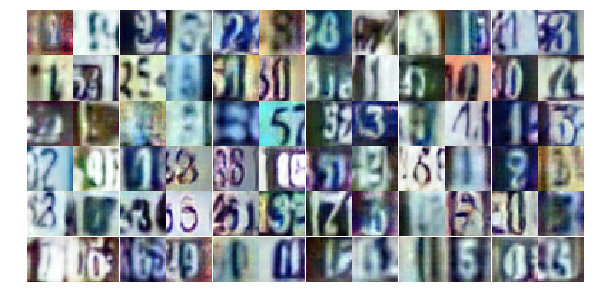

Epoch 19/25... Discriminator Loss: 0.5508... Generator Loss: 1.1745
Epoch 19/25... Discriminator Loss: 0.9462... Generator Loss: 0.6734
Epoch 19/25... Discriminator Loss: 0.7269... Generator Loss: 1.1746
Epoch 19/25... Discriminator Loss: 0.7711... Generator Loss: 0.9144
Epoch 19/25... Discriminator Loss: 0.8183... Generator Loss: 0.7785
Epoch 19/25... Discriminator Loss: 0.5724... Generator Loss: 1.6899
Epoch 19/25... Discriminator Loss: 2.3122... Generator Loss: 0.2166
Epoch 19/25... Discriminator Loss: 0.7076... Generator Loss: 1.2169
Epoch 19/25... Discriminator Loss: 0.6865... Generator Loss: 1.7443
Epoch 19/25... Discriminator Loss: 0.6364... Generator Loss: 1.1922


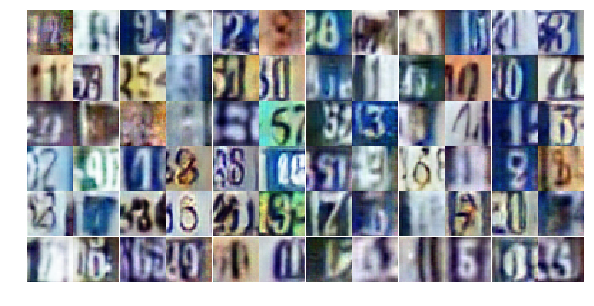

Epoch 19/25... Discriminator Loss: 0.6329... Generator Loss: 1.0684
Epoch 19/25... Discriminator Loss: 1.1718... Generator Loss: 0.5537
Epoch 19/25... Discriminator Loss: 1.4260... Generator Loss: 0.4124
Epoch 19/25... Discriminator Loss: 0.8489... Generator Loss: 0.9344
Epoch 19/25... Discriminator Loss: 0.8988... Generator Loss: 0.8497
Epoch 19/25... Discriminator Loss: 0.8897... Generator Loss: 1.0081
Epoch 19/25... Discriminator Loss: 0.7671... Generator Loss: 0.9113
Epoch 19/25... Discriminator Loss: 0.5357... Generator Loss: 1.1944
Epoch 19/25... Discriminator Loss: 0.5098... Generator Loss: 1.2688
Epoch 19/25... Discriminator Loss: 1.2887... Generator Loss: 0.5008


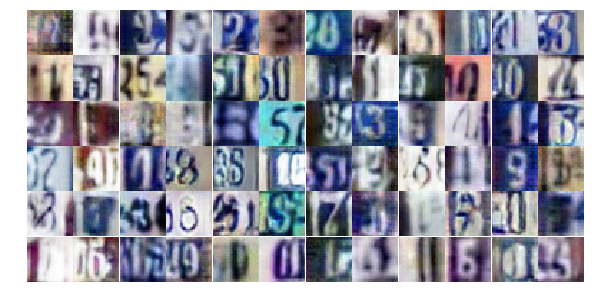

Epoch 19/25... Discriminator Loss: 0.7254... Generator Loss: 1.2192
Epoch 19/25... Discriminator Loss: 1.1042... Generator Loss: 0.6772
Epoch 19/25... Discriminator Loss: 0.9302... Generator Loss: 0.6993
Epoch 19/25... Discriminator Loss: 0.7404... Generator Loss: 0.9597
Epoch 19/25... Discriminator Loss: 0.4840... Generator Loss: 1.5076
Epoch 19/25... Discriminator Loss: 1.6052... Generator Loss: 0.3375
Epoch 19/25... Discriminator Loss: 0.6381... Generator Loss: 1.3173
Epoch 19/25... Discriminator Loss: 0.4671... Generator Loss: 1.9199
Epoch 19/25... Discriminator Loss: 0.7434... Generator Loss: 1.0370
Epoch 19/25... Discriminator Loss: 0.9133... Generator Loss: 0.7076


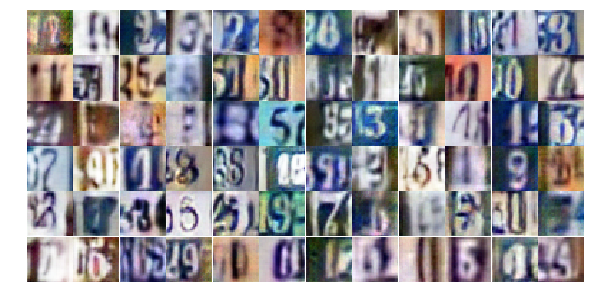

Epoch 19/25... Discriminator Loss: 0.6483... Generator Loss: 1.0509
Epoch 19/25... Discriminator Loss: 1.0067... Generator Loss: 0.6855
Epoch 19/25... Discriminator Loss: 0.8641... Generator Loss: 0.7916
Epoch 19/25... Discriminator Loss: 0.8030... Generator Loss: 0.8585
Epoch 19/25... Discriminator Loss: 0.6336... Generator Loss: 1.9754
Epoch 19/25... Discriminator Loss: 1.0176... Generator Loss: 0.6445
Epoch 19/25... Discriminator Loss: 0.6213... Generator Loss: 2.0832
Epoch 19/25... Discriminator Loss: 0.5509... Generator Loss: 1.1946
Epoch 19/25... Discriminator Loss: 0.4080... Generator Loss: 1.8118
Epoch 19/25... Discriminator Loss: 0.9509... Generator Loss: 0.7198


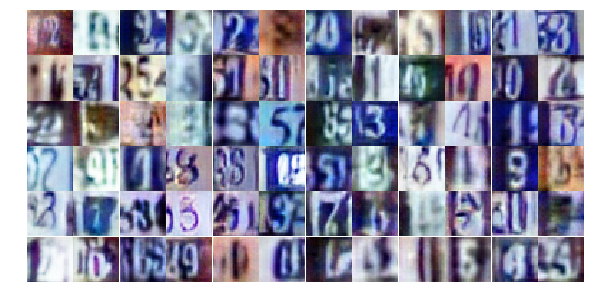

Epoch 19/25... Discriminator Loss: 0.7808... Generator Loss: 0.8722
Epoch 19/25... Discriminator Loss: 0.9146... Generator Loss: 0.7086
Epoch 19/25... Discriminator Loss: 0.4973... Generator Loss: 1.5208
Epoch 19/25... Discriminator Loss: 0.7938... Generator Loss: 1.3097
Epoch 19/25... Discriminator Loss: 1.0398... Generator Loss: 0.6455
Epoch 19/25... Discriminator Loss: 0.6894... Generator Loss: 1.1591
Epoch 19/25... Discriminator Loss: 1.4395... Generator Loss: 0.4284
Epoch 19/25... Discriminator Loss: 0.6677... Generator Loss: 1.1138
Epoch 20/25... Discriminator Loss: 0.9563... Generator Loss: 0.7301
Epoch 20/25... Discriminator Loss: 0.7680... Generator Loss: 0.9052


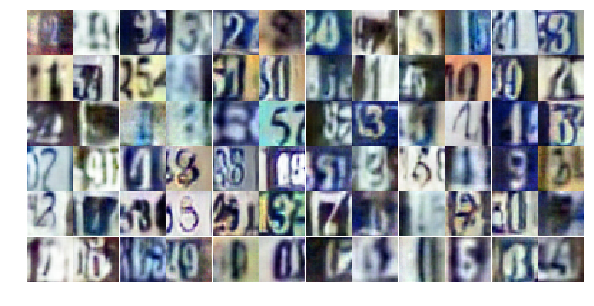

Epoch 20/25... Discriminator Loss: 0.5376... Generator Loss: 1.1868
Epoch 20/25... Discriminator Loss: 0.7618... Generator Loss: 0.9856
Epoch 20/25... Discriminator Loss: 1.5266... Generator Loss: 0.3718
Epoch 20/25... Discriminator Loss: 1.8504... Generator Loss: 0.2888
Epoch 20/25... Discriminator Loss: 0.5192... Generator Loss: 1.2799
Epoch 20/25... Discriminator Loss: 0.6158... Generator Loss: 1.2244
Epoch 20/25... Discriminator Loss: 0.7374... Generator Loss: 0.9308
Epoch 20/25... Discriminator Loss: 1.0402... Generator Loss: 0.7091
Epoch 20/25... Discriminator Loss: 0.7852... Generator Loss: 0.9526
Epoch 20/25... Discriminator Loss: 0.4962... Generator Loss: 1.3342


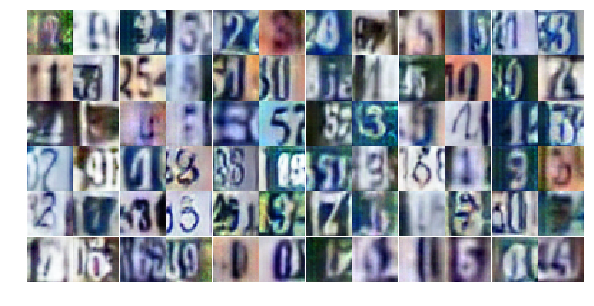

Epoch 20/25... Discriminator Loss: 1.1927... Generator Loss: 0.6132
Epoch 20/25... Discriminator Loss: 1.4133... Generator Loss: 0.4382
Epoch 20/25... Discriminator Loss: 1.8809... Generator Loss: 0.2927
Epoch 20/25... Discriminator Loss: 0.8861... Generator Loss: 0.8330
Epoch 20/25... Discriminator Loss: 1.2790... Generator Loss: 0.5640
Epoch 20/25... Discriminator Loss: 0.8826... Generator Loss: 0.9491
Epoch 20/25... Discriminator Loss: 1.2231... Generator Loss: 0.5208
Epoch 20/25... Discriminator Loss: 0.6629... Generator Loss: 1.0789
Epoch 20/25... Discriminator Loss: 0.6265... Generator Loss: 1.1123
Epoch 20/25... Discriminator Loss: 0.9264... Generator Loss: 0.6843


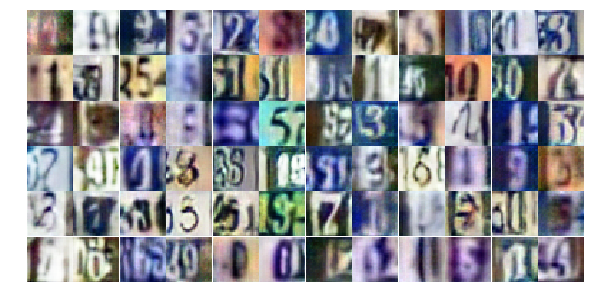

Epoch 20/25... Discriminator Loss: 0.4989... Generator Loss: 1.3110
Epoch 20/25... Discriminator Loss: 0.6552... Generator Loss: 1.0903
Epoch 20/25... Discriminator Loss: 0.4062... Generator Loss: 1.4359
Epoch 20/25... Discriminator Loss: 1.5304... Generator Loss: 0.3884
Epoch 20/25... Discriminator Loss: 1.9617... Generator Loss: 0.2322
Epoch 20/25... Discriminator Loss: 0.3445... Generator Loss: 1.7850
Epoch 20/25... Discriminator Loss: 0.5576... Generator Loss: 2.3290
Epoch 20/25... Discriminator Loss: 1.9362... Generator Loss: 0.2314
Epoch 20/25... Discriminator Loss: 1.1489... Generator Loss: 0.5613
Epoch 20/25... Discriminator Loss: 0.3741... Generator Loss: 1.5424


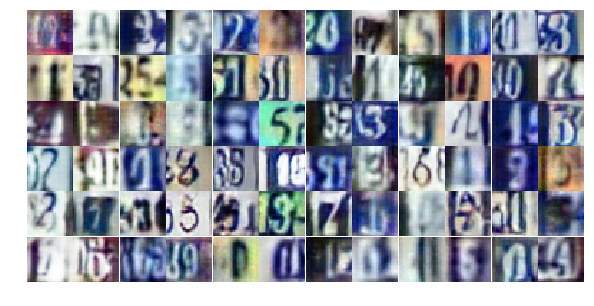

Epoch 20/25... Discriminator Loss: 0.6920... Generator Loss: 1.1461
Epoch 20/25... Discriminator Loss: 0.8741... Generator Loss: 0.7766
Epoch 20/25... Discriminator Loss: 0.9022... Generator Loss: 0.7341
Epoch 20/25... Discriminator Loss: 0.5482... Generator Loss: 1.9629
Epoch 20/25... Discriminator Loss: 0.7710... Generator Loss: 0.9863
Epoch 20/25... Discriminator Loss: 0.4568... Generator Loss: 2.2359
Epoch 20/25... Discriminator Loss: 0.9700... Generator Loss: 0.9303
Epoch 20/25... Discriminator Loss: 0.6031... Generator Loss: 1.1401
Epoch 20/25... Discriminator Loss: 0.7740... Generator Loss: 2.0561
Epoch 20/25... Discriminator Loss: 1.0185... Generator Loss: 0.6237


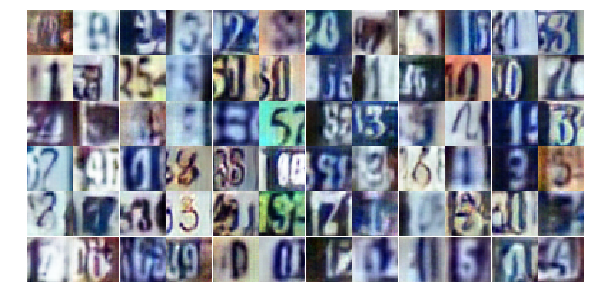

Epoch 20/25... Discriminator Loss: 1.1315... Generator Loss: 0.7364
Epoch 20/25... Discriminator Loss: 1.0395... Generator Loss: 0.5998
Epoch 20/25... Discriminator Loss: 0.5973... Generator Loss: 1.5961
Epoch 20/25... Discriminator Loss: 0.7435... Generator Loss: 1.0165
Epoch 20/25... Discriminator Loss: 0.6166... Generator Loss: 1.1744
Epoch 20/25... Discriminator Loss: 0.9573... Generator Loss: 0.6938
Epoch 20/25... Discriminator Loss: 1.4132... Generator Loss: 0.4525
Epoch 20/25... Discriminator Loss: 0.3989... Generator Loss: 1.7643
Epoch 20/25... Discriminator Loss: 0.5793... Generator Loss: 1.2577
Epoch 20/25... Discriminator Loss: 0.7122... Generator Loss: 1.0045


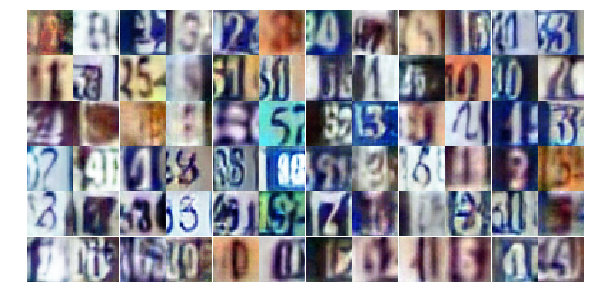

Epoch 20/25... Discriminator Loss: 0.5114... Generator Loss: 1.2116
Epoch 20/25... Discriminator Loss: 0.6125... Generator Loss: 1.1643
Epoch 20/25... Discriminator Loss: 0.5185... Generator Loss: 1.4426
Epoch 20/25... Discriminator Loss: 2.2916... Generator Loss: 0.2284
Epoch 20/25... Discriminator Loss: 0.8402... Generator Loss: 1.0239
Epoch 20/25... Discriminator Loss: 0.6327... Generator Loss: 1.0435
Epoch 21/25... Discriminator Loss: 0.6929... Generator Loss: 1.1151
Epoch 21/25... Discriminator Loss: 1.0752... Generator Loss: 0.5435
Epoch 21/25... Discriminator Loss: 1.4403... Generator Loss: 0.3672
Epoch 21/25... Discriminator Loss: 0.7565... Generator Loss: 0.9436


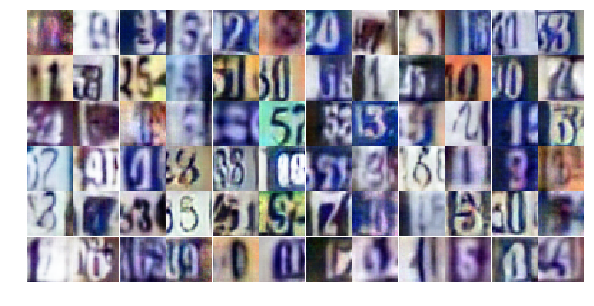

Epoch 21/25... Discriminator Loss: 0.6861... Generator Loss: 0.9680
Epoch 21/25... Discriminator Loss: 1.5905... Generator Loss: 0.2966
Epoch 21/25... Discriminator Loss: 0.4087... Generator Loss: 1.7218
Epoch 21/25... Discriminator Loss: 0.3987... Generator Loss: 1.4977
Epoch 21/25... Discriminator Loss: 0.7223... Generator Loss: 1.0151
Epoch 21/25... Discriminator Loss: 0.5818... Generator Loss: 1.1549
Epoch 21/25... Discriminator Loss: 1.1133... Generator Loss: 0.5941
Epoch 21/25... Discriminator Loss: 0.9628... Generator Loss: 0.6938
Epoch 21/25... Discriminator Loss: 0.7767... Generator Loss: 0.9094
Epoch 21/25... Discriminator Loss: 1.1468... Generator Loss: 0.5709


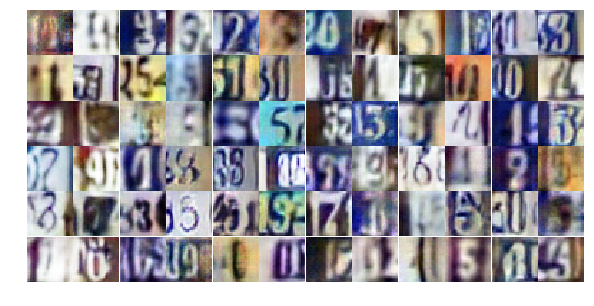

Epoch 21/25... Discriminator Loss: 0.3901... Generator Loss: 1.4744
Epoch 21/25... Discriminator Loss: 0.6779... Generator Loss: 0.9661
Epoch 21/25... Discriminator Loss: 1.7869... Generator Loss: 0.4020
Epoch 21/25... Discriminator Loss: 0.6473... Generator Loss: 1.1951
Epoch 21/25... Discriminator Loss: 0.8279... Generator Loss: 1.8946
Epoch 21/25... Discriminator Loss: 1.1010... Generator Loss: 0.5353
Epoch 21/25... Discriminator Loss: 0.8211... Generator Loss: 0.8213
Epoch 21/25... Discriminator Loss: 0.3724... Generator Loss: 2.3071
Epoch 21/25... Discriminator Loss: 0.4545... Generator Loss: 1.5541
Epoch 21/25... Discriminator Loss: 0.9146... Generator Loss: 0.6795


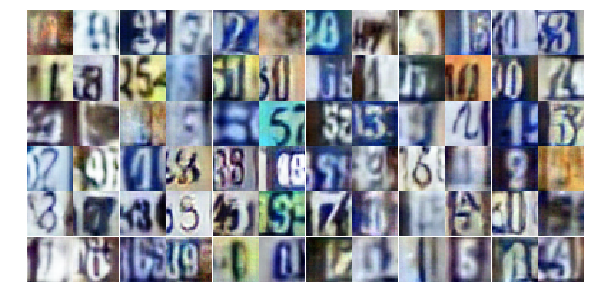

Epoch 21/25... Discriminator Loss: 0.7555... Generator Loss: 0.9703
Epoch 21/25... Discriminator Loss: 0.4357... Generator Loss: 1.4288
Epoch 21/25... Discriminator Loss: 1.2190... Generator Loss: 1.7801
Epoch 21/25... Discriminator Loss: 0.7546... Generator Loss: 1.0768
Epoch 21/25... Discriminator Loss: 0.7865... Generator Loss: 0.9522
Epoch 21/25... Discriminator Loss: 0.8797... Generator Loss: 0.8315
Epoch 21/25... Discriminator Loss: 0.6809... Generator Loss: 0.9556
Epoch 21/25... Discriminator Loss: 1.0041... Generator Loss: 0.6937
Epoch 21/25... Discriminator Loss: 1.3047... Generator Loss: 0.4870
Epoch 21/25... Discriminator Loss: 1.2094... Generator Loss: 0.5555


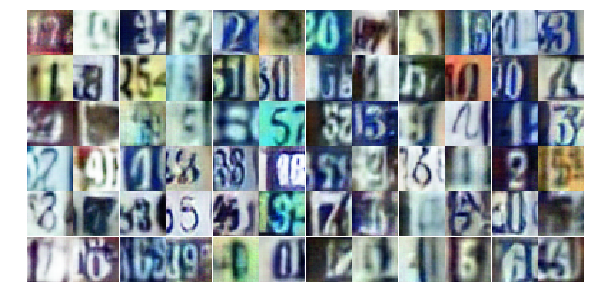

Epoch 21/25... Discriminator Loss: 1.4865... Generator Loss: 0.4173
Epoch 21/25... Discriminator Loss: 0.6706... Generator Loss: 1.0932
Epoch 21/25... Discriminator Loss: 1.1316... Generator Loss: 0.5877
Epoch 21/25... Discriminator Loss: 0.3947... Generator Loss: 1.6519
Epoch 21/25... Discriminator Loss: 0.5060... Generator Loss: 1.2521
Epoch 21/25... Discriminator Loss: 0.9218... Generator Loss: 0.7457
Epoch 21/25... Discriminator Loss: 0.8749... Generator Loss: 0.8068
Epoch 21/25... Discriminator Loss: 1.3622... Generator Loss: 0.4107
Epoch 21/25... Discriminator Loss: 1.1073... Generator Loss: 0.5355
Epoch 21/25... Discriminator Loss: 0.2804... Generator Loss: 2.5286


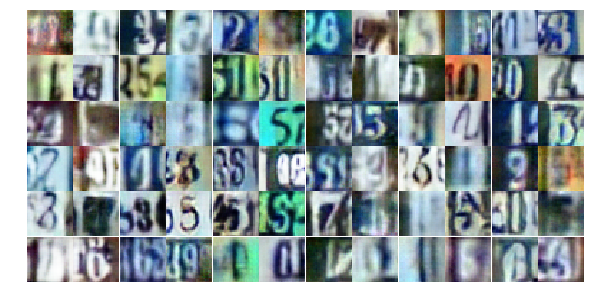

Epoch 21/25... Discriminator Loss: 0.6917... Generator Loss: 1.0718
Epoch 21/25... Discriminator Loss: 1.4146... Generator Loss: 0.4733
Epoch 21/25... Discriminator Loss: 0.5260... Generator Loss: 1.2211
Epoch 21/25... Discriminator Loss: 0.8268... Generator Loss: 0.8996
Epoch 21/25... Discriminator Loss: 0.3382... Generator Loss: 2.0692
Epoch 21/25... Discriminator Loss: 0.6258... Generator Loss: 1.1904
Epoch 21/25... Discriminator Loss: 0.7878... Generator Loss: 0.9797
Epoch 21/25... Discriminator Loss: 0.7907... Generator Loss: 1.4811
Epoch 21/25... Discriminator Loss: 1.1042... Generator Loss: 0.6273
Epoch 21/25... Discriminator Loss: 0.6037... Generator Loss: 1.1420


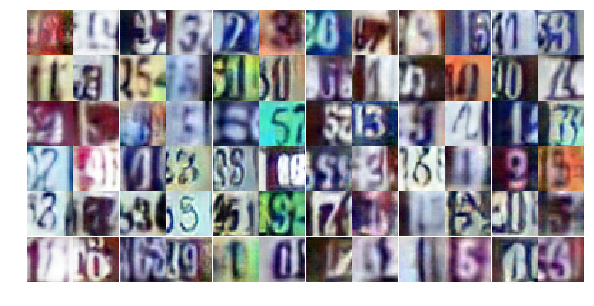

Epoch 21/25... Discriminator Loss: 0.4734... Generator Loss: 1.6885
Epoch 21/25... Discriminator Loss: 0.7672... Generator Loss: 2.2156
Epoch 21/25... Discriminator Loss: 0.7071... Generator Loss: 1.0998
Epoch 22/25... Discriminator Loss: 0.7388... Generator Loss: 1.0251
Epoch 22/25... Discriminator Loss: 0.7605... Generator Loss: 0.9296
Epoch 22/25... Discriminator Loss: 0.9725... Generator Loss: 0.6967
Epoch 22/25... Discriminator Loss: 0.6000... Generator Loss: 1.3548
Epoch 22/25... Discriminator Loss: 0.4622... Generator Loss: 1.3475
Epoch 22/25... Discriminator Loss: 0.7536... Generator Loss: 0.8950
Epoch 22/25... Discriminator Loss: 0.5606... Generator Loss: 1.6274


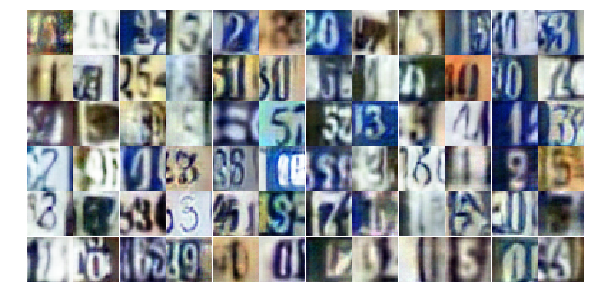

Epoch 22/25... Discriminator Loss: 0.7979... Generator Loss: 0.9564
Epoch 22/25... Discriminator Loss: 0.7662... Generator Loss: 0.9840
Epoch 22/25... Discriminator Loss: 1.5792... Generator Loss: 0.3574
Epoch 22/25... Discriminator Loss: 0.5867... Generator Loss: 1.1624
Epoch 22/25... Discriminator Loss: 1.0035... Generator Loss: 2.6951
Epoch 22/25... Discriminator Loss: 0.5497... Generator Loss: 1.3930
Epoch 22/25... Discriminator Loss: 0.6566... Generator Loss: 1.0612
Epoch 22/25... Discriminator Loss: 0.4883... Generator Loss: 1.5242
Epoch 22/25... Discriminator Loss: 1.0742... Generator Loss: 0.6618
Epoch 22/25... Discriminator Loss: 2.1902... Generator Loss: 0.1857


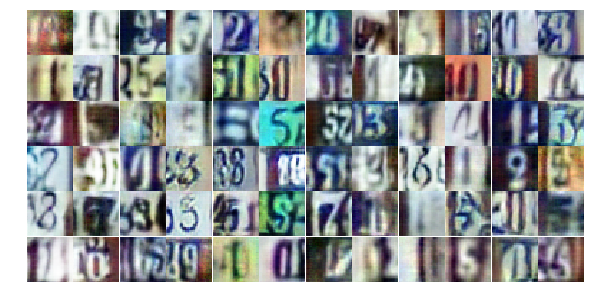

Epoch 22/25... Discriminator Loss: 0.6587... Generator Loss: 1.7159
Epoch 22/25... Discriminator Loss: 0.7848... Generator Loss: 0.9218
Epoch 22/25... Discriminator Loss: 0.9591... Generator Loss: 0.7247
Epoch 22/25... Discriminator Loss: 0.3964... Generator Loss: 1.6375
Epoch 22/25... Discriminator Loss: 0.5596... Generator Loss: 1.1596
Epoch 22/25... Discriminator Loss: 0.5664... Generator Loss: 1.1597
Epoch 22/25... Discriminator Loss: 0.3502... Generator Loss: 1.7033
Epoch 22/25... Discriminator Loss: 0.4001... Generator Loss: 1.6720
Epoch 22/25... Discriminator Loss: 0.7127... Generator Loss: 0.9203
Epoch 22/25... Discriminator Loss: 1.2690... Generator Loss: 0.5008


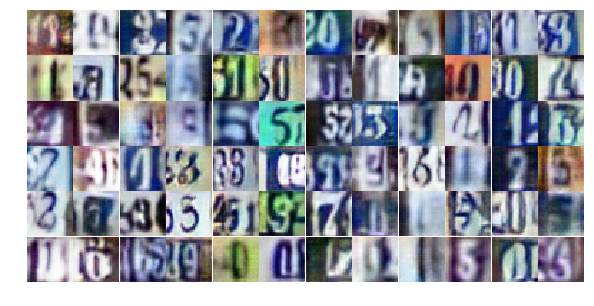

Epoch 22/25... Discriminator Loss: 0.5006... Generator Loss: 1.3423
Epoch 22/25... Discriminator Loss: 1.1093... Generator Loss: 3.0804
Epoch 22/25... Discriminator Loss: 0.7233... Generator Loss: 1.1885
Epoch 22/25... Discriminator Loss: 0.6708... Generator Loss: 0.9912
Epoch 22/25... Discriminator Loss: 0.8433... Generator Loss: 1.5366
Epoch 22/25... Discriminator Loss: 0.8729... Generator Loss: 0.8495
Epoch 22/25... Discriminator Loss: 1.3649... Generator Loss: 0.4324
Epoch 22/25... Discriminator Loss: 0.8427... Generator Loss: 0.8407
Epoch 22/25... Discriminator Loss: 1.0338... Generator Loss: 0.6604
Epoch 22/25... Discriminator Loss: 0.7072... Generator Loss: 1.2024


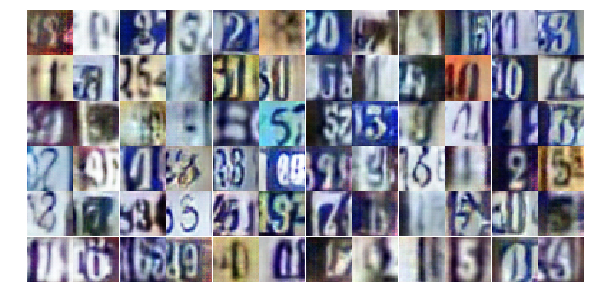

Epoch 22/25... Discriminator Loss: 0.8398... Generator Loss: 0.9870
Epoch 22/25... Discriminator Loss: 0.6546... Generator Loss: 1.0015
Epoch 22/25... Discriminator Loss: 0.3729... Generator Loss: 2.0732
Epoch 22/25... Discriminator Loss: 0.7215... Generator Loss: 1.2088
Epoch 22/25... Discriminator Loss: 0.6249... Generator Loss: 1.0080
Epoch 22/25... Discriminator Loss: 0.6234... Generator Loss: 1.0902
Epoch 22/25... Discriminator Loss: 0.7413... Generator Loss: 1.2982
Epoch 22/25... Discriminator Loss: 0.8624... Generator Loss: 1.0097
Epoch 22/25... Discriminator Loss: 0.9084... Generator Loss: 0.8987
Epoch 22/25... Discriminator Loss: 0.8071... Generator Loss: 0.8564


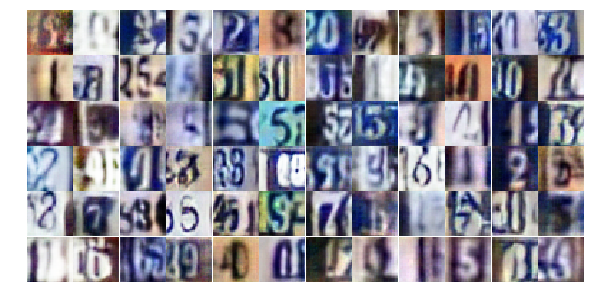

Epoch 22/25... Discriminator Loss: 1.2715... Generator Loss: 0.6266
Epoch 22/25... Discriminator Loss: 0.5070... Generator Loss: 1.4362
Epoch 22/25... Discriminator Loss: 0.7698... Generator Loss: 0.8639
Epoch 22/25... Discriminator Loss: 0.8454... Generator Loss: 0.9002
Epoch 22/25... Discriminator Loss: 0.8641... Generator Loss: 0.8363
Epoch 22/25... Discriminator Loss: 0.6458... Generator Loss: 1.0729
Epoch 22/25... Discriminator Loss: 0.8309... Generator Loss: 0.9030
Epoch 22/25... Discriminator Loss: 0.6757... Generator Loss: 0.9728
Epoch 22/25... Discriminator Loss: 0.8344... Generator Loss: 1.7469
Epoch 22/25... Discriminator Loss: 0.8750... Generator Loss: 0.8428


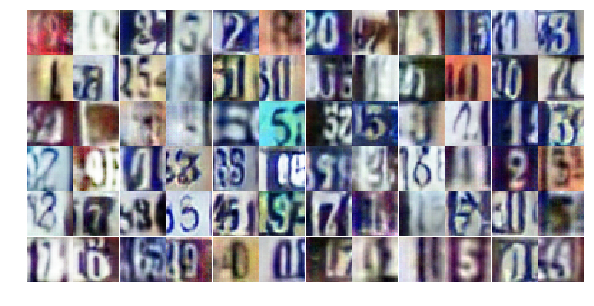

Epoch 23/25... Discriminator Loss: 0.5685... Generator Loss: 1.2553
Epoch 23/25... Discriminator Loss: 0.4176... Generator Loss: 1.6011
Epoch 23/25... Discriminator Loss: 1.1394... Generator Loss: 0.5739
Epoch 23/25... Discriminator Loss: 0.5596... Generator Loss: 1.1415
Epoch 23/25... Discriminator Loss: 0.6844... Generator Loss: 1.0924
Epoch 23/25... Discriminator Loss: 0.9727... Generator Loss: 0.6876
Epoch 23/25... Discriminator Loss: 0.8428... Generator Loss: 0.8655
Epoch 23/25... Discriminator Loss: 0.8654... Generator Loss: 0.7978
Epoch 23/25... Discriminator Loss: 0.9095... Generator Loss: 0.7413
Epoch 23/25... Discriminator Loss: 0.4062... Generator Loss: 1.5720


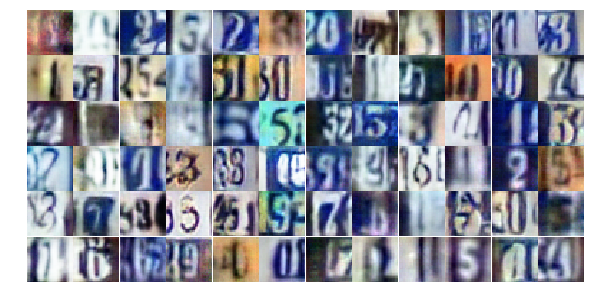

Epoch 23/25... Discriminator Loss: 0.5008... Generator Loss: 1.4930
Epoch 23/25... Discriminator Loss: 0.6655... Generator Loss: 0.9516
Epoch 23/25... Discriminator Loss: 0.6854... Generator Loss: 0.9565
Epoch 23/25... Discriminator Loss: 0.7368... Generator Loss: 1.5317
Epoch 23/25... Discriminator Loss: 0.4613... Generator Loss: 1.4338
Epoch 23/25... Discriminator Loss: 0.7053... Generator Loss: 1.1395
Epoch 23/25... Discriminator Loss: 0.6695... Generator Loss: 1.1517
Epoch 23/25... Discriminator Loss: 0.6842... Generator Loss: 1.1607
Epoch 23/25... Discriminator Loss: 0.7940... Generator Loss: 0.8731
Epoch 23/25... Discriminator Loss: 0.8351... Generator Loss: 0.8219


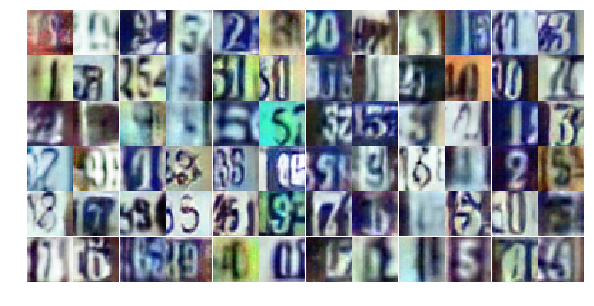

Epoch 23/25... Discriminator Loss: 1.2295... Generator Loss: 0.5763
Epoch 23/25... Discriminator Loss: 0.6819... Generator Loss: 1.2073
Epoch 23/25... Discriminator Loss: 1.2084... Generator Loss: 0.5227
Epoch 23/25... Discriminator Loss: 0.8859... Generator Loss: 0.8007
Epoch 23/25... Discriminator Loss: 0.5332... Generator Loss: 1.6074
Epoch 23/25... Discriminator Loss: 0.5600... Generator Loss: 1.1342
Epoch 23/25... Discriminator Loss: 0.6166... Generator Loss: 1.1290
Epoch 23/25... Discriminator Loss: 0.7188... Generator Loss: 1.1923
Epoch 23/25... Discriminator Loss: 0.8724... Generator Loss: 0.7454
Epoch 23/25... Discriminator Loss: 0.6705... Generator Loss: 1.8616


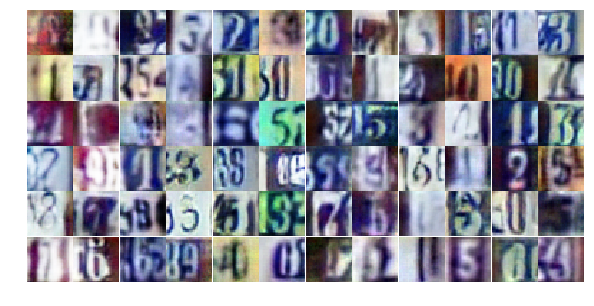

Epoch 23/25... Discriminator Loss: 0.4963... Generator Loss: 1.4807
Epoch 23/25... Discriminator Loss: 0.5545... Generator Loss: 1.2719
Epoch 23/25... Discriminator Loss: 0.6565... Generator Loss: 1.1338
Epoch 23/25... Discriminator Loss: 1.0354... Generator Loss: 0.6827
Epoch 23/25... Discriminator Loss: 0.9135... Generator Loss: 2.1557
Epoch 23/25... Discriminator Loss: 1.2161... Generator Loss: 0.6496
Epoch 23/25... Discriminator Loss: 1.3903... Generator Loss: 0.4612
Epoch 23/25... Discriminator Loss: 0.7761... Generator Loss: 0.9222
Epoch 23/25... Discriminator Loss: 0.3402... Generator Loss: 1.8159
Epoch 23/25... Discriminator Loss: 0.5747... Generator Loss: 1.1481


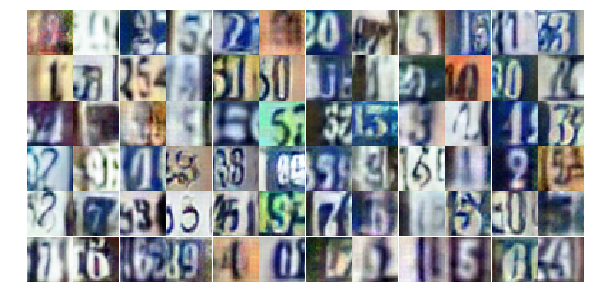

Epoch 23/25... Discriminator Loss: 0.9426... Generator Loss: 0.7657
Epoch 23/25... Discriminator Loss: 0.6200... Generator Loss: 1.2862
Epoch 23/25... Discriminator Loss: 1.1913... Generator Loss: 0.5476
Epoch 23/25... Discriminator Loss: 0.5886... Generator Loss: 1.2712
Epoch 23/25... Discriminator Loss: 0.9334... Generator Loss: 2.7499
Epoch 23/25... Discriminator Loss: 1.1505... Generator Loss: 0.5625
Epoch 23/25... Discriminator Loss: 0.6340... Generator Loss: 1.1135
Epoch 23/25... Discriminator Loss: 1.4069... Generator Loss: 0.4239
Epoch 23/25... Discriminator Loss: 0.5524... Generator Loss: 1.2941
Epoch 23/25... Discriminator Loss: 0.8684... Generator Loss: 0.8736


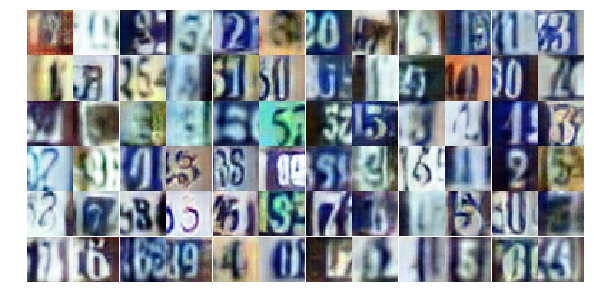

Epoch 23/25... Discriminator Loss: 0.5860... Generator Loss: 1.2553
Epoch 23/25... Discriminator Loss: 1.0230... Generator Loss: 0.7065
Epoch 23/25... Discriminator Loss: 0.5975... Generator Loss: 1.2561
Epoch 23/25... Discriminator Loss: 0.4130... Generator Loss: 2.3957
Epoch 23/25... Discriminator Loss: 1.4329... Generator Loss: 0.4184
Epoch 23/25... Discriminator Loss: 0.7698... Generator Loss: 0.9241
Epoch 23/25... Discriminator Loss: 0.9887... Generator Loss: 0.7017
Epoch 24/25... Discriminator Loss: 0.7501... Generator Loss: 0.9163
Epoch 24/25... Discriminator Loss: 0.8733... Generator Loss: 0.9336
Epoch 24/25... Discriminator Loss: 0.8564... Generator Loss: 0.8854


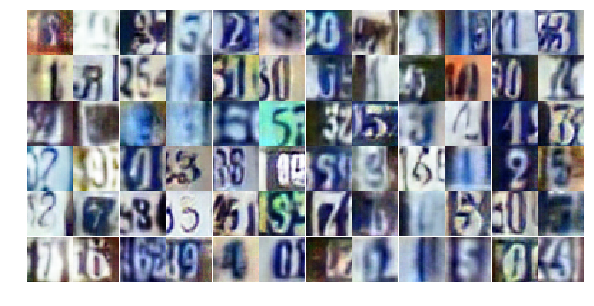

Epoch 24/25... Discriminator Loss: 0.5607... Generator Loss: 1.7806
Epoch 24/25... Discriminator Loss: 0.5237... Generator Loss: 1.3595
Epoch 24/25... Discriminator Loss: 0.6093... Generator Loss: 1.1278
Epoch 24/25... Discriminator Loss: 1.1058... Generator Loss: 2.6487
Epoch 24/25... Discriminator Loss: 1.1595... Generator Loss: 0.6037
Epoch 24/25... Discriminator Loss: 0.8071... Generator Loss: 0.8836
Epoch 24/25... Discriminator Loss: 0.8004... Generator Loss: 0.8835
Epoch 24/25... Discriminator Loss: 2.0518... Generator Loss: 0.2065
Epoch 24/25... Discriminator Loss: 0.4757... Generator Loss: 1.2491
Epoch 24/25... Discriminator Loss: 0.3930... Generator Loss: 1.5777


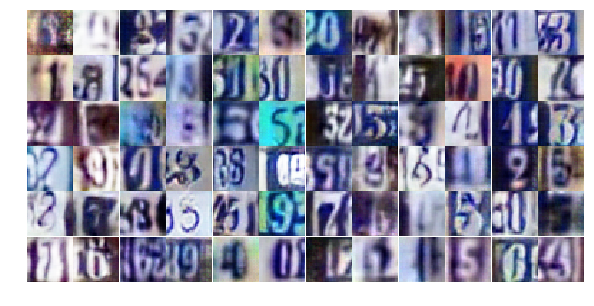

Epoch 24/25... Discriminator Loss: 1.6044... Generator Loss: 0.3392
Epoch 24/25... Discriminator Loss: 4.3969... Generator Loss: 0.0347
Epoch 24/25... Discriminator Loss: 2.3022... Generator Loss: 0.2906
Epoch 24/25... Discriminator Loss: 0.9135... Generator Loss: 0.7214
Epoch 24/25... Discriminator Loss: 0.6483... Generator Loss: 1.0236
Epoch 24/25... Discriminator Loss: 0.9854... Generator Loss: 0.7558
Epoch 24/25... Discriminator Loss: 0.5717... Generator Loss: 1.1595
Epoch 24/25... Discriminator Loss: 1.3564... Generator Loss: 0.4543
Epoch 24/25... Discriminator Loss: 0.7837... Generator Loss: 0.9607
Epoch 24/25... Discriminator Loss: 0.5945... Generator Loss: 1.4761


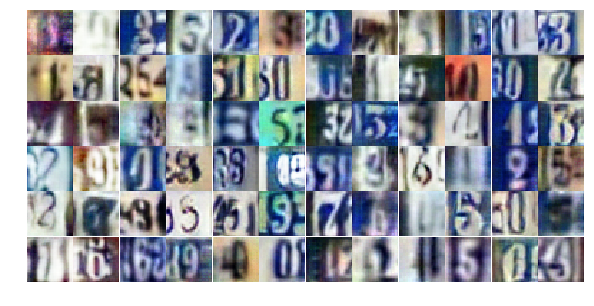

Epoch 24/25... Discriminator Loss: 1.0324... Generator Loss: 0.6009
Epoch 24/25... Discriminator Loss: 0.4136... Generator Loss: 1.5188
Epoch 24/25... Discriminator Loss: 0.6105... Generator Loss: 1.1310
Epoch 24/25... Discriminator Loss: 1.5160... Generator Loss: 0.3892
Epoch 24/25... Discriminator Loss: 0.6540... Generator Loss: 1.0037
Epoch 24/25... Discriminator Loss: 0.6356... Generator Loss: 1.1126
Epoch 24/25... Discriminator Loss: 0.6278... Generator Loss: 1.0437
Epoch 24/25... Discriminator Loss: 0.7079... Generator Loss: 0.9437
Epoch 24/25... Discriminator Loss: 0.6989... Generator Loss: 0.9968
Epoch 24/25... Discriminator Loss: 0.7365... Generator Loss: 0.9681


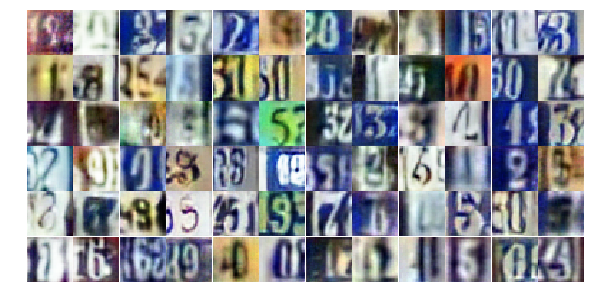

Epoch 24/25... Discriminator Loss: 0.6354... Generator Loss: 1.0217
Epoch 24/25... Discriminator Loss: 0.4537... Generator Loss: 1.4447
Epoch 24/25... Discriminator Loss: 1.0271... Generator Loss: 0.6343
Epoch 24/25... Discriminator Loss: 1.2628... Generator Loss: 0.5719
Epoch 24/25... Discriminator Loss: 0.7231... Generator Loss: 0.9628
Epoch 24/25... Discriminator Loss: 1.0968... Generator Loss: 0.5951
Epoch 24/25... Discriminator Loss: 0.8816... Generator Loss: 0.7869
Epoch 24/25... Discriminator Loss: 0.6649... Generator Loss: 1.0843
Epoch 24/25... Discriminator Loss: 0.6791... Generator Loss: 1.2182
Epoch 24/25... Discriminator Loss: 1.4294... Generator Loss: 4.2403


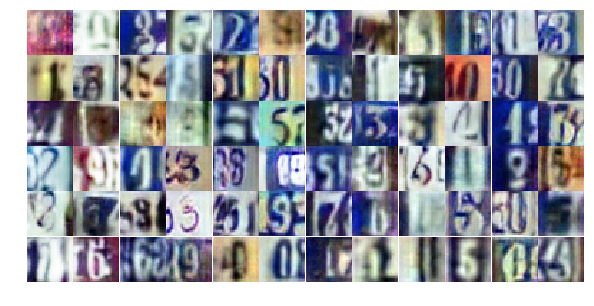

Epoch 24/25... Discriminator Loss: 0.7333... Generator Loss: 1.1570
Epoch 24/25... Discriminator Loss: 1.5558... Generator Loss: 0.6155
Epoch 24/25... Discriminator Loss: 1.6493... Generator Loss: 0.3563
Epoch 24/25... Discriminator Loss: 1.3710... Generator Loss: 0.4584
Epoch 24/25... Discriminator Loss: 1.1806... Generator Loss: 0.5226
Epoch 24/25... Discriminator Loss: 0.6251... Generator Loss: 1.1347
Epoch 24/25... Discriminator Loss: 0.8119... Generator Loss: 0.9491
Epoch 24/25... Discriminator Loss: 0.4783... Generator Loss: 1.3386
Epoch 24/25... Discriminator Loss: 0.7911... Generator Loss: 0.9788
Epoch 24/25... Discriminator Loss: 1.6292... Generator Loss: 3.1971


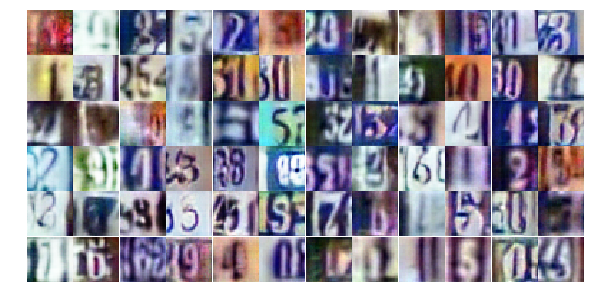

Epoch 24/25... Discriminator Loss: 0.8738... Generator Loss: 0.9140
Epoch 24/25... Discriminator Loss: 1.9585... Generator Loss: 0.2359
Epoch 24/25... Discriminator Loss: 0.9515... Generator Loss: 0.8082
Epoch 24/25... Discriminator Loss: 1.0324... Generator Loss: 0.6264
Epoch 24/25... Discriminator Loss: 1.1423... Generator Loss: 0.6044
Epoch 25/25... Discriminator Loss: 0.6115... Generator Loss: 1.2774
Epoch 25/25... Discriminator Loss: 0.5127... Generator Loss: 1.3574
Epoch 25/25... Discriminator Loss: 0.5484... Generator Loss: 1.3231
Epoch 25/25... Discriminator Loss: 1.2032... Generator Loss: 0.5141
Epoch 25/25... Discriminator Loss: 0.7595... Generator Loss: 0.9608


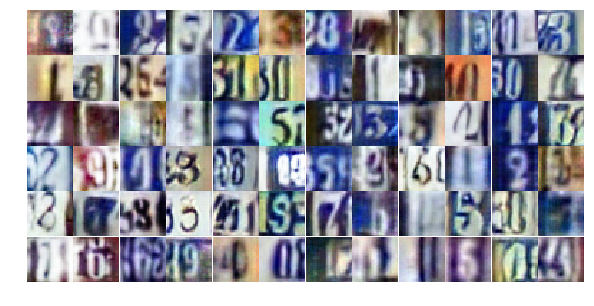

Epoch 25/25... Discriminator Loss: 0.9537... Generator Loss: 0.6974
Epoch 25/25... Discriminator Loss: 1.6271... Generator Loss: 0.3910
Epoch 25/25... Discriminator Loss: 0.7212... Generator Loss: 0.9444
Epoch 25/25... Discriminator Loss: 0.7484... Generator Loss: 0.8919
Epoch 25/25... Discriminator Loss: 0.7926... Generator Loss: 2.3714
Epoch 25/25... Discriminator Loss: 0.5866... Generator Loss: 1.3741
Epoch 25/25... Discriminator Loss: 0.9440... Generator Loss: 0.7455
Epoch 25/25... Discriminator Loss: 0.8105... Generator Loss: 0.9657
Epoch 25/25... Discriminator Loss: 0.5891... Generator Loss: 1.1373
Epoch 25/25... Discriminator Loss: 1.1267... Generator Loss: 0.5719


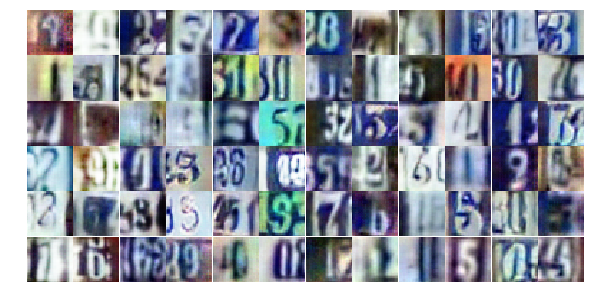

Epoch 25/25... Discriminator Loss: 0.6937... Generator Loss: 1.1178
Epoch 25/25... Discriminator Loss: 0.5278... Generator Loss: 2.5097
Epoch 25/25... Discriminator Loss: 1.0700... Generator Loss: 0.6419
Epoch 25/25... Discriminator Loss: 1.1877... Generator Loss: 0.6943
Epoch 25/25... Discriminator Loss: 0.7498... Generator Loss: 0.9945
Epoch 25/25... Discriminator Loss: 0.6128... Generator Loss: 1.1530
Epoch 25/25... Discriminator Loss: 0.6483... Generator Loss: 1.0378
Epoch 25/25... Discriminator Loss: 0.7475... Generator Loss: 0.9529
Epoch 25/25... Discriminator Loss: 0.4392... Generator Loss: 1.5228
Epoch 25/25... Discriminator Loss: 0.8182... Generator Loss: 0.8996


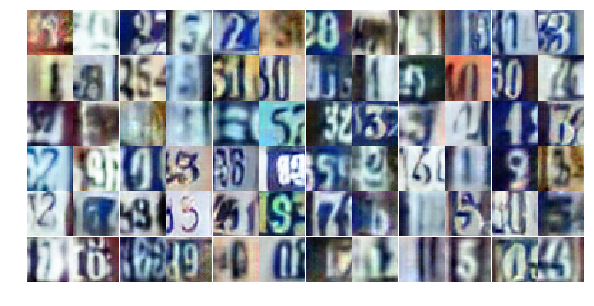

Epoch 25/25... Discriminator Loss: 0.6645... Generator Loss: 1.0179
Epoch 25/25... Discriminator Loss: 0.5807... Generator Loss: 1.1578
Epoch 25/25... Discriminator Loss: 0.9853... Generator Loss: 0.7484
Epoch 25/25... Discriminator Loss: 1.0496... Generator Loss: 0.6547
Epoch 25/25... Discriminator Loss: 1.0459... Generator Loss: 0.6806
Epoch 25/25... Discriminator Loss: 0.5539... Generator Loss: 1.2215
Epoch 25/25... Discriminator Loss: 1.1728... Generator Loss: 0.5487
Epoch 25/25... Discriminator Loss: 0.5988... Generator Loss: 1.2686
Epoch 25/25... Discriminator Loss: 0.7166... Generator Loss: 1.0872
Epoch 25/25... Discriminator Loss: 0.7332... Generator Loss: 0.9697


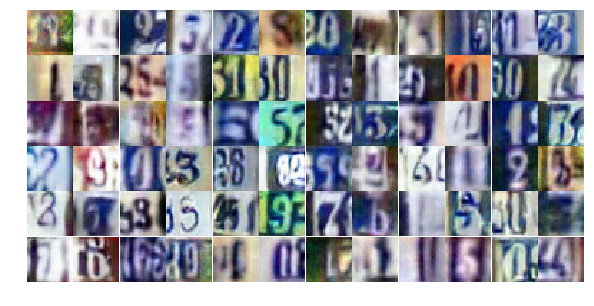

Epoch 25/25... Discriminator Loss: 0.6652... Generator Loss: 1.3061
Epoch 25/25... Discriminator Loss: 0.7601... Generator Loss: 0.9108
Epoch 25/25... Discriminator Loss: 0.6101... Generator Loss: 1.2498
Epoch 25/25... Discriminator Loss: 0.5424... Generator Loss: 1.2484
Epoch 25/25... Discriminator Loss: 1.4116... Generator Loss: 0.4572
Epoch 25/25... Discriminator Loss: 0.9410... Generator Loss: 0.7614
Epoch 25/25... Discriminator Loss: 0.5723... Generator Loss: 1.1246
Epoch 25/25... Discriminator Loss: 0.7716... Generator Loss: 0.9333
Epoch 25/25... Discriminator Loss: 2.5126... Generator Loss: 0.1669
Epoch 25/25... Discriminator Loss: 0.5946... Generator Loss: 1.5593


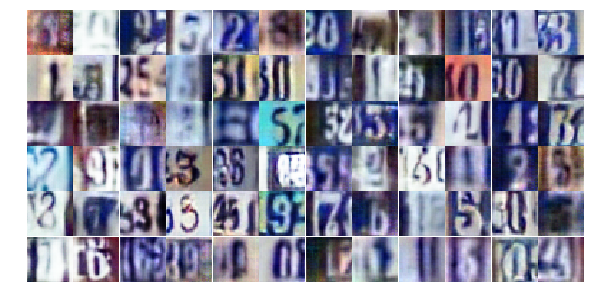

Epoch 25/25... Discriminator Loss: 4.9797... Generator Loss: 6.8522
Epoch 25/25... Discriminator Loss: 0.9607... Generator Loss: 1.0737
Epoch 25/25... Discriminator Loss: 0.7386... Generator Loss: 2.0693
Epoch 25/25... Discriminator Loss: 0.8614... Generator Loss: 0.8401
Epoch 25/25... Discriminator Loss: 0.8166... Generator Loss: 0.9086
Epoch 25/25... Discriminator Loss: 0.6340... Generator Loss: 1.0833
Epoch 25/25... Discriminator Loss: 0.8863... Generator Loss: 0.9900
Epoch 25/25... Discriminator Loss: 0.6619... Generator Loss: 1.1643
Epoch 25/25... Discriminator Loss: 0.7654... Generator Loss: 1.2165
Epoch 25/25... Discriminator Loss: 1.0732... Generator Loss: 0.7081


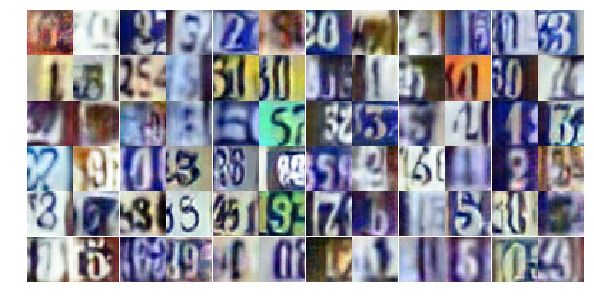

Epoch 25/25... Discriminator Loss: 0.5845... Generator Loss: 1.3929
Epoch 25/25... Discriminator Loss: 1.2537... Generator Loss: 0.5126


In [31]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

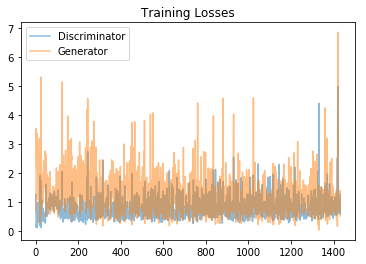

In [32]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

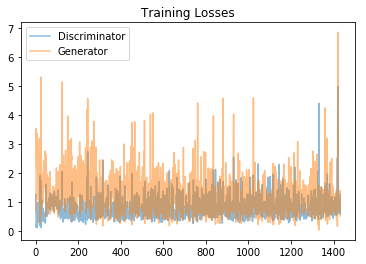

In [33]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

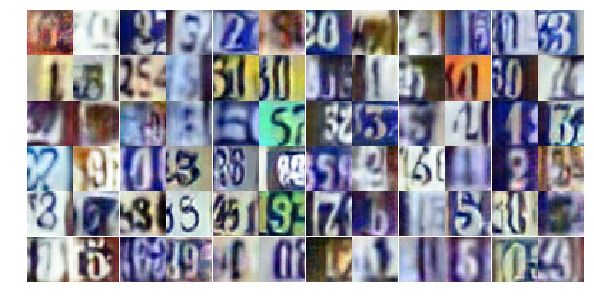

In [34]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

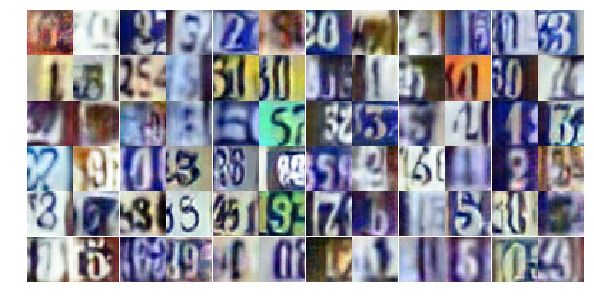

In [35]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))